# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

A subdirectory or file data already exists.


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

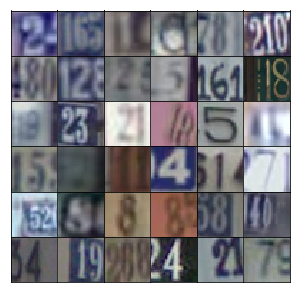

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU. 

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

In [22]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [23]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [24]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [25]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=0.2)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [26]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [27]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

In [28]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.8090... Generator Loss: 0.3779
Epoch 1/25... Discriminator Loss: 0.5192... Generator Loss: 1.4208
Epoch 1/25... Discriminator Loss: 0.1700... Generator Loss: 2.5418
Epoch 1/25... Discriminator Loss: 0.1539... Generator Loss: 2.7569
Epoch 1/25... Discriminator Loss: 0.1867... Generator Loss: 2.7660
Epoch 1/25... Discriminator Loss: 0.2240... Generator Loss: 2.1605
Epoch 1/25... Discriminator Loss: 0.1284... Generator Loss: 3.0122
Epoch 1/25... Discriminator Loss: 0.1680... Generator Loss: 3.7059
Epoch 1/25... Discriminator Loss: 0.0966... Generator Loss: 3.5459
Epoch 1/25... Discriminator Loss: 1.2108... Generator Loss: 1.8166


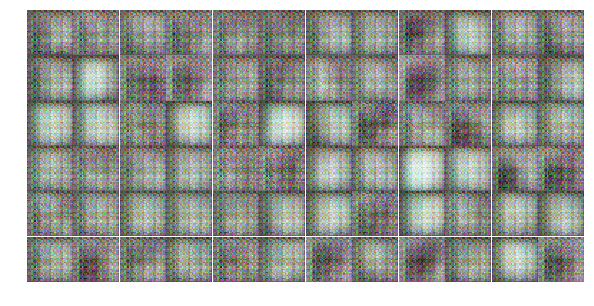

Epoch 1/25... Discriminator Loss: 0.8820... Generator Loss: 1.3426
Epoch 1/25... Discriminator Loss: 0.7083... Generator Loss: 1.9099
Epoch 1/25... Discriminator Loss: 0.4847... Generator Loss: 1.7992
Epoch 1/25... Discriminator Loss: 0.3156... Generator Loss: 2.4918
Epoch 1/25... Discriminator Loss: 0.6135... Generator Loss: 1.8092
Epoch 1/25... Discriminator Loss: 0.7062... Generator Loss: 1.3147
Epoch 1/25... Discriminator Loss: 0.2719... Generator Loss: 2.4096
Epoch 1/25... Discriminator Loss: 0.9763... Generator Loss: 0.8696
Epoch 1/25... Discriminator Loss: 0.7293... Generator Loss: 2.2176
Epoch 1/25... Discriminator Loss: 1.1860... Generator Loss: 1.3316


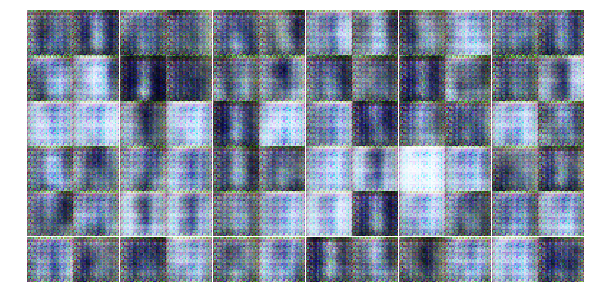

Epoch 1/25... Discriminator Loss: 0.3972... Generator Loss: 2.5332
Epoch 1/25... Discriminator Loss: 0.4714... Generator Loss: 1.8754
Epoch 1/25... Discriminator Loss: 1.2304... Generator Loss: 2.7288
Epoch 1/25... Discriminator Loss: 0.8888... Generator Loss: 1.2730
Epoch 1/25... Discriminator Loss: 1.0501... Generator Loss: 1.3805
Epoch 1/25... Discriminator Loss: 0.7615... Generator Loss: 1.2737
Epoch 1/25... Discriminator Loss: 1.1261... Generator Loss: 0.7752
Epoch 1/25... Discriminator Loss: 1.0046... Generator Loss: 1.0869
Epoch 1/25... Discriminator Loss: 1.0415... Generator Loss: 1.0863
Epoch 1/25... Discriminator Loss: 0.9092... Generator Loss: 1.1302


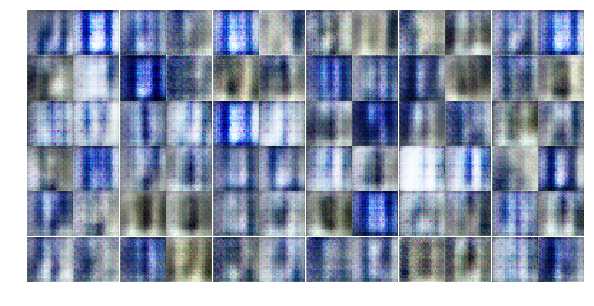

Epoch 1/25... Discriminator Loss: 0.6898... Generator Loss: 1.4078
Epoch 1/25... Discriminator Loss: 0.6502... Generator Loss: 1.3955
Epoch 1/25... Discriminator Loss: 0.3700... Generator Loss: 1.8060
Epoch 1/25... Discriminator Loss: 0.6927... Generator Loss: 1.1509
Epoch 1/25... Discriminator Loss: 0.5160... Generator Loss: 1.6935
Epoch 1/25... Discriminator Loss: 0.2529... Generator Loss: 2.2732
Epoch 1/25... Discriminator Loss: 0.3282... Generator Loss: 2.6680
Epoch 1/25... Discriminator Loss: 0.3675... Generator Loss: 2.7007
Epoch 1/25... Discriminator Loss: 0.2678... Generator Loss: 1.9263
Epoch 1/25... Discriminator Loss: 0.5066... Generator Loss: 1.9941


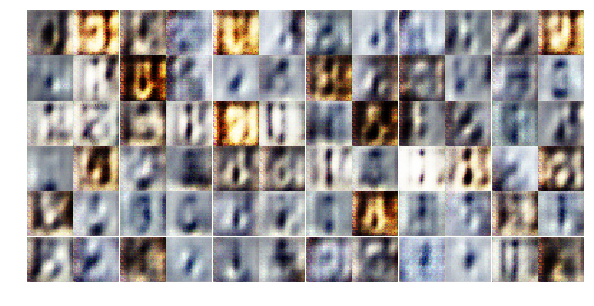

Epoch 1/25... Discriminator Loss: 0.3868... Generator Loss: 2.0771
Epoch 1/25... Discriminator Loss: 0.7506... Generator Loss: 2.4136
Epoch 1/25... Discriminator Loss: 1.0801... Generator Loss: 1.0039
Epoch 1/25... Discriminator Loss: 0.9247... Generator Loss: 1.7617
Epoch 1/25... Discriminator Loss: 1.3741... Generator Loss: 1.0010
Epoch 1/25... Discriminator Loss: 1.2216... Generator Loss: 0.7332
Epoch 1/25... Discriminator Loss: 0.9615... Generator Loss: 1.2398
Epoch 1/25... Discriminator Loss: 1.1098... Generator Loss: 0.8051
Epoch 1/25... Discriminator Loss: 1.1338... Generator Loss: 0.6992
Epoch 1/25... Discriminator Loss: 1.2480... Generator Loss: 0.7909


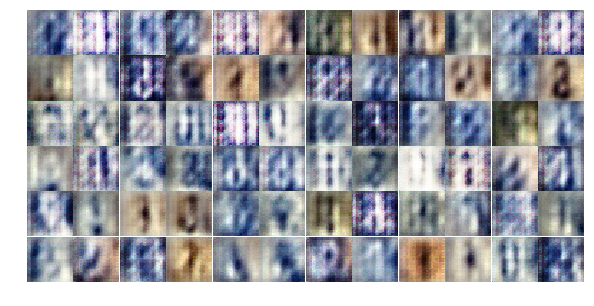

Epoch 1/25... Discriminator Loss: 1.0734... Generator Loss: 0.9728
Epoch 1/25... Discriminator Loss: 0.9289... Generator Loss: 1.2149
Epoch 1/25... Discriminator Loss: 0.8829... Generator Loss: 1.4826
Epoch 1/25... Discriminator Loss: 1.5955... Generator Loss: 0.3999
Epoch 1/25... Discriminator Loss: 0.7165... Generator Loss: 1.3306
Epoch 1/25... Discriminator Loss: 1.1649... Generator Loss: 0.5847
Epoch 1/25... Discriminator Loss: 0.9328... Generator Loss: 1.1633
Epoch 2/25... Discriminator Loss: 0.9691... Generator Loss: 1.1470
Epoch 2/25... Discriminator Loss: 0.8481... Generator Loss: 1.3192
Epoch 2/25... Discriminator Loss: 0.9359... Generator Loss: 1.1021


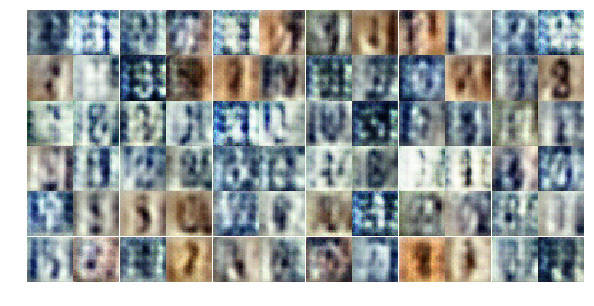

Epoch 2/25... Discriminator Loss: 1.3332... Generator Loss: 0.5175
Epoch 2/25... Discriminator Loss: 0.9077... Generator Loss: 1.0357
Epoch 2/25... Discriminator Loss: 0.8334... Generator Loss: 1.0941
Epoch 2/25... Discriminator Loss: 1.0546... Generator Loss: 1.0930
Epoch 2/25... Discriminator Loss: 0.9220... Generator Loss: 0.9359
Epoch 2/25... Discriminator Loss: 0.9569... Generator Loss: 1.1475
Epoch 2/25... Discriminator Loss: 1.0839... Generator Loss: 0.8343
Epoch 2/25... Discriminator Loss: 0.7461... Generator Loss: 1.2189
Epoch 2/25... Discriminator Loss: 0.9541... Generator Loss: 0.6911
Epoch 2/25... Discriminator Loss: 0.8842... Generator Loss: 1.0818


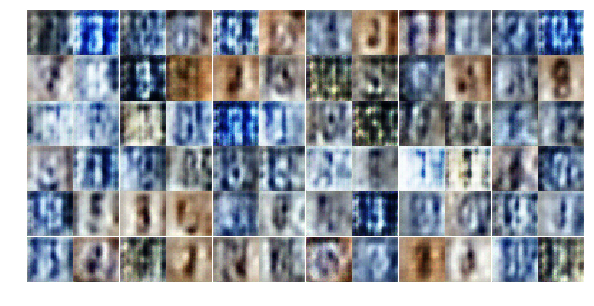

Epoch 2/25... Discriminator Loss: 1.2196... Generator Loss: 0.8972
Epoch 2/25... Discriminator Loss: 0.9044... Generator Loss: 0.9863
Epoch 2/25... Discriminator Loss: 0.6905... Generator Loss: 1.5934
Epoch 2/25... Discriminator Loss: 1.0913... Generator Loss: 0.6946
Epoch 2/25... Discriminator Loss: 1.5085... Generator Loss: 0.6624
Epoch 2/25... Discriminator Loss: 0.9985... Generator Loss: 0.9746
Epoch 2/25... Discriminator Loss: 1.0485... Generator Loss: 1.1519
Epoch 2/25... Discriminator Loss: 1.3468... Generator Loss: 0.6612
Epoch 2/25... Discriminator Loss: 1.1558... Generator Loss: 0.9350
Epoch 2/25... Discriminator Loss: 1.1786... Generator Loss: 0.7312


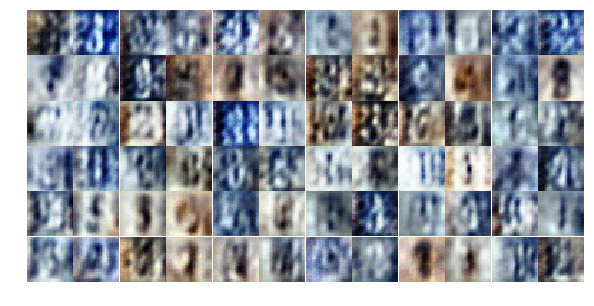

Epoch 2/25... Discriminator Loss: 1.3222... Generator Loss: 0.7444
Epoch 2/25... Discriminator Loss: 1.1275... Generator Loss: 0.8703
Epoch 2/25... Discriminator Loss: 1.0369... Generator Loss: 1.2360
Epoch 2/25... Discriminator Loss: 1.0405... Generator Loss: 1.0249
Epoch 2/25... Discriminator Loss: 1.0963... Generator Loss: 1.0646
Epoch 2/25... Discriminator Loss: 1.3049... Generator Loss: 0.6503
Epoch 2/25... Discriminator Loss: 1.2521... Generator Loss: 0.6191
Epoch 2/25... Discriminator Loss: 1.1101... Generator Loss: 0.8004
Epoch 2/25... Discriminator Loss: 1.0117... Generator Loss: 0.9108
Epoch 2/25... Discriminator Loss: 1.1106... Generator Loss: 0.8586


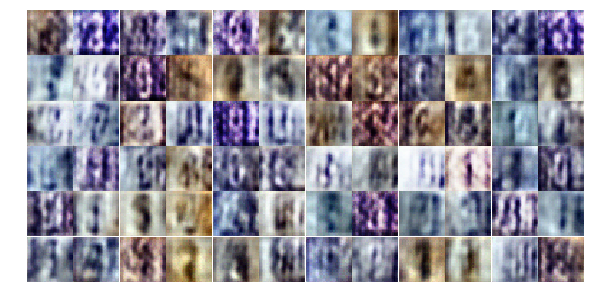

Epoch 2/25... Discriminator Loss: 0.8381... Generator Loss: 1.3392
Epoch 2/25... Discriminator Loss: 1.0324... Generator Loss: 1.0945
Epoch 2/25... Discriminator Loss: 1.1543... Generator Loss: 0.8188
Epoch 2/25... Discriminator Loss: 1.2174... Generator Loss: 0.6937
Epoch 2/25... Discriminator Loss: 0.8685... Generator Loss: 1.4350
Epoch 2/25... Discriminator Loss: 1.4613... Generator Loss: 0.7378
Epoch 2/25... Discriminator Loss: 1.3208... Generator Loss: 0.7669
Epoch 2/25... Discriminator Loss: 1.0473... Generator Loss: 1.2733
Epoch 2/25... Discriminator Loss: 1.0442... Generator Loss: 1.3695
Epoch 2/25... Discriminator Loss: 0.9377... Generator Loss: 1.0247


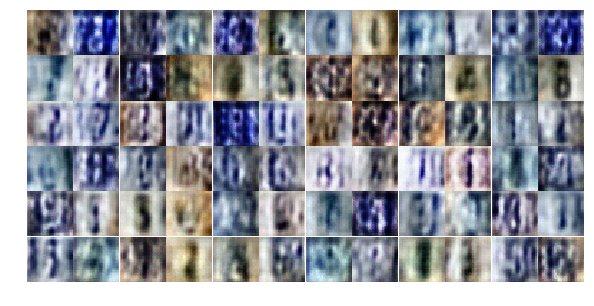

Epoch 2/25... Discriminator Loss: 0.9661... Generator Loss: 1.5246
Epoch 2/25... Discriminator Loss: 1.1231... Generator Loss: 1.0197
Epoch 2/25... Discriminator Loss: 0.8386... Generator Loss: 1.0335
Epoch 2/25... Discriminator Loss: 1.0860... Generator Loss: 1.0877
Epoch 2/25... Discriminator Loss: 0.8748... Generator Loss: 1.8905
Epoch 2/25... Discriminator Loss: 1.2896... Generator Loss: 0.5718
Epoch 2/25... Discriminator Loss: 1.3944... Generator Loss: 2.2728
Epoch 2/25... Discriminator Loss: 1.0559... Generator Loss: 0.7413
Epoch 2/25... Discriminator Loss: 0.8760... Generator Loss: 1.3374
Epoch 2/25... Discriminator Loss: 0.6455... Generator Loss: 1.3256


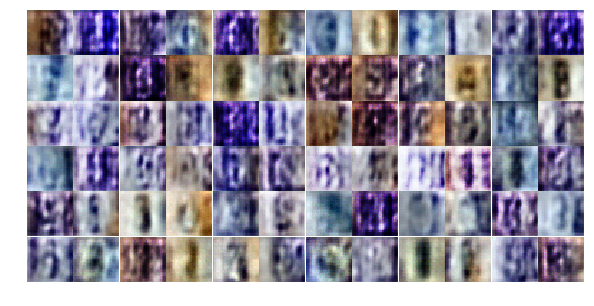

Epoch 2/25... Discriminator Loss: 0.6758... Generator Loss: 1.7131
Epoch 2/25... Discriminator Loss: 0.6935... Generator Loss: 1.1167
Epoch 2/25... Discriminator Loss: 0.9393... Generator Loss: 0.8510
Epoch 2/25... Discriminator Loss: 1.2247... Generator Loss: 1.1896
Epoch 3/25... Discriminator Loss: 0.8444... Generator Loss: 1.8904
Epoch 3/25... Discriminator Loss: 1.0357... Generator Loss: 0.8171
Epoch 3/25... Discriminator Loss: 1.0692... Generator Loss: 0.7254
Epoch 3/25... Discriminator Loss: 0.6319... Generator Loss: 1.2582
Epoch 3/25... Discriminator Loss: 0.6622... Generator Loss: 1.6669
Epoch 3/25... Discriminator Loss: 1.1396... Generator Loss: 0.7461


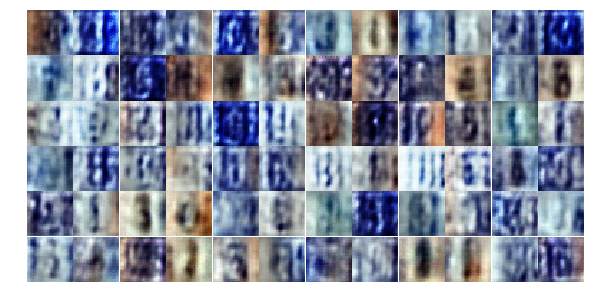

Epoch 3/25... Discriminator Loss: 1.0521... Generator Loss: 1.0619
Epoch 3/25... Discriminator Loss: 0.6448... Generator Loss: 1.6656
Epoch 3/25... Discriminator Loss: 0.7374... Generator Loss: 1.1539
Epoch 3/25... Discriminator Loss: 0.6016... Generator Loss: 1.9729
Epoch 3/25... Discriminator Loss: 1.2878... Generator Loss: 0.4588
Epoch 3/25... Discriminator Loss: 0.8874... Generator Loss: 2.0559
Epoch 3/25... Discriminator Loss: 0.8861... Generator Loss: 1.6059
Epoch 3/25... Discriminator Loss: 0.4974... Generator Loss: 1.5841
Epoch 3/25... Discriminator Loss: 0.4765... Generator Loss: 1.6660
Epoch 3/25... Discriminator Loss: 0.6816... Generator Loss: 1.1655


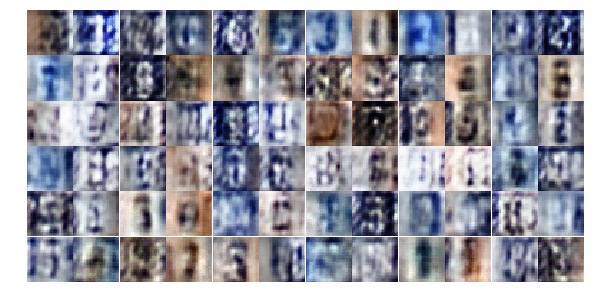

Epoch 3/25... Discriminator Loss: 1.2868... Generator Loss: 0.4806
Epoch 3/25... Discriminator Loss: 0.4934... Generator Loss: 1.4874
Epoch 3/25... Discriminator Loss: 0.8190... Generator Loss: 1.6443
Epoch 3/25... Discriminator Loss: 0.7017... Generator Loss: 2.6105
Epoch 3/25... Discriminator Loss: 0.4188... Generator Loss: 2.6651
Epoch 3/25... Discriminator Loss: 0.7373... Generator Loss: 0.9198
Epoch 3/25... Discriminator Loss: 0.8963... Generator Loss: 0.6767
Epoch 3/25... Discriminator Loss: 1.0210... Generator Loss: 0.6509
Epoch 3/25... Discriminator Loss: 0.8131... Generator Loss: 1.0577
Epoch 3/25... Discriminator Loss: 0.7220... Generator Loss: 1.1176


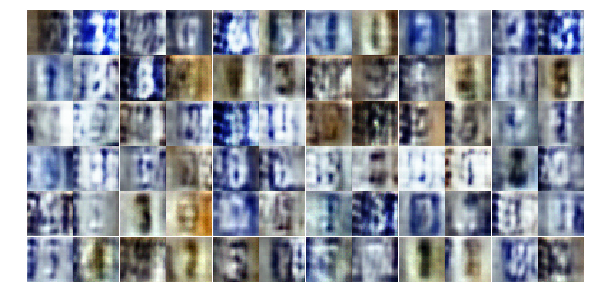

Epoch 3/25... Discriminator Loss: 1.0086... Generator Loss: 1.4026
Epoch 3/25... Discriminator Loss: 0.6030... Generator Loss: 1.4654
Epoch 3/25... Discriminator Loss: 0.6833... Generator Loss: 0.9890
Epoch 3/25... Discriminator Loss: 0.5900... Generator Loss: 2.6186
Epoch 3/25... Discriminator Loss: 0.5554... Generator Loss: 3.8113
Epoch 3/25... Discriminator Loss: 0.5401... Generator Loss: 2.1711
Epoch 3/25... Discriminator Loss: 0.7099... Generator Loss: 1.1786
Epoch 3/25... Discriminator Loss: 1.0613... Generator Loss: 0.6128
Epoch 3/25... Discriminator Loss: 0.3752... Generator Loss: 2.6681
Epoch 3/25... Discriminator Loss: 0.3999... Generator Loss: 1.5837


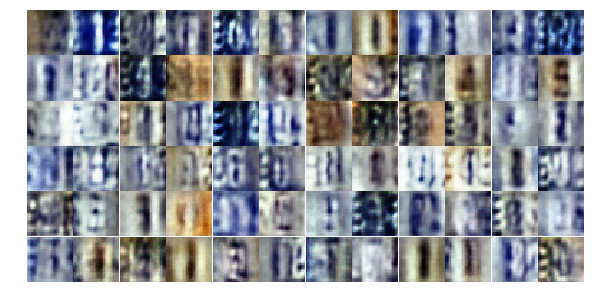

Epoch 3/25... Discriminator Loss: 0.3980... Generator Loss: 2.1203
Epoch 3/25... Discriminator Loss: 0.3868... Generator Loss: 1.6136
Epoch 3/25... Discriminator Loss: 0.5473... Generator Loss: 1.9985
Epoch 3/25... Discriminator Loss: 1.1191... Generator Loss: 2.1438
Epoch 3/25... Discriminator Loss: 0.3990... Generator Loss: 1.8923
Epoch 3/25... Discriminator Loss: 1.0960... Generator Loss: 0.6084
Epoch 3/25... Discriminator Loss: 0.8748... Generator Loss: 0.8526
Epoch 3/25... Discriminator Loss: 0.4485... Generator Loss: 1.6930
Epoch 3/25... Discriminator Loss: 0.8615... Generator Loss: 2.2285
Epoch 3/25... Discriminator Loss: 0.9954... Generator Loss: 0.9716


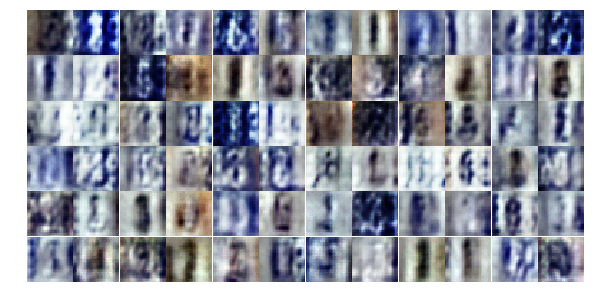

Epoch 3/25... Discriminator Loss: 0.9785... Generator Loss: 0.7255
Epoch 3/25... Discriminator Loss: 0.5534... Generator Loss: 1.4633
Epoch 3/25... Discriminator Loss: 0.7521... Generator Loss: 0.9201
Epoch 3/25... Discriminator Loss: 0.5509... Generator Loss: 1.6175
Epoch 3/25... Discriminator Loss: 0.4392... Generator Loss: 3.2348
Epoch 3/25... Discriminator Loss: 0.4413... Generator Loss: 2.0927
Epoch 3/25... Discriminator Loss: 0.7186... Generator Loss: 1.0528
Epoch 3/25... Discriminator Loss: 0.6417... Generator Loss: 1.5419
Epoch 3/25... Discriminator Loss: 0.6697... Generator Loss: 1.2548
Epoch 3/25... Discriminator Loss: 0.4236... Generator Loss: 2.2334


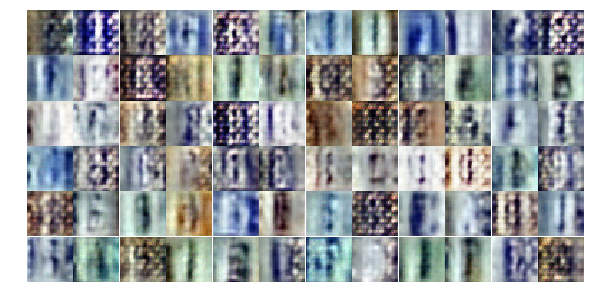

Epoch 3/25... Discriminator Loss: 0.5345... Generator Loss: 1.8072
Epoch 4/25... Discriminator Loss: 1.0156... Generator Loss: 0.7257
Epoch 4/25... Discriminator Loss: 0.6928... Generator Loss: 1.0968
Epoch 4/25... Discriminator Loss: 0.6602... Generator Loss: 1.0018
Epoch 4/25... Discriminator Loss: 0.6026... Generator Loss: 2.0492
Epoch 4/25... Discriminator Loss: 0.5248... Generator Loss: 2.1070
Epoch 4/25... Discriminator Loss: 0.7323... Generator Loss: 2.9220
Epoch 4/25... Discriminator Loss: 1.0259... Generator Loss: 0.8723
Epoch 4/25... Discriminator Loss: 1.4091... Generator Loss: 2.4485
Epoch 4/25... Discriminator Loss: 0.8114... Generator Loss: 0.8926


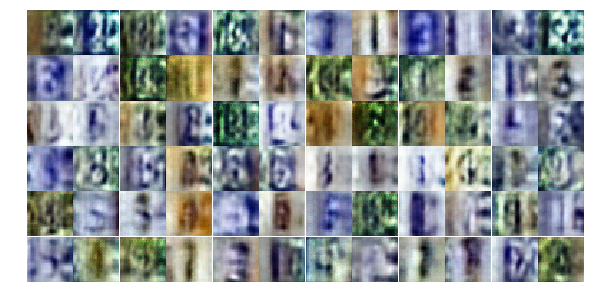

Epoch 4/25... Discriminator Loss: 0.4892... Generator Loss: 1.8502
Epoch 4/25... Discriminator Loss: 0.4082... Generator Loss: 2.6180
Epoch 4/25... Discriminator Loss: 0.8094... Generator Loss: 2.6436
Epoch 4/25... Discriminator Loss: 1.0280... Generator Loss: 0.6284
Epoch 4/25... Discriminator Loss: 0.5676... Generator Loss: 1.9376
Epoch 4/25... Discriminator Loss: 1.1811... Generator Loss: 0.8870
Epoch 4/25... Discriminator Loss: 1.7062... Generator Loss: 0.3691
Epoch 4/25... Discriminator Loss: 1.1100... Generator Loss: 0.7449
Epoch 4/25... Discriminator Loss: 1.4018... Generator Loss: 0.4579
Epoch 4/25... Discriminator Loss: 0.9346... Generator Loss: 1.6162


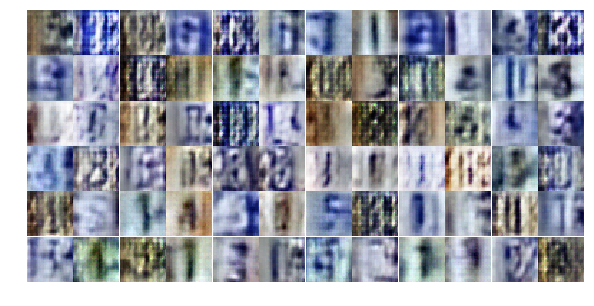

Epoch 4/25... Discriminator Loss: 0.4309... Generator Loss: 1.7942
Epoch 4/25... Discriminator Loss: 0.5151... Generator Loss: 1.8280
Epoch 4/25... Discriminator Loss: 1.4311... Generator Loss: 0.3874
Epoch 4/25... Discriminator Loss: 0.8708... Generator Loss: 0.8683
Epoch 4/25... Discriminator Loss: 0.6738... Generator Loss: 1.7372
Epoch 4/25... Discriminator Loss: 0.6193... Generator Loss: 1.7886
Epoch 4/25... Discriminator Loss: 0.5423... Generator Loss: 1.5477
Epoch 4/25... Discriminator Loss: 0.7374... Generator Loss: 0.9353
Epoch 4/25... Discriminator Loss: 0.4261... Generator Loss: 1.7259
Epoch 4/25... Discriminator Loss: 0.7049... Generator Loss: 0.9880


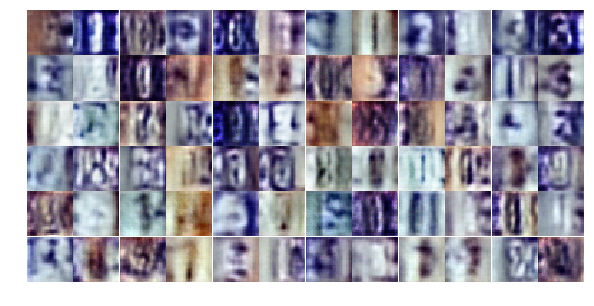

Epoch 4/25... Discriminator Loss: 0.4308... Generator Loss: 1.6613
Epoch 4/25... Discriminator Loss: 0.6544... Generator Loss: 1.4035
Epoch 4/25... Discriminator Loss: 1.0696... Generator Loss: 0.6246
Epoch 4/25... Discriminator Loss: 1.0408... Generator Loss: 1.1202
Epoch 4/25... Discriminator Loss: 0.5819... Generator Loss: 1.9463
Epoch 4/25... Discriminator Loss: 0.3311... Generator Loss: 2.0661
Epoch 4/25... Discriminator Loss: 0.4310... Generator Loss: 2.7003
Epoch 4/25... Discriminator Loss: 0.4253... Generator Loss: 1.9815
Epoch 4/25... Discriminator Loss: 0.4357... Generator Loss: 1.7659
Epoch 4/25... Discriminator Loss: 0.4056... Generator Loss: 1.6013


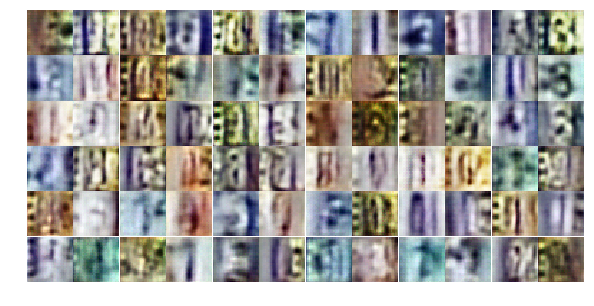

Epoch 4/25... Discriminator Loss: 0.7435... Generator Loss: 1.9481
Epoch 4/25... Discriminator Loss: 0.3133... Generator Loss: 2.4150
Epoch 4/25... Discriminator Loss: 0.5301... Generator Loss: 1.8901
Epoch 4/25... Discriminator Loss: 0.4666... Generator Loss: 1.6918
Epoch 4/25... Discriminator Loss: 0.5236... Generator Loss: 1.3019
Epoch 4/25... Discriminator Loss: 0.6520... Generator Loss: 2.0209
Epoch 4/25... Discriminator Loss: 0.9095... Generator Loss: 1.2769
Epoch 4/25... Discriminator Loss: 0.5333... Generator Loss: 1.3842
Epoch 4/25... Discriminator Loss: 0.5346... Generator Loss: 1.2480
Epoch 4/25... Discriminator Loss: 0.6218... Generator Loss: 1.4554


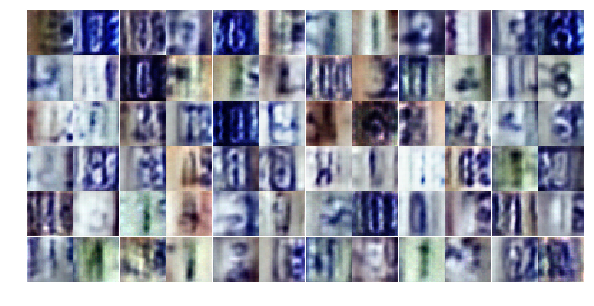

Epoch 4/25... Discriminator Loss: 0.4976... Generator Loss: 1.3436
Epoch 4/25... Discriminator Loss: 0.7136... Generator Loss: 1.1667
Epoch 4/25... Discriminator Loss: 1.1061... Generator Loss: 2.4821
Epoch 4/25... Discriminator Loss: 0.4950... Generator Loss: 2.1477
Epoch 4/25... Discriminator Loss: 0.8809... Generator Loss: 0.8750
Epoch 4/25... Discriminator Loss: 0.8247... Generator Loss: 0.8579
Epoch 4/25... Discriminator Loss: 0.9008... Generator Loss: 0.7446
Epoch 4/25... Discriminator Loss: 0.5393... Generator Loss: 1.2213
Epoch 4/25... Discriminator Loss: 0.4939... Generator Loss: 1.9497
Epoch 5/25... Discriminator Loss: 0.4865... Generator Loss: 1.3129


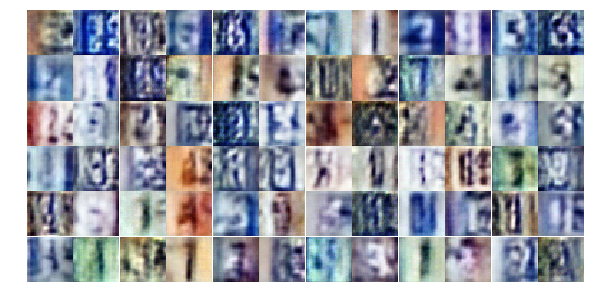

Epoch 5/25... Discriminator Loss: 0.4345... Generator Loss: 1.5208
Epoch 5/25... Discriminator Loss: 0.7923... Generator Loss: 0.8568
Epoch 5/25... Discriminator Loss: 0.5641... Generator Loss: 1.3457
Epoch 5/25... Discriminator Loss: 0.5447... Generator Loss: 1.2762
Epoch 5/25... Discriminator Loss: 0.5289... Generator Loss: 1.9192
Epoch 5/25... Discriminator Loss: 0.7181... Generator Loss: 0.9930
Epoch 5/25... Discriminator Loss: 0.6259... Generator Loss: 1.3197
Epoch 5/25... Discriminator Loss: 0.4573... Generator Loss: 1.5206
Epoch 5/25... Discriminator Loss: 0.7387... Generator Loss: 0.9144
Epoch 5/25... Discriminator Loss: 0.6345... Generator Loss: 1.0865


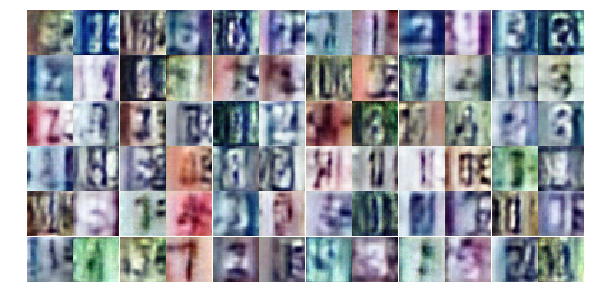

Epoch 5/25... Discriminator Loss: 0.4095... Generator Loss: 1.6440
Epoch 5/25... Discriminator Loss: 0.4088... Generator Loss: 1.7398
Epoch 5/25... Discriminator Loss: 0.4786... Generator Loss: 1.4108
Epoch 5/25... Discriminator Loss: 1.5916... Generator Loss: 0.3834
Epoch 5/25... Discriminator Loss: 0.5747... Generator Loss: 1.4457
Epoch 5/25... Discriminator Loss: 0.8447... Generator Loss: 1.0219
Epoch 5/25... Discriminator Loss: 0.4829... Generator Loss: 1.5388
Epoch 5/25... Discriminator Loss: 0.3913... Generator Loss: 2.1995
Epoch 5/25... Discriminator Loss: 0.3518... Generator Loss: 2.0216
Epoch 5/25... Discriminator Loss: 0.4698... Generator Loss: 1.7944


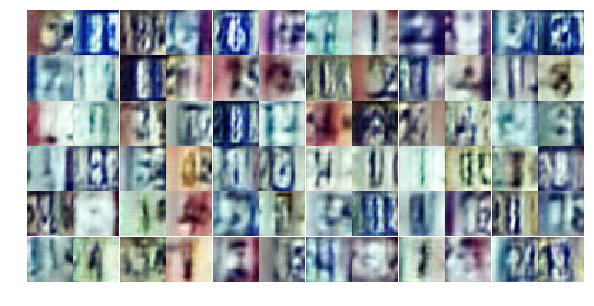

Epoch 5/25... Discriminator Loss: 0.4306... Generator Loss: 1.5630
Epoch 5/25... Discriminator Loss: 0.6130... Generator Loss: 2.3730
Epoch 5/25... Discriminator Loss: 0.6560... Generator Loss: 1.0374
Epoch 5/25... Discriminator Loss: 0.4408... Generator Loss: 1.7596
Epoch 5/25... Discriminator Loss: 1.6144... Generator Loss: 0.3327
Epoch 5/25... Discriminator Loss: 0.6640... Generator Loss: 1.1158
Epoch 5/25... Discriminator Loss: 0.6089... Generator Loss: 1.3152
Epoch 5/25... Discriminator Loss: 0.4735... Generator Loss: 1.6951
Epoch 5/25... Discriminator Loss: 1.1341... Generator Loss: 0.5214
Epoch 5/25... Discriminator Loss: 0.3766... Generator Loss: 1.7684


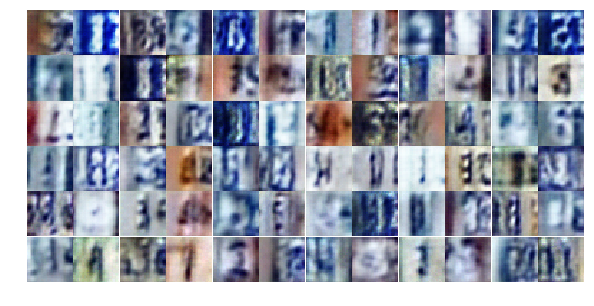

Epoch 5/25... Discriminator Loss: 0.5794... Generator Loss: 1.2966
Epoch 5/25... Discriminator Loss: 0.4337... Generator Loss: 1.5668
Epoch 5/25... Discriminator Loss: 0.5731... Generator Loss: 1.2246
Epoch 5/25... Discriminator Loss: 0.3704... Generator Loss: 2.2906
Epoch 5/25... Discriminator Loss: 0.7571... Generator Loss: 2.1366
Epoch 5/25... Discriminator Loss: 1.1477... Generator Loss: 3.4326
Epoch 5/25... Discriminator Loss: 1.1981... Generator Loss: 0.5947
Epoch 5/25... Discriminator Loss: 0.4597... Generator Loss: 1.3999
Epoch 5/25... Discriminator Loss: 0.9765... Generator Loss: 0.6114
Epoch 5/25... Discriminator Loss: 0.6155... Generator Loss: 1.0628


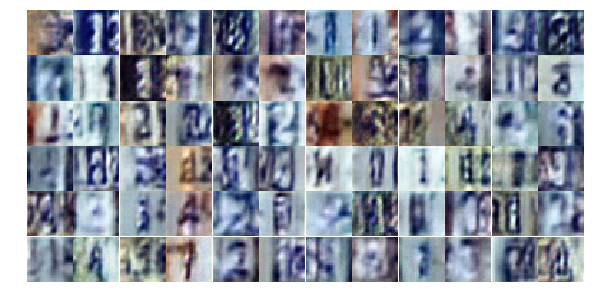

Epoch 5/25... Discriminator Loss: 0.3225... Generator Loss: 2.3943
Epoch 5/25... Discriminator Loss: 0.6395... Generator Loss: 1.2022
Epoch 5/25... Discriminator Loss: 1.0538... Generator Loss: 0.5867
Epoch 5/25... Discriminator Loss: 1.2758... Generator Loss: 0.6523
Epoch 5/25... Discriminator Loss: 1.4865... Generator Loss: 0.4034
Epoch 5/25... Discriminator Loss: 0.7888... Generator Loss: 1.4142
Epoch 5/25... Discriminator Loss: 0.7563... Generator Loss: 1.0760
Epoch 5/25... Discriminator Loss: 0.3969... Generator Loss: 1.9183
Epoch 5/25... Discriminator Loss: 0.6167... Generator Loss: 1.1580
Epoch 5/25... Discriminator Loss: 0.5463... Generator Loss: 1.4611


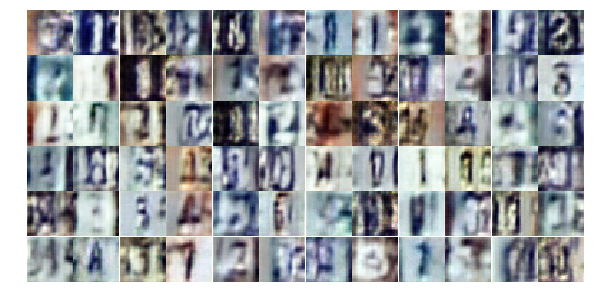

Epoch 5/25... Discriminator Loss: 1.0808... Generator Loss: 0.7864
Epoch 5/25... Discriminator Loss: 0.6664... Generator Loss: 1.0168
Epoch 5/25... Discriminator Loss: 0.7163... Generator Loss: 0.8977
Epoch 5/25... Discriminator Loss: 0.7077... Generator Loss: 1.0333
Epoch 5/25... Discriminator Loss: 0.6198... Generator Loss: 1.2695
Epoch 5/25... Discriminator Loss: 0.7102... Generator Loss: 1.2702
Epoch 6/25... Discriminator Loss: 0.6497... Generator Loss: 1.0454
Epoch 6/25... Discriminator Loss: 0.5596... Generator Loss: 1.4244
Epoch 6/25... Discriminator Loss: 1.3726... Generator Loss: 0.3938
Epoch 6/25... Discriminator Loss: 1.1040... Generator Loss: 0.5693


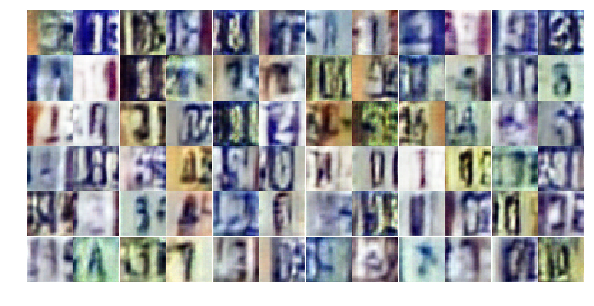

Epoch 6/25... Discriminator Loss: 0.5364... Generator Loss: 1.3284
Epoch 6/25... Discriminator Loss: 0.7536... Generator Loss: 1.0435
Epoch 6/25... Discriminator Loss: 0.8385... Generator Loss: 1.7992
Epoch 6/25... Discriminator Loss: 0.7676... Generator Loss: 1.0001
Epoch 6/25... Discriminator Loss: 0.9462... Generator Loss: 0.6865
Epoch 6/25... Discriminator Loss: 0.8769... Generator Loss: 0.7164
Epoch 6/25... Discriminator Loss: 0.5445... Generator Loss: 1.5569
Epoch 6/25... Discriminator Loss: 1.0154... Generator Loss: 0.7041
Epoch 6/25... Discriminator Loss: 0.7145... Generator Loss: 0.8644
Epoch 6/25... Discriminator Loss: 0.5310... Generator Loss: 1.5844


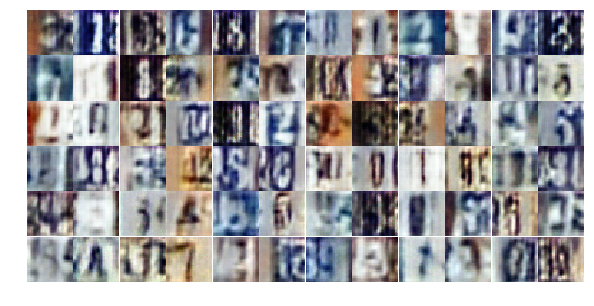

Epoch 6/25... Discriminator Loss: 0.6671... Generator Loss: 1.0188
Epoch 6/25... Discriminator Loss: 0.8818... Generator Loss: 0.7627
Epoch 6/25... Discriminator Loss: 1.3854... Generator Loss: 0.3860
Epoch 6/25... Discriminator Loss: 0.4302... Generator Loss: 1.7158
Epoch 6/25... Discriminator Loss: 0.5644... Generator Loss: 2.1171
Epoch 6/25... Discriminator Loss: 0.5412... Generator Loss: 1.7978
Epoch 6/25... Discriminator Loss: 0.4859... Generator Loss: 1.5918
Epoch 6/25... Discriminator Loss: 1.1416... Generator Loss: 0.5308
Epoch 6/25... Discriminator Loss: 0.6713... Generator Loss: 2.3205
Epoch 6/25... Discriminator Loss: 0.9556... Generator Loss: 0.8544


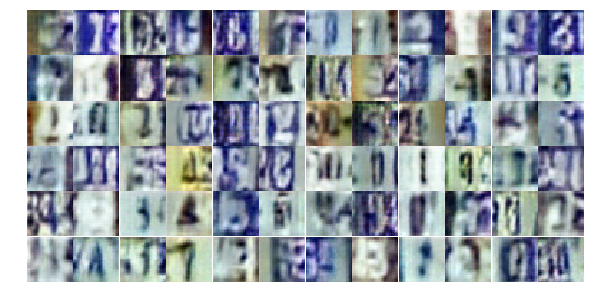

Epoch 6/25... Discriminator Loss: 0.8731... Generator Loss: 0.8054
Epoch 6/25... Discriminator Loss: 0.5754... Generator Loss: 1.1787
Epoch 6/25... Discriminator Loss: 1.2245... Generator Loss: 0.4767
Epoch 6/25... Discriminator Loss: 1.2683... Generator Loss: 0.5554
Epoch 6/25... Discriminator Loss: 0.6619... Generator Loss: 1.1365
Epoch 6/25... Discriminator Loss: 0.9238... Generator Loss: 0.8462
Epoch 6/25... Discriminator Loss: 0.7292... Generator Loss: 0.9336
Epoch 6/25... Discriminator Loss: 0.3739... Generator Loss: 1.6338
Epoch 6/25... Discriminator Loss: 0.5103... Generator Loss: 1.5719
Epoch 6/25... Discriminator Loss: 0.5717... Generator Loss: 1.1707


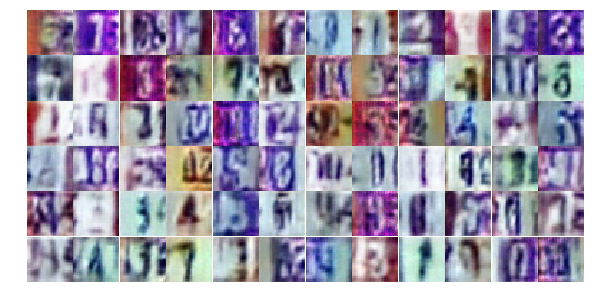

Epoch 6/25... Discriminator Loss: 0.7477... Generator Loss: 1.5361
Epoch 6/25... Discriminator Loss: 1.3796... Generator Loss: 2.5227
Epoch 6/25... Discriminator Loss: 0.9400... Generator Loss: 0.6343
Epoch 6/25... Discriminator Loss: 0.9327... Generator Loss: 0.6738
Epoch 6/25... Discriminator Loss: 0.7959... Generator Loss: 0.8296
Epoch 6/25... Discriminator Loss: 0.7836... Generator Loss: 0.9416
Epoch 6/25... Discriminator Loss: 0.6260... Generator Loss: 1.4257
Epoch 6/25... Discriminator Loss: 0.4955... Generator Loss: 1.5484
Epoch 6/25... Discriminator Loss: 1.0361... Generator Loss: 0.6373
Epoch 6/25... Discriminator Loss: 0.5188... Generator Loss: 1.2267


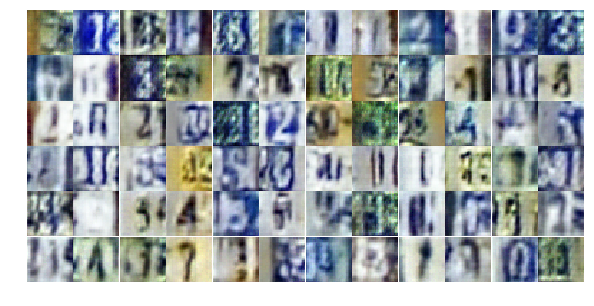

Epoch 6/25... Discriminator Loss: 0.9976... Generator Loss: 0.9224
Epoch 6/25... Discriminator Loss: 1.1426... Generator Loss: 0.7826
Epoch 6/25... Discriminator Loss: 1.1312... Generator Loss: 0.5838
Epoch 6/25... Discriminator Loss: 0.8091... Generator Loss: 1.5051
Epoch 6/25... Discriminator Loss: 0.7353... Generator Loss: 1.5950
Epoch 6/25... Discriminator Loss: 0.7139... Generator Loss: 0.9927
Epoch 6/25... Discriminator Loss: 0.6779... Generator Loss: 1.1566
Epoch 6/25... Discriminator Loss: 0.5676... Generator Loss: 1.5221
Epoch 6/25... Discriminator Loss: 0.5021... Generator Loss: 1.4190
Epoch 6/25... Discriminator Loss: 1.4158... Generator Loss: 0.3617


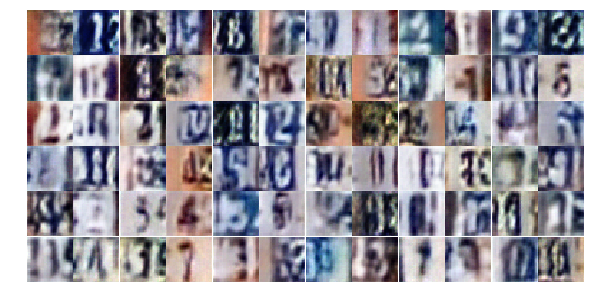

Epoch 6/25... Discriminator Loss: 0.6544... Generator Loss: 1.1209
Epoch 6/25... Discriminator Loss: 0.5524... Generator Loss: 1.3337
Epoch 6/25... Discriminator Loss: 0.9074... Generator Loss: 0.8175
Epoch 7/25... Discriminator Loss: 0.5887... Generator Loss: 2.0187
Epoch 7/25... Discriminator Loss: 0.8168... Generator Loss: 1.7073
Epoch 7/25... Discriminator Loss: 0.7038... Generator Loss: 1.1426
Epoch 7/25... Discriminator Loss: 0.4645... Generator Loss: 1.3458
Epoch 7/25... Discriminator Loss: 0.5151... Generator Loss: 1.7408
Epoch 7/25... Discriminator Loss: 0.6777... Generator Loss: 1.8876
Epoch 7/25... Discriminator Loss: 0.7314... Generator Loss: 0.9329


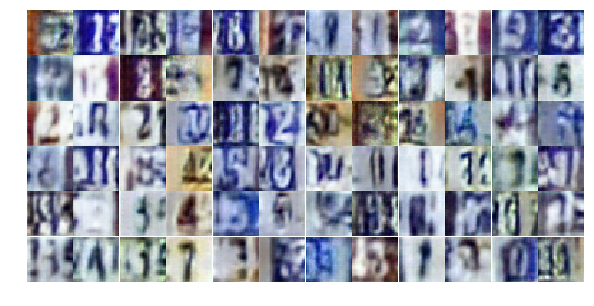

Epoch 7/25... Discriminator Loss: 0.5555... Generator Loss: 1.3455
Epoch 7/25... Discriminator Loss: 1.1642... Generator Loss: 0.5375
Epoch 7/25... Discriminator Loss: 0.5809... Generator Loss: 1.2067
Epoch 7/25... Discriminator Loss: 0.8500... Generator Loss: 2.3501
Epoch 7/25... Discriminator Loss: 0.6465... Generator Loss: 1.0073
Epoch 7/25... Discriminator Loss: 0.4279... Generator Loss: 1.5738
Epoch 7/25... Discriminator Loss: 1.1631... Generator Loss: 2.8346
Epoch 7/25... Discriminator Loss: 1.6214... Generator Loss: 3.8578
Epoch 7/25... Discriminator Loss: 0.7055... Generator Loss: 1.4910
Epoch 7/25... Discriminator Loss: 0.6083... Generator Loss: 1.1274


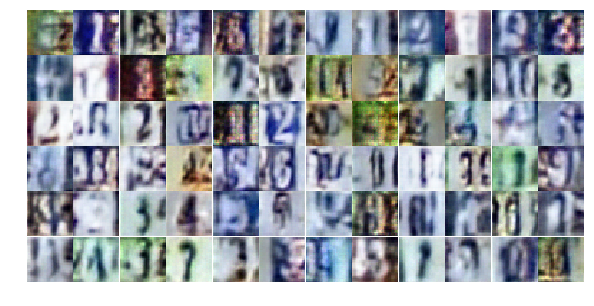

Epoch 7/25... Discriminator Loss: 0.6675... Generator Loss: 1.0900
Epoch 7/25... Discriminator Loss: 0.7809... Generator Loss: 2.0608
Epoch 7/25... Discriminator Loss: 1.0734... Generator Loss: 0.5808
Epoch 7/25... Discriminator Loss: 0.5773... Generator Loss: 1.3780
Epoch 7/25... Discriminator Loss: 0.4941... Generator Loss: 1.4273
Epoch 7/25... Discriminator Loss: 0.4717... Generator Loss: 1.5998
Epoch 7/25... Discriminator Loss: 0.8445... Generator Loss: 0.7760
Epoch 7/25... Discriminator Loss: 0.8122... Generator Loss: 0.8629
Epoch 7/25... Discriminator Loss: 0.3858... Generator Loss: 1.7181
Epoch 7/25... Discriminator Loss: 0.4211... Generator Loss: 1.7649


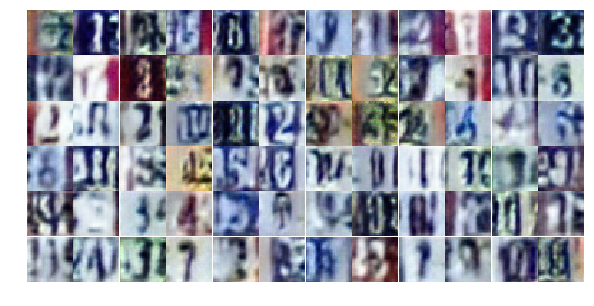

Epoch 7/25... Discriminator Loss: 1.4786... Generator Loss: 0.4355
Epoch 7/25... Discriminator Loss: 0.5957... Generator Loss: 1.2556
Epoch 7/25... Discriminator Loss: 0.6088... Generator Loss: 1.1597
Epoch 7/25... Discriminator Loss: 0.4658... Generator Loss: 1.3296
Epoch 7/25... Discriminator Loss: 0.6725... Generator Loss: 1.5591
Epoch 7/25... Discriminator Loss: 1.1624... Generator Loss: 0.5498
Epoch 7/25... Discriminator Loss: 0.4453... Generator Loss: 1.7453
Epoch 7/25... Discriminator Loss: 0.7263... Generator Loss: 0.9353
Epoch 7/25... Discriminator Loss: 1.0890... Generator Loss: 0.5162
Epoch 7/25... Discriminator Loss: 0.5567... Generator Loss: 1.7740


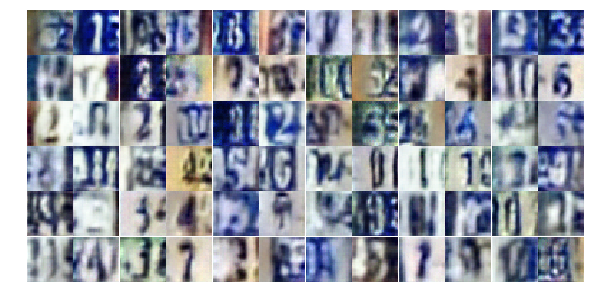

Epoch 7/25... Discriminator Loss: 1.6901... Generator Loss: 0.2688
Epoch 7/25... Discriminator Loss: 0.9810... Generator Loss: 0.6545
Epoch 7/25... Discriminator Loss: 0.3680... Generator Loss: 1.5919
Epoch 7/25... Discriminator Loss: 0.5780... Generator Loss: 1.9363
Epoch 7/25... Discriminator Loss: 1.4967... Generator Loss: 0.3667
Epoch 7/25... Discriminator Loss: 0.4886... Generator Loss: 2.1802
Epoch 7/25... Discriminator Loss: 0.3318... Generator Loss: 1.8965
Epoch 7/25... Discriminator Loss: 0.9091... Generator Loss: 0.8159
Epoch 7/25... Discriminator Loss: 0.3601... Generator Loss: 2.4270
Epoch 7/25... Discriminator Loss: 0.8309... Generator Loss: 1.1341


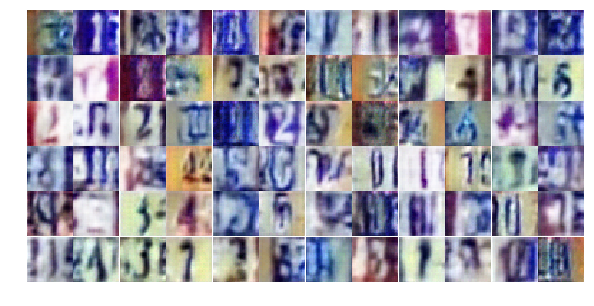

Epoch 7/25... Discriminator Loss: 0.7736... Generator Loss: 3.0908
Epoch 7/25... Discriminator Loss: 1.1998... Generator Loss: 0.4850
Epoch 7/25... Discriminator Loss: 0.7627... Generator Loss: 1.0712
Epoch 7/25... Discriminator Loss: 0.8305... Generator Loss: 0.8809
Epoch 7/25... Discriminator Loss: 0.5214... Generator Loss: 1.8875
Epoch 7/25... Discriminator Loss: 0.4680... Generator Loss: 1.5829
Epoch 7/25... Discriminator Loss: 1.2350... Generator Loss: 0.4529
Epoch 7/25... Discriminator Loss: 0.4865... Generator Loss: 2.4006
Epoch 7/25... Discriminator Loss: 1.1397... Generator Loss: 0.5897
Epoch 7/25... Discriminator Loss: 0.5286... Generator Loss: 1.2258


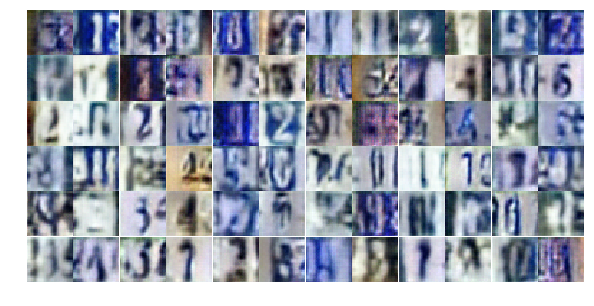

Epoch 7/25... Discriminator Loss: 0.6994... Generator Loss: 1.6997
Epoch 8/25... Discriminator Loss: 0.7429... Generator Loss: 0.9538
Epoch 8/25... Discriminator Loss: 0.6324... Generator Loss: 1.1165
Epoch 8/25... Discriminator Loss: 0.5192... Generator Loss: 1.4384
Epoch 8/25... Discriminator Loss: 0.6481... Generator Loss: 1.2955
Epoch 8/25... Discriminator Loss: 0.6855... Generator Loss: 1.0365
Epoch 8/25... Discriminator Loss: 0.4934... Generator Loss: 1.3338
Epoch 8/25... Discriminator Loss: 1.3027... Generator Loss: 2.5322
Epoch 8/25... Discriminator Loss: 1.1162... Generator Loss: 0.6287
Epoch 8/25... Discriminator Loss: 0.6093... Generator Loss: 1.2001


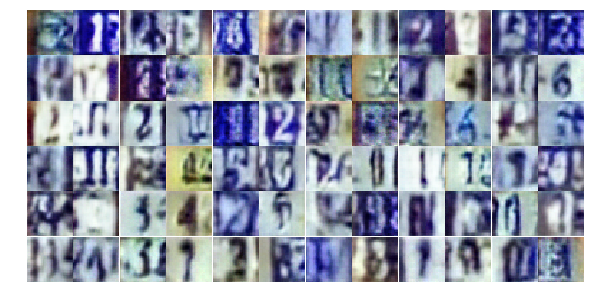

Epoch 8/25... Discriminator Loss: 0.5497... Generator Loss: 1.8492
Epoch 8/25... Discriminator Loss: 0.4156... Generator Loss: 1.6407
Epoch 8/25... Discriminator Loss: 0.9330... Generator Loss: 0.6884
Epoch 8/25... Discriminator Loss: 0.4064... Generator Loss: 1.7845
Epoch 8/25... Discriminator Loss: 0.8178... Generator Loss: 1.8471
Epoch 8/25... Discriminator Loss: 0.7339... Generator Loss: 0.9240
Epoch 8/25... Discriminator Loss: 0.4847... Generator Loss: 1.3924
Epoch 8/25... Discriminator Loss: 0.6581... Generator Loss: 1.3793
Epoch 8/25... Discriminator Loss: 0.9836... Generator Loss: 0.7557
Epoch 8/25... Discriminator Loss: 1.4005... Generator Loss: 0.3946


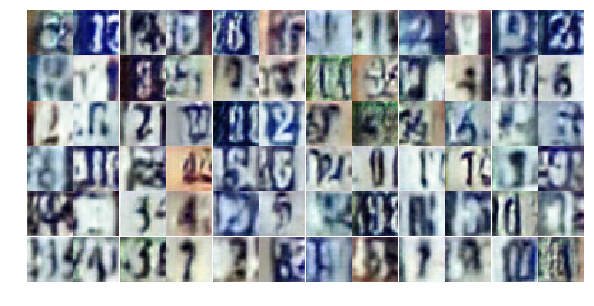

Epoch 8/25... Discriminator Loss: 0.4810... Generator Loss: 1.6917
Epoch 8/25... Discriminator Loss: 0.4906... Generator Loss: 1.4019
Epoch 8/25... Discriminator Loss: 0.6869... Generator Loss: 1.1877
Epoch 8/25... Discriminator Loss: 0.6112... Generator Loss: 1.5286
Epoch 8/25... Discriminator Loss: 0.5778... Generator Loss: 1.1622
Epoch 8/25... Discriminator Loss: 0.5614... Generator Loss: 1.2041
Epoch 8/25... Discriminator Loss: 0.7042... Generator Loss: 0.9729
Epoch 8/25... Discriminator Loss: 0.4833... Generator Loss: 1.4484
Epoch 8/25... Discriminator Loss: 0.6793... Generator Loss: 1.0717
Epoch 8/25... Discriminator Loss: 0.8026... Generator Loss: 0.7998


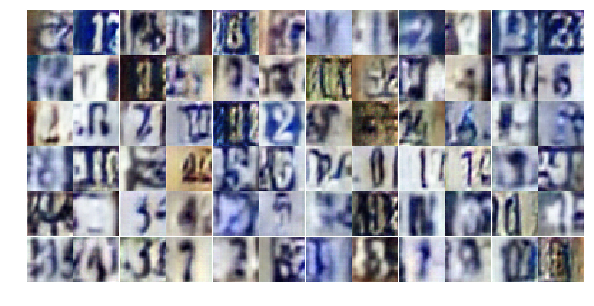

Epoch 8/25... Discriminator Loss: 0.7017... Generator Loss: 1.4456
Epoch 8/25... Discriminator Loss: 0.9760... Generator Loss: 0.6979
Epoch 8/25... Discriminator Loss: 0.5851... Generator Loss: 1.3987
Epoch 8/25... Discriminator Loss: 0.6519... Generator Loss: 1.0302
Epoch 8/25... Discriminator Loss: 1.2189... Generator Loss: 0.4567
Epoch 8/25... Discriminator Loss: 0.6596... Generator Loss: 1.0284
Epoch 8/25... Discriminator Loss: 0.6274... Generator Loss: 1.2621
Epoch 8/25... Discriminator Loss: 0.6432... Generator Loss: 1.2205
Epoch 8/25... Discriminator Loss: 0.5578... Generator Loss: 1.6646
Epoch 8/25... Discriminator Loss: 0.5040... Generator Loss: 1.4066


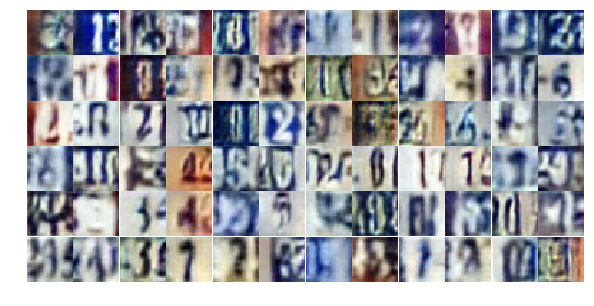

Epoch 8/25... Discriminator Loss: 0.5511... Generator Loss: 1.5806
Epoch 8/25... Discriminator Loss: 0.8398... Generator Loss: 0.8732
Epoch 8/25... Discriminator Loss: 0.7459... Generator Loss: 0.8930
Epoch 8/25... Discriminator Loss: 0.5074... Generator Loss: 1.7301
Epoch 8/25... Discriminator Loss: 2.3441... Generator Loss: 3.6786
Epoch 8/25... Discriminator Loss: 1.1587... Generator Loss: 0.5708
Epoch 8/25... Discriminator Loss: 0.8655... Generator Loss: 0.7109
Epoch 8/25... Discriminator Loss: 0.5725... Generator Loss: 1.6375
Epoch 8/25... Discriminator Loss: 0.6336... Generator Loss: 2.0248
Epoch 8/25... Discriminator Loss: 0.6128... Generator Loss: 1.1653


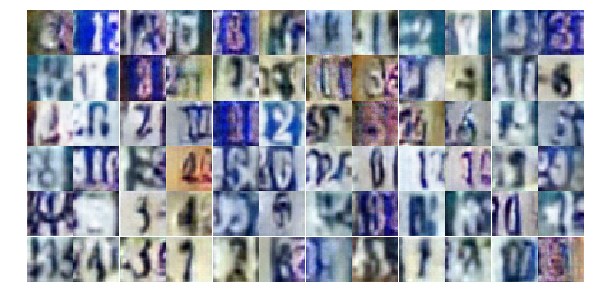

Epoch 8/25... Discriminator Loss: 0.7202... Generator Loss: 1.6667
Epoch 8/25... Discriminator Loss: 0.8206... Generator Loss: 0.8867
Epoch 8/25... Discriminator Loss: 0.9097... Generator Loss: 3.7099
Epoch 8/25... Discriminator Loss: 0.9254... Generator Loss: 0.7457
Epoch 8/25... Discriminator Loss: 0.5401... Generator Loss: 2.2043
Epoch 8/25... Discriminator Loss: 0.8144... Generator Loss: 0.9621
Epoch 8/25... Discriminator Loss: 0.5760... Generator Loss: 1.2211
Epoch 8/25... Discriminator Loss: 0.4696... Generator Loss: 1.5943
Epoch 9/25... Discriminator Loss: 0.8404... Generator Loss: 0.8649
Epoch 9/25... Discriminator Loss: 0.7522... Generator Loss: 0.9175


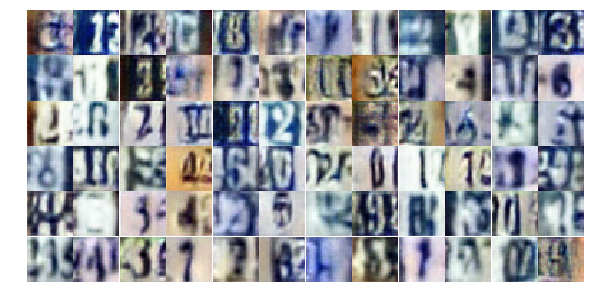

Epoch 9/25... Discriminator Loss: 1.0579... Generator Loss: 0.6271
Epoch 9/25... Discriminator Loss: 0.6066... Generator Loss: 1.5848
Epoch 9/25... Discriminator Loss: 0.9097... Generator Loss: 0.7168
Epoch 9/25... Discriminator Loss: 0.5001... Generator Loss: 1.6671
Epoch 9/25... Discriminator Loss: 1.5140... Generator Loss: 0.3496
Epoch 9/25... Discriminator Loss: 0.5634... Generator Loss: 1.3743
Epoch 9/25... Discriminator Loss: 0.7333... Generator Loss: 0.9637
Epoch 9/25... Discriminator Loss: 0.6375... Generator Loss: 1.0110
Epoch 9/25... Discriminator Loss: 0.8463... Generator Loss: 0.9814
Epoch 9/25... Discriminator Loss: 0.6728... Generator Loss: 1.0654


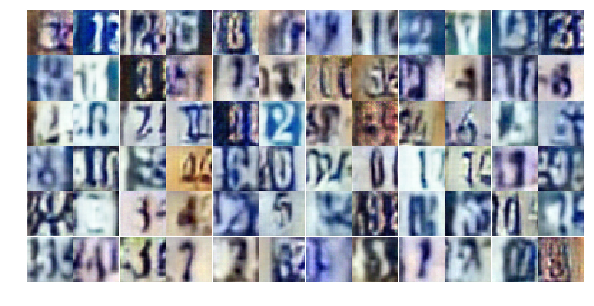

Epoch 9/25... Discriminator Loss: 0.6409... Generator Loss: 1.0019
Epoch 9/25... Discriminator Loss: 0.8507... Generator Loss: 0.7159
Epoch 9/25... Discriminator Loss: 1.0448... Generator Loss: 0.5701
Epoch 9/25... Discriminator Loss: 0.6881... Generator Loss: 1.3099
Epoch 9/25... Discriminator Loss: 0.4615... Generator Loss: 1.6697
Epoch 9/25... Discriminator Loss: 0.5338... Generator Loss: 1.6270
Epoch 9/25... Discriminator Loss: 1.1184... Generator Loss: 0.5358
Epoch 9/25... Discriminator Loss: 0.3912... Generator Loss: 1.5489
Epoch 9/25... Discriminator Loss: 0.9081... Generator Loss: 0.6898
Epoch 9/25... Discriminator Loss: 0.7593... Generator Loss: 0.8800


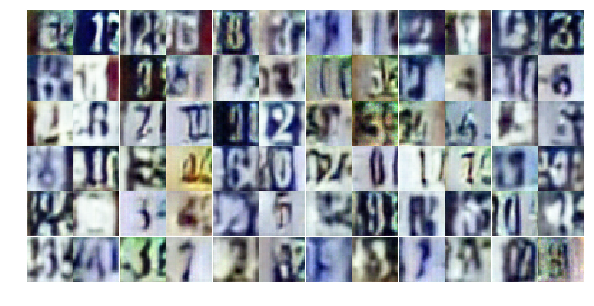

Epoch 9/25... Discriminator Loss: 1.0057... Generator Loss: 0.6438
Epoch 9/25... Discriminator Loss: 0.3898... Generator Loss: 1.9209
Epoch 9/25... Discriminator Loss: 0.5879... Generator Loss: 1.2608
Epoch 9/25... Discriminator Loss: 0.6098... Generator Loss: 1.5793
Epoch 9/25... Discriminator Loss: 0.4421... Generator Loss: 1.5279
Epoch 9/25... Discriminator Loss: 0.5989... Generator Loss: 1.1996
Epoch 9/25... Discriminator Loss: 1.3086... Generator Loss: 0.5225
Epoch 9/25... Discriminator Loss: 0.5567... Generator Loss: 1.4817
Epoch 9/25... Discriminator Loss: 0.5042... Generator Loss: 1.4970
Epoch 9/25... Discriminator Loss: 0.7194... Generator Loss: 0.9582


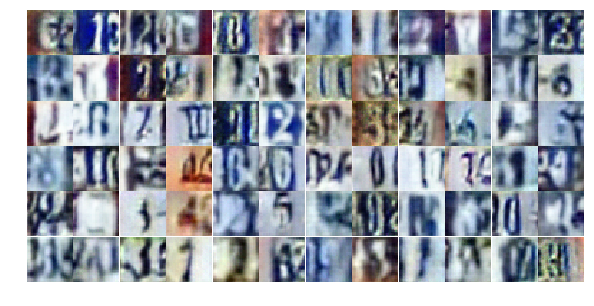

Epoch 9/25... Discriminator Loss: 0.5163... Generator Loss: 1.2689
Epoch 9/25... Discriminator Loss: 0.8010... Generator Loss: 0.8082
Epoch 9/25... Discriminator Loss: 0.9492... Generator Loss: 0.7356
Epoch 9/25... Discriminator Loss: 1.8379... Generator Loss: 0.3196
Epoch 9/25... Discriminator Loss: 1.1869... Generator Loss: 0.5605
Epoch 9/25... Discriminator Loss: 0.7463... Generator Loss: 1.0727
Epoch 9/25... Discriminator Loss: 0.9593... Generator Loss: 1.8170
Epoch 9/25... Discriminator Loss: 0.6760... Generator Loss: 1.2482
Epoch 9/25... Discriminator Loss: 1.0534... Generator Loss: 0.6613
Epoch 9/25... Discriminator Loss: 0.7336... Generator Loss: 0.9040


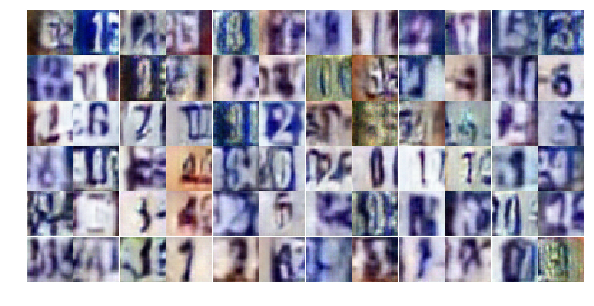

Epoch 9/25... Discriminator Loss: 0.6484... Generator Loss: 1.1444
Epoch 9/25... Discriminator Loss: 0.6733... Generator Loss: 1.2780
Epoch 9/25... Discriminator Loss: 0.5913... Generator Loss: 1.8628
Epoch 9/25... Discriminator Loss: 0.6829... Generator Loss: 1.2862
Epoch 9/25... Discriminator Loss: 0.4220... Generator Loss: 1.7914
Epoch 9/25... Discriminator Loss: 0.5795... Generator Loss: 1.2208
Epoch 9/25... Discriminator Loss: 0.6818... Generator Loss: 1.3542
Epoch 9/25... Discriminator Loss: 0.9103... Generator Loss: 0.6658
Epoch 9/25... Discriminator Loss: 0.5538... Generator Loss: 1.3247
Epoch 9/25... Discriminator Loss: 0.4025... Generator Loss: 1.7191


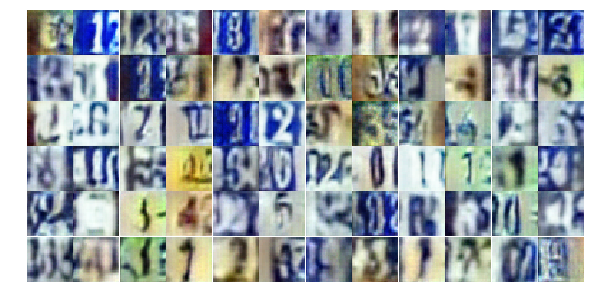

Epoch 9/25... Discriminator Loss: 0.8271... Generator Loss: 0.8741
Epoch 9/25... Discriminator Loss: 0.5825... Generator Loss: 2.0662
Epoch 9/25... Discriminator Loss: 0.7188... Generator Loss: 1.0305
Epoch 9/25... Discriminator Loss: 0.8232... Generator Loss: 0.7609
Epoch 9/25... Discriminator Loss: 0.8301... Generator Loss: 0.8625
Epoch 10/25... Discriminator Loss: 0.6348... Generator Loss: 1.2896
Epoch 10/25... Discriminator Loss: 0.6069... Generator Loss: 1.4160
Epoch 10/25... Discriminator Loss: 0.8105... Generator Loss: 0.7896
Epoch 10/25... Discriminator Loss: 0.5939... Generator Loss: 1.1269
Epoch 10/25... Discriminator Loss: 1.5161... Generator Loss: 0.3540


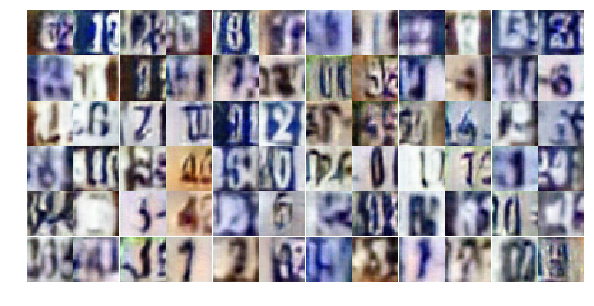

Epoch 10/25... Discriminator Loss: 0.5568... Generator Loss: 1.5548
Epoch 10/25... Discriminator Loss: 0.4697... Generator Loss: 1.4070
Epoch 10/25... Discriminator Loss: 0.5856... Generator Loss: 1.1774
Epoch 10/25... Discriminator Loss: 0.5959... Generator Loss: 1.2616
Epoch 10/25... Discriminator Loss: 0.8640... Generator Loss: 2.5240
Epoch 10/25... Discriminator Loss: 0.7776... Generator Loss: 1.6483
Epoch 10/25... Discriminator Loss: 0.5762... Generator Loss: 1.3593
Epoch 10/25... Discriminator Loss: 1.1486... Generator Loss: 0.5589
Epoch 10/25... Discriminator Loss: 1.0194... Generator Loss: 0.6677
Epoch 10/25... Discriminator Loss: 0.6970... Generator Loss: 1.4692


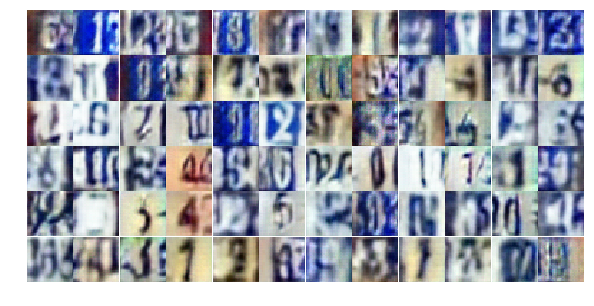

Epoch 10/25... Discriminator Loss: 0.6358... Generator Loss: 1.2676
Epoch 10/25... Discriminator Loss: 0.7228... Generator Loss: 1.2518
Epoch 10/25... Discriminator Loss: 0.7214... Generator Loss: 1.1695
Epoch 10/25... Discriminator Loss: 1.0099... Generator Loss: 0.7020
Epoch 10/25... Discriminator Loss: 0.6850... Generator Loss: 1.3413
Epoch 10/25... Discriminator Loss: 0.8926... Generator Loss: 0.7809
Epoch 10/25... Discriminator Loss: 0.7943... Generator Loss: 0.7878
Epoch 10/25... Discriminator Loss: 0.7433... Generator Loss: 0.8919
Epoch 10/25... Discriminator Loss: 0.6414... Generator Loss: 1.1553
Epoch 10/25... Discriminator Loss: 0.4461... Generator Loss: 1.8599


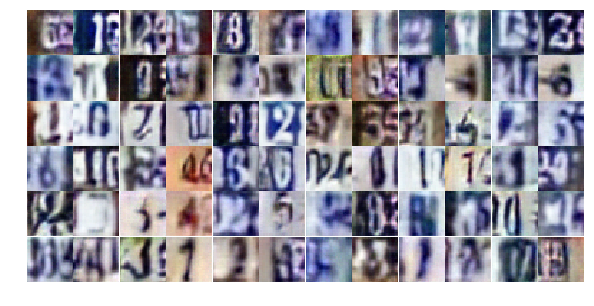

Epoch 10/25... Discriminator Loss: 0.8646... Generator Loss: 0.7334
Epoch 10/25... Discriminator Loss: 0.7916... Generator Loss: 0.8777
Epoch 10/25... Discriminator Loss: 0.4605... Generator Loss: 1.6657
Epoch 10/25... Discriminator Loss: 0.4692... Generator Loss: 1.6107
Epoch 10/25... Discriminator Loss: 0.8732... Generator Loss: 0.7220
Epoch 10/25... Discriminator Loss: 0.6730... Generator Loss: 1.0527
Epoch 10/25... Discriminator Loss: 0.5448... Generator Loss: 1.9937
Epoch 10/25... Discriminator Loss: 0.8032... Generator Loss: 0.8371
Epoch 10/25... Discriminator Loss: 0.6524... Generator Loss: 1.4164
Epoch 10/25... Discriminator Loss: 0.6238... Generator Loss: 1.1343


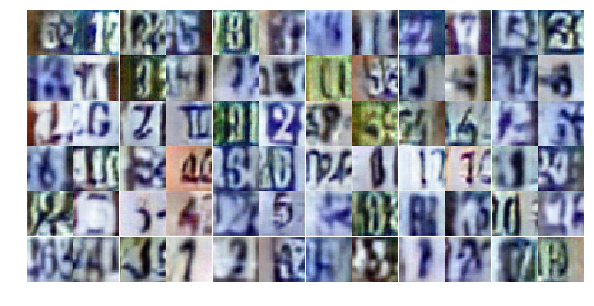

Epoch 10/25... Discriminator Loss: 1.0631... Generator Loss: 3.1936
Epoch 10/25... Discriminator Loss: 0.7821... Generator Loss: 0.9985
Epoch 10/25... Discriminator Loss: 0.4764... Generator Loss: 1.3439
Epoch 10/25... Discriminator Loss: 0.6576... Generator Loss: 1.5891
Epoch 10/25... Discriminator Loss: 0.4939... Generator Loss: 1.6547
Epoch 10/25... Discriminator Loss: 1.0080... Generator Loss: 0.6065
Epoch 10/25... Discriminator Loss: 0.6782... Generator Loss: 1.0755
Epoch 10/25... Discriminator Loss: 0.6031... Generator Loss: 1.3095
Epoch 10/25... Discriminator Loss: 0.8675... Generator Loss: 0.9701
Epoch 10/25... Discriminator Loss: 1.5508... Generator Loss: 2.0741


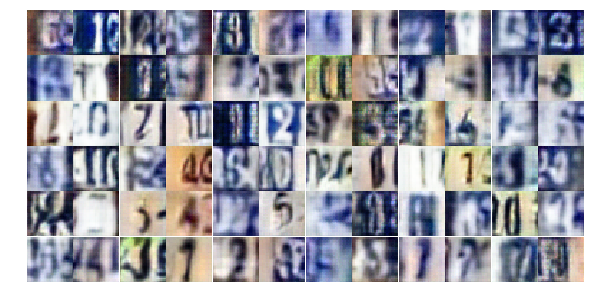

Epoch 10/25... Discriminator Loss: 0.6886... Generator Loss: 1.2002
Epoch 10/25... Discriminator Loss: 0.6784... Generator Loss: 1.6998
Epoch 10/25... Discriminator Loss: 0.7479... Generator Loss: 0.9163
Epoch 10/25... Discriminator Loss: 0.7300... Generator Loss: 1.3248
Epoch 10/25... Discriminator Loss: 0.4696... Generator Loss: 1.9176
Epoch 10/25... Discriminator Loss: 0.7749... Generator Loss: 0.9145
Epoch 10/25... Discriminator Loss: 0.6813... Generator Loss: 1.0941
Epoch 10/25... Discriminator Loss: 0.4648... Generator Loss: 1.5512
Epoch 10/25... Discriminator Loss: 0.7564... Generator Loss: 2.0757
Epoch 10/25... Discriminator Loss: 0.6685... Generator Loss: 1.0073


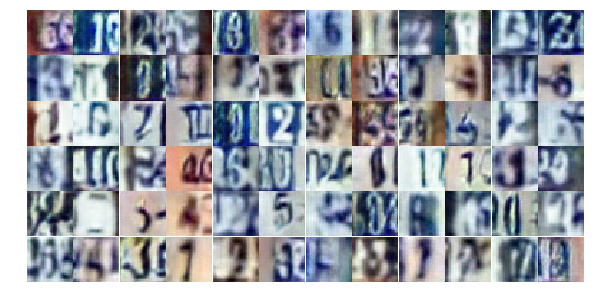

Epoch 10/25... Discriminator Loss: 0.6903... Generator Loss: 1.4509
Epoch 10/25... Discriminator Loss: 0.6289... Generator Loss: 1.0766
Epoch 10/25... Discriminator Loss: 0.4842... Generator Loss: 1.2928
Epoch 11/25... Discriminator Loss: 0.7703... Generator Loss: 1.1746
Epoch 11/25... Discriminator Loss: 0.5686... Generator Loss: 1.2607
Epoch 11/25... Discriminator Loss: 1.0954... Generator Loss: 0.5612
Epoch 11/25... Discriminator Loss: 0.7716... Generator Loss: 0.8537
Epoch 11/25... Discriminator Loss: 0.6976... Generator Loss: 1.4313
Epoch 11/25... Discriminator Loss: 1.7812... Generator Loss: 0.2641
Epoch 11/25... Discriminator Loss: 0.9527... Generator Loss: 0.8377


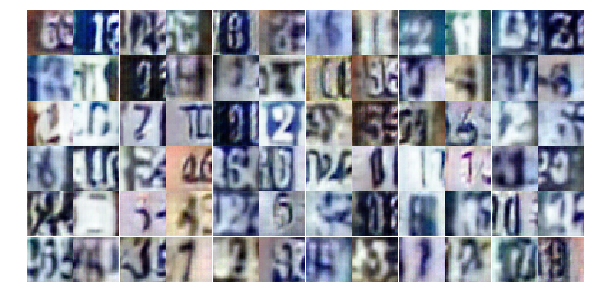

Epoch 11/25... Discriminator Loss: 0.6080... Generator Loss: 1.5688
Epoch 11/25... Discriminator Loss: 0.7444... Generator Loss: 1.0216
Epoch 11/25... Discriminator Loss: 0.5232... Generator Loss: 1.3494
Epoch 11/25... Discriminator Loss: 0.6167... Generator Loss: 1.2877
Epoch 11/25... Discriminator Loss: 0.9201... Generator Loss: 0.7227
Epoch 11/25... Discriminator Loss: 0.4150... Generator Loss: 1.8615
Epoch 11/25... Discriminator Loss: 0.8558... Generator Loss: 0.7964
Epoch 11/25... Discriminator Loss: 0.4240... Generator Loss: 1.6631
Epoch 11/25... Discriminator Loss: 0.7562... Generator Loss: 0.8680
Epoch 11/25... Discriminator Loss: 1.4331... Generator Loss: 0.4304


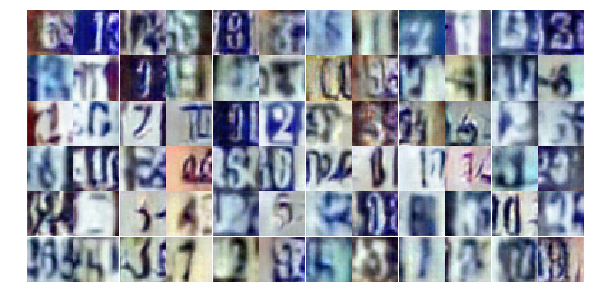

Epoch 11/25... Discriminator Loss: 0.9479... Generator Loss: 0.7174
Epoch 11/25... Discriminator Loss: 0.5367... Generator Loss: 1.5056
Epoch 11/25... Discriminator Loss: 0.9628... Generator Loss: 0.6880
Epoch 11/25... Discriminator Loss: 0.5582... Generator Loss: 1.2290
Epoch 11/25... Discriminator Loss: 0.2729... Generator Loss: 2.0629
Epoch 11/25... Discriminator Loss: 0.4760... Generator Loss: 1.7531
Epoch 11/25... Discriminator Loss: 0.6252... Generator Loss: 1.1155
Epoch 11/25... Discriminator Loss: 0.9516... Generator Loss: 0.7231
Epoch 11/25... Discriminator Loss: 0.4461... Generator Loss: 1.7811
Epoch 11/25... Discriminator Loss: 1.1215... Generator Loss: 0.5309


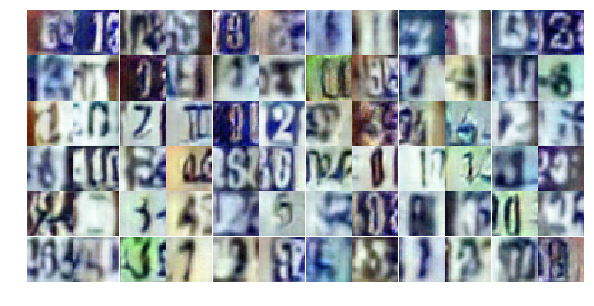

Epoch 11/25... Discriminator Loss: 0.6957... Generator Loss: 1.2035
Epoch 11/25... Discriminator Loss: 0.6146... Generator Loss: 1.1010
Epoch 11/25... Discriminator Loss: 0.9299... Generator Loss: 0.7490
Epoch 11/25... Discriminator Loss: 0.5164... Generator Loss: 1.5701
Epoch 11/25... Discriminator Loss: 0.5500... Generator Loss: 1.2564
Epoch 11/25... Discriminator Loss: 1.0142... Generator Loss: 0.5945
Epoch 11/25... Discriminator Loss: 0.6518... Generator Loss: 1.6814
Epoch 11/25... Discriminator Loss: 1.1267... Generator Loss: 0.5353
Epoch 11/25... Discriminator Loss: 0.9035... Generator Loss: 0.8355
Epoch 11/25... Discriminator Loss: 1.6999... Generator Loss: 0.3110


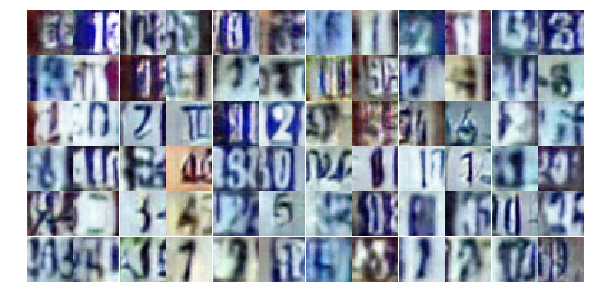

Epoch 11/25... Discriminator Loss: 0.6166... Generator Loss: 1.1220
Epoch 11/25... Discriminator Loss: 0.7299... Generator Loss: 0.8964
Epoch 11/25... Discriminator Loss: 0.5534... Generator Loss: 1.2320
Epoch 11/25... Discriminator Loss: 0.7634... Generator Loss: 1.0777
Epoch 11/25... Discriminator Loss: 0.7157... Generator Loss: 1.0462
Epoch 11/25... Discriminator Loss: 0.5600... Generator Loss: 1.1380
Epoch 11/25... Discriminator Loss: 0.3111... Generator Loss: 2.3413
Epoch 11/25... Discriminator Loss: 0.5569... Generator Loss: 1.7290
Epoch 11/25... Discriminator Loss: 1.1063... Generator Loss: 0.5535
Epoch 11/25... Discriminator Loss: 0.4573... Generator Loss: 1.4588


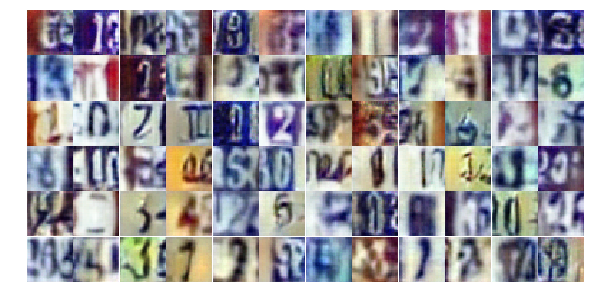

Epoch 11/25... Discriminator Loss: 1.1146... Generator Loss: 0.6032
Epoch 11/25... Discriminator Loss: 0.3929... Generator Loss: 1.8093
Epoch 11/25... Discriminator Loss: 0.6834... Generator Loss: 1.3640
Epoch 11/25... Discriminator Loss: 0.7345... Generator Loss: 0.8772
Epoch 11/25... Discriminator Loss: 0.9583... Generator Loss: 0.7366
Epoch 11/25... Discriminator Loss: 1.7804... Generator Loss: 0.4658
Epoch 11/25... Discriminator Loss: 1.3626... Generator Loss: 0.4567
Epoch 11/25... Discriminator Loss: 0.4584... Generator Loss: 1.6889
Epoch 11/25... Discriminator Loss: 0.8463... Generator Loss: 1.0378
Epoch 11/25... Discriminator Loss: 0.8463... Generator Loss: 0.9910


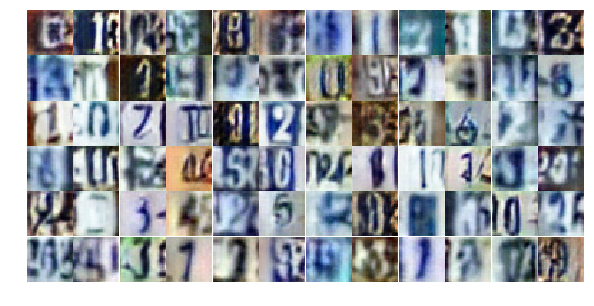

Epoch 12/25... Discriminator Loss: 0.7342... Generator Loss: 1.3066
Epoch 12/25... Discriminator Loss: 0.7580... Generator Loss: 1.2068
Epoch 12/25... Discriminator Loss: 0.8434... Generator Loss: 0.7808
Epoch 12/25... Discriminator Loss: 0.6018... Generator Loss: 1.2215
Epoch 12/25... Discriminator Loss: 0.5934... Generator Loss: 1.7789
Epoch 12/25... Discriminator Loss: 1.2919... Generator Loss: 0.4492
Epoch 12/25... Discriminator Loss: 0.6044... Generator Loss: 1.3956
Epoch 12/25... Discriminator Loss: 0.5438... Generator Loss: 1.5541
Epoch 12/25... Discriminator Loss: 0.6548... Generator Loss: 1.1551
Epoch 12/25... Discriminator Loss: 1.0733... Generator Loss: 0.6737


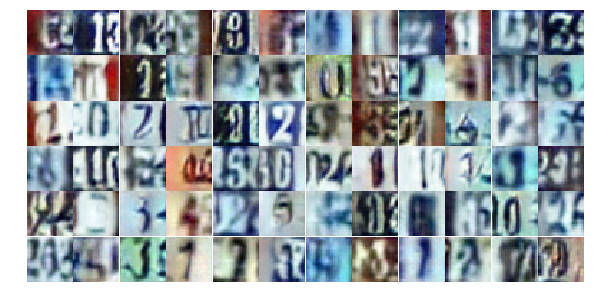

Epoch 12/25... Discriminator Loss: 0.5743... Generator Loss: 1.2266
Epoch 12/25... Discriminator Loss: 1.3516... Generator Loss: 0.4222
Epoch 12/25... Discriminator Loss: 0.5155... Generator Loss: 1.2477
Epoch 12/25... Discriminator Loss: 0.6840... Generator Loss: 1.1545
Epoch 12/25... Discriminator Loss: 0.4545... Generator Loss: 1.9826
Epoch 12/25... Discriminator Loss: 1.1439... Generator Loss: 0.6895
Epoch 12/25... Discriminator Loss: 1.1659... Generator Loss: 0.5210
Epoch 12/25... Discriminator Loss: 0.5808... Generator Loss: 1.6363
Epoch 12/25... Discriminator Loss: 0.5230... Generator Loss: 1.2858
Epoch 12/25... Discriminator Loss: 0.7565... Generator Loss: 0.8398


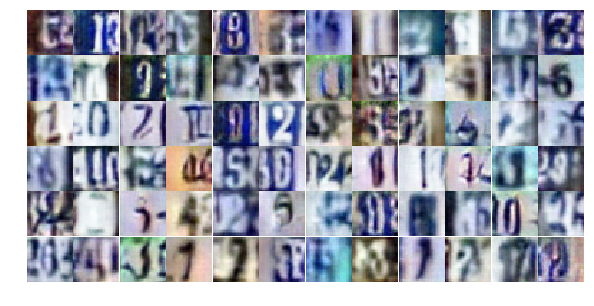

Epoch 12/25... Discriminator Loss: 0.3908... Generator Loss: 1.6515
Epoch 12/25... Discriminator Loss: 0.4356... Generator Loss: 1.7128
Epoch 12/25... Discriminator Loss: 0.6731... Generator Loss: 1.0472
Epoch 12/25... Discriminator Loss: 0.5912... Generator Loss: 1.8091
Epoch 12/25... Discriminator Loss: 0.4639... Generator Loss: 1.9931
Epoch 12/25... Discriminator Loss: 0.5431... Generator Loss: 1.2867
Epoch 12/25... Discriminator Loss: 0.8443... Generator Loss: 0.8184
Epoch 12/25... Discriminator Loss: 0.4547... Generator Loss: 1.6201
Epoch 12/25... Discriminator Loss: 0.4833... Generator Loss: 1.5512
Epoch 12/25... Discriminator Loss: 0.4289... Generator Loss: 1.6210


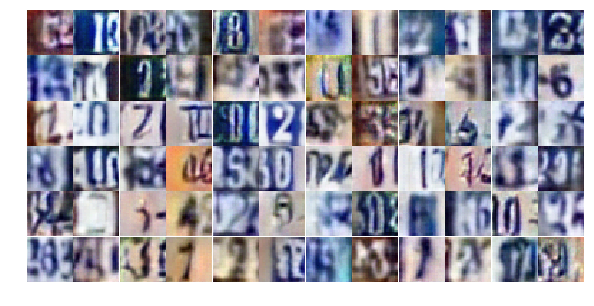

Epoch 12/25... Discriminator Loss: 0.5093... Generator Loss: 1.3452
Epoch 12/25... Discriminator Loss: 0.7136... Generator Loss: 0.9832
Epoch 12/25... Discriminator Loss: 0.9914... Generator Loss: 0.6269
Epoch 12/25... Discriminator Loss: 1.9282... Generator Loss: 0.2329
Epoch 12/25... Discriminator Loss: 0.5620... Generator Loss: 1.3187
Epoch 12/25... Discriminator Loss: 0.7578... Generator Loss: 1.1057
Epoch 12/25... Discriminator Loss: 1.2688... Generator Loss: 0.4370
Epoch 12/25... Discriminator Loss: 0.9000... Generator Loss: 0.7589
Epoch 12/25... Discriminator Loss: 0.7921... Generator Loss: 0.8533
Epoch 12/25... Discriminator Loss: 0.3530... Generator Loss: 2.7578


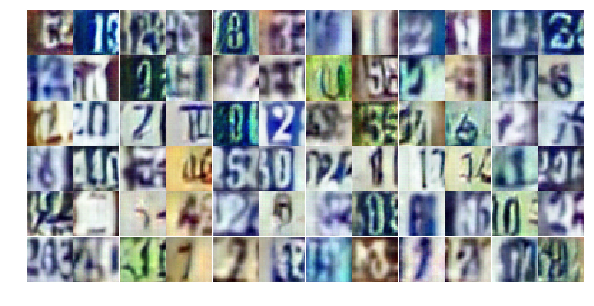

Epoch 12/25... Discriminator Loss: 0.4845... Generator Loss: 2.0655
Epoch 12/25... Discriminator Loss: 0.5622... Generator Loss: 1.0653
Epoch 12/25... Discriminator Loss: 0.3983... Generator Loss: 1.6761
Epoch 12/25... Discriminator Loss: 0.6722... Generator Loss: 1.0520
Epoch 12/25... Discriminator Loss: 0.6972... Generator Loss: 1.0367
Epoch 12/25... Discriminator Loss: 0.6989... Generator Loss: 1.0278
Epoch 12/25... Discriminator Loss: 0.6856... Generator Loss: 0.9506
Epoch 12/25... Discriminator Loss: 0.8114... Generator Loss: 0.8936
Epoch 12/25... Discriminator Loss: 0.4106... Generator Loss: 1.7408
Epoch 12/25... Discriminator Loss: 0.5978... Generator Loss: 1.4227


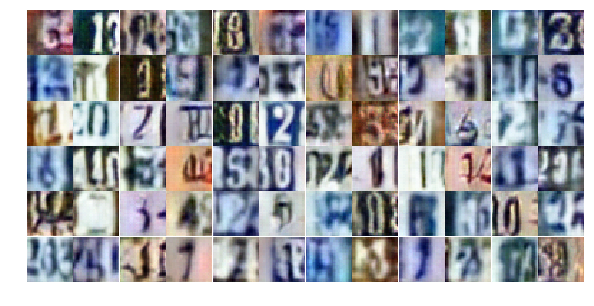

Epoch 12/25... Discriminator Loss: 1.0068... Generator Loss: 0.6831
Epoch 12/25... Discriminator Loss: 0.4678... Generator Loss: 1.4711
Epoch 12/25... Discriminator Loss: 0.7226... Generator Loss: 1.0872
Epoch 12/25... Discriminator Loss: 1.8154... Generator Loss: 0.2719
Epoch 12/25... Discriminator Loss: 0.6304... Generator Loss: 1.1474
Epoch 12/25... Discriminator Loss: 0.7025... Generator Loss: 2.6120
Epoch 12/25... Discriminator Loss: 0.9307... Generator Loss: 0.8605
Epoch 13/25... Discriminator Loss: 0.5331... Generator Loss: 1.2508
Epoch 13/25... Discriminator Loss: 0.4537... Generator Loss: 1.4529
Epoch 13/25... Discriminator Loss: 0.9571... Generator Loss: 0.6824


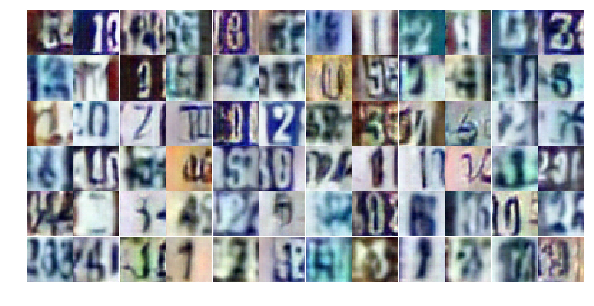

Epoch 13/25... Discriminator Loss: 0.6279... Generator Loss: 1.2106
Epoch 13/25... Discriminator Loss: 0.6749... Generator Loss: 2.1276
Epoch 13/25... Discriminator Loss: 1.0380... Generator Loss: 0.7095
Epoch 13/25... Discriminator Loss: 0.9907... Generator Loss: 0.6636
Epoch 13/25... Discriminator Loss: 0.8617... Generator Loss: 0.7832
Epoch 13/25... Discriminator Loss: 0.6820... Generator Loss: 1.0321
Epoch 13/25... Discriminator Loss: 0.5882... Generator Loss: 1.2280
Epoch 13/25... Discriminator Loss: 0.5043... Generator Loss: 1.3484
Epoch 13/25... Discriminator Loss: 0.4881... Generator Loss: 1.4025
Epoch 13/25... Discriminator Loss: 0.5478... Generator Loss: 1.6728


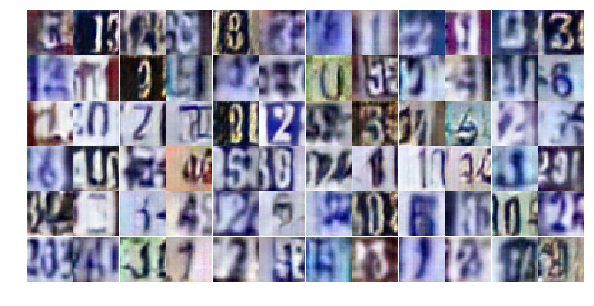

Epoch 13/25... Discriminator Loss: 3.0337... Generator Loss: 5.2401
Epoch 13/25... Discriminator Loss: 0.6641... Generator Loss: 1.3947
Epoch 13/25... Discriminator Loss: 0.8533... Generator Loss: 0.9136
Epoch 13/25... Discriminator Loss: 0.7020... Generator Loss: 1.0563
Epoch 13/25... Discriminator Loss: 0.5579... Generator Loss: 1.4176
Epoch 13/25... Discriminator Loss: 1.1110... Generator Loss: 0.5362
Epoch 13/25... Discriminator Loss: 0.8246... Generator Loss: 0.8180
Epoch 13/25... Discriminator Loss: 1.1950... Generator Loss: 0.5767
Epoch 13/25... Discriminator Loss: 0.6753... Generator Loss: 1.1191
Epoch 13/25... Discriminator Loss: 0.8026... Generator Loss: 0.8592


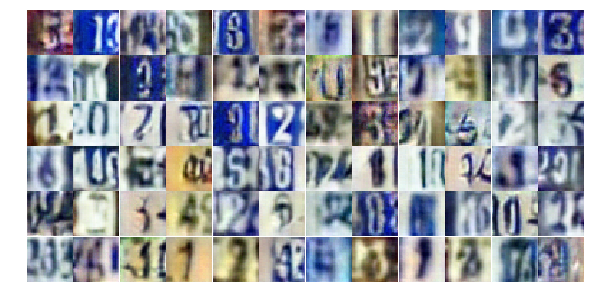

Epoch 13/25... Discriminator Loss: 0.6285... Generator Loss: 1.2383
Epoch 13/25... Discriminator Loss: 0.5014... Generator Loss: 1.6535
Epoch 13/25... Discriminator Loss: 0.5961... Generator Loss: 1.3501
Epoch 13/25... Discriminator Loss: 0.8432... Generator Loss: 0.8615
Epoch 13/25... Discriminator Loss: 0.4679... Generator Loss: 1.4556
Epoch 13/25... Discriminator Loss: 0.6486... Generator Loss: 1.3219
Epoch 13/25... Discriminator Loss: 1.0073... Generator Loss: 1.6170
Epoch 13/25... Discriminator Loss: 0.5549... Generator Loss: 1.3473
Epoch 13/25... Discriminator Loss: 0.5157... Generator Loss: 1.2952
Epoch 13/25... Discriminator Loss: 0.5518... Generator Loss: 1.2334


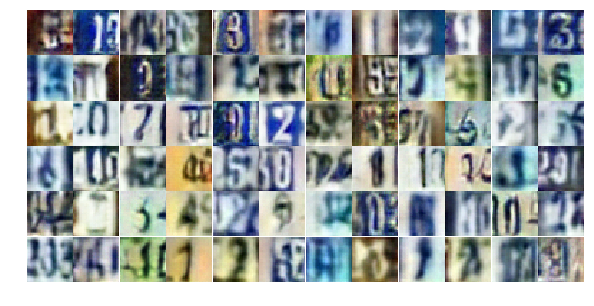

Epoch 13/25... Discriminator Loss: 1.1739... Generator Loss: 0.5024
Epoch 13/25... Discriminator Loss: 0.9960... Generator Loss: 0.7453
Epoch 13/25... Discriminator Loss: 1.0750... Generator Loss: 0.6188
Epoch 13/25... Discriminator Loss: 1.6875... Generator Loss: 0.3103
Epoch 13/25... Discriminator Loss: 0.5637... Generator Loss: 1.4713
Epoch 13/25... Discriminator Loss: 0.4528... Generator Loss: 1.7470
Epoch 13/25... Discriminator Loss: 0.3990... Generator Loss: 1.7276
Epoch 13/25... Discriminator Loss: 1.6285... Generator Loss: 0.2982
Epoch 13/25... Discriminator Loss: 0.7151... Generator Loss: 1.0146
Epoch 13/25... Discriminator Loss: 0.8940... Generator Loss: 0.7028


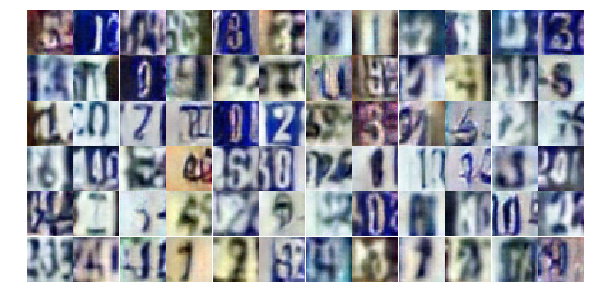

Epoch 13/25... Discriminator Loss: 0.5638... Generator Loss: 1.2891
Epoch 13/25... Discriminator Loss: 0.5161... Generator Loss: 1.8711
Epoch 13/25... Discriminator Loss: 0.9134... Generator Loss: 0.7542
Epoch 13/25... Discriminator Loss: 0.6628... Generator Loss: 0.9631
Epoch 13/25... Discriminator Loss: 1.0683... Generator Loss: 0.5838
Epoch 13/25... Discriminator Loss: 0.7060... Generator Loss: 1.0182
Epoch 13/25... Discriminator Loss: 0.5195... Generator Loss: 1.3314
Epoch 13/25... Discriminator Loss: 0.6714... Generator Loss: 1.2506
Epoch 13/25... Discriminator Loss: 0.8525... Generator Loss: 0.7479
Epoch 13/25... Discriminator Loss: 0.9980... Generator Loss: 0.7142


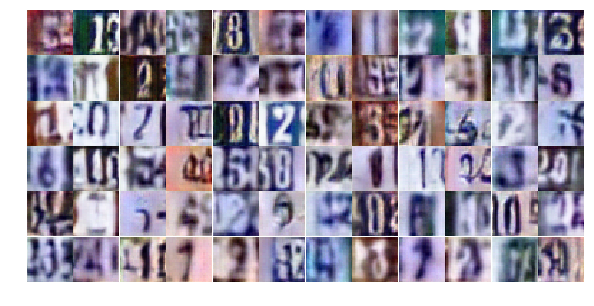

Epoch 13/25... Discriminator Loss: 0.3179... Generator Loss: 2.5551
Epoch 13/25... Discriminator Loss: 1.4985... Generator Loss: 0.3427
Epoch 13/25... Discriminator Loss: 1.0372... Generator Loss: 0.6356
Epoch 13/25... Discriminator Loss: 0.7542... Generator Loss: 0.8770
Epoch 14/25... Discriminator Loss: 1.1668... Generator Loss: 0.5655
Epoch 14/25... Discriminator Loss: 1.1043... Generator Loss: 0.6243
Epoch 14/25... Discriminator Loss: 1.0979... Generator Loss: 0.6364
Epoch 14/25... Discriminator Loss: 0.4681... Generator Loss: 2.1524
Epoch 14/25... Discriminator Loss: 0.6596... Generator Loss: 1.0765
Epoch 14/25... Discriminator Loss: 0.7657... Generator Loss: 0.9016


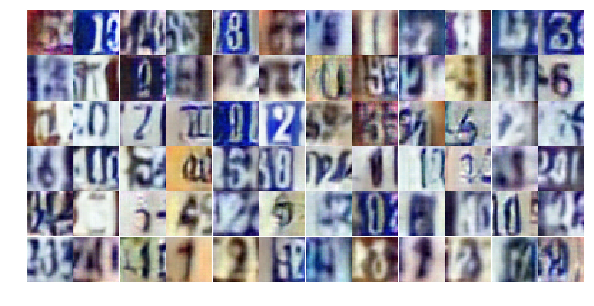

Epoch 14/25... Discriminator Loss: 0.7668... Generator Loss: 1.6911
Epoch 14/25... Discriminator Loss: 1.3801... Generator Loss: 0.4418
Epoch 14/25... Discriminator Loss: 3.9949... Generator Loss: 0.0523
Epoch 14/25... Discriminator Loss: 0.9067... Generator Loss: 0.9968
Epoch 14/25... Discriminator Loss: 1.3005... Generator Loss: 0.4278
Epoch 14/25... Discriminator Loss: 0.4505... Generator Loss: 1.4773
Epoch 14/25... Discriminator Loss: 0.5227... Generator Loss: 1.8559
Epoch 14/25... Discriminator Loss: 1.3169... Generator Loss: 0.4215
Epoch 14/25... Discriminator Loss: 0.8960... Generator Loss: 0.7869
Epoch 14/25... Discriminator Loss: 1.0604... Generator Loss: 0.5747


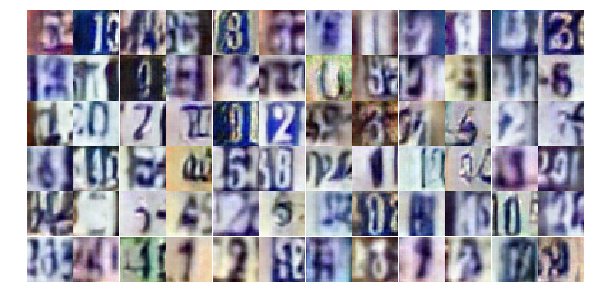

Epoch 14/25... Discriminator Loss: 0.5707... Generator Loss: 1.0724
Epoch 14/25... Discriminator Loss: 0.4604... Generator Loss: 2.0060
Epoch 14/25... Discriminator Loss: 0.8997... Generator Loss: 0.7876
Epoch 14/25... Discriminator Loss: 0.5777... Generator Loss: 1.3005
Epoch 14/25... Discriminator Loss: 0.9876... Generator Loss: 0.6717
Epoch 14/25... Discriminator Loss: 0.7389... Generator Loss: 0.9645
Epoch 14/25... Discriminator Loss: 0.7149... Generator Loss: 0.9801
Epoch 14/25... Discriminator Loss: 0.7600... Generator Loss: 0.9714
Epoch 14/25... Discriminator Loss: 0.4850... Generator Loss: 1.3102
Epoch 14/25... Discriminator Loss: 0.5685... Generator Loss: 1.2711


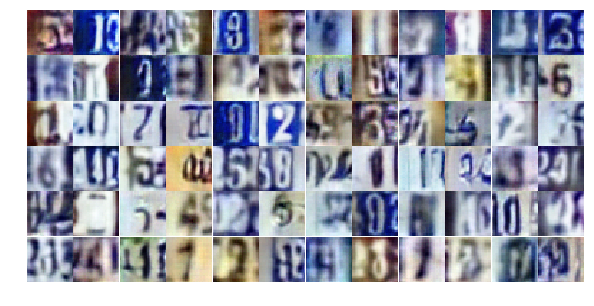

Epoch 14/25... Discriminator Loss: 1.3445... Generator Loss: 0.4665
Epoch 14/25... Discriminator Loss: 0.5106... Generator Loss: 1.2091
Epoch 14/25... Discriminator Loss: 0.3744... Generator Loss: 1.9237
Epoch 14/25... Discriminator Loss: 0.4128... Generator Loss: 1.6513
Epoch 14/25... Discriminator Loss: 0.4839... Generator Loss: 1.3475
Epoch 14/25... Discriminator Loss: 0.5627... Generator Loss: 1.1849
Epoch 14/25... Discriminator Loss: 0.6227... Generator Loss: 1.1517
Epoch 14/25... Discriminator Loss: 0.4236... Generator Loss: 1.5469
Epoch 14/25... Discriminator Loss: 0.3702... Generator Loss: 1.6665
Epoch 14/25... Discriminator Loss: 1.2373... Generator Loss: 0.4624


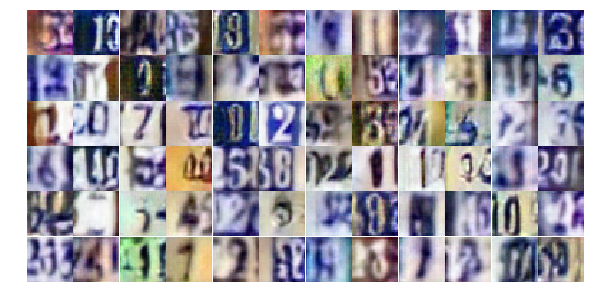

Epoch 14/25... Discriminator Loss: 1.5246... Generator Loss: 0.3578
Epoch 14/25... Discriminator Loss: 0.6842... Generator Loss: 1.7275
Epoch 14/25... Discriminator Loss: 1.1715... Generator Loss: 0.5285
Epoch 14/25... Discriminator Loss: 1.1802... Generator Loss: 0.5310
Epoch 14/25... Discriminator Loss: 1.1360... Generator Loss: 0.5463
Epoch 14/25... Discriminator Loss: 0.8274... Generator Loss: 0.8321
Epoch 14/25... Discriminator Loss: 0.6741... Generator Loss: 2.0950
Epoch 14/25... Discriminator Loss: 0.5383... Generator Loss: 1.1866
Epoch 14/25... Discriminator Loss: 0.8617... Generator Loss: 0.8502
Epoch 14/25... Discriminator Loss: 1.3179... Generator Loss: 0.3957


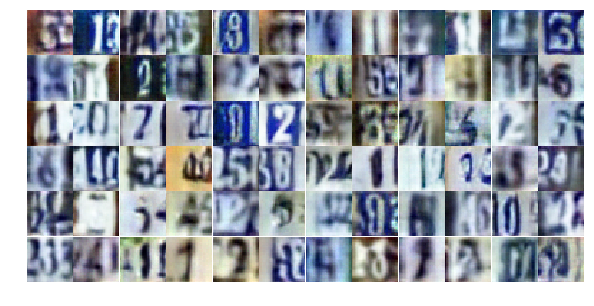

Epoch 14/25... Discriminator Loss: 0.8375... Generator Loss: 0.9360
Epoch 14/25... Discriminator Loss: 1.3209... Generator Loss: 0.4824
Epoch 14/25... Discriminator Loss: 0.8709... Generator Loss: 0.8843
Epoch 14/25... Discriminator Loss: 0.7177... Generator Loss: 0.9747
Epoch 14/25... Discriminator Loss: 0.6208... Generator Loss: 1.1578
Epoch 14/25... Discriminator Loss: 0.7417... Generator Loss: 0.9698
Epoch 14/25... Discriminator Loss: 0.6984... Generator Loss: 1.1589
Epoch 14/25... Discriminator Loss: 0.7472... Generator Loss: 2.6006
Epoch 14/25... Discriminator Loss: 0.9088... Generator Loss: 0.7814
Epoch 14/25... Discriminator Loss: 0.9047... Generator Loss: 0.7733


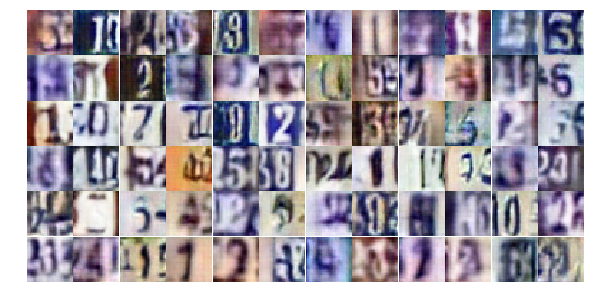

Epoch 14/25... Discriminator Loss: 0.8657... Generator Loss: 0.8070
Epoch 14/25... Discriminator Loss: 1.3018... Generator Loss: 0.4432
Epoch 15/25... Discriminator Loss: 0.8070... Generator Loss: 0.8796
Epoch 15/25... Discriminator Loss: 0.4223... Generator Loss: 1.8021
Epoch 15/25... Discriminator Loss: 0.7523... Generator Loss: 0.9074
Epoch 15/25... Discriminator Loss: 0.7790... Generator Loss: 0.8919
Epoch 15/25... Discriminator Loss: 1.3736... Generator Loss: 0.3740
Epoch 15/25... Discriminator Loss: 0.7220... Generator Loss: 1.2341
Epoch 15/25... Discriminator Loss: 1.1713... Generator Loss: 0.5228
Epoch 15/25... Discriminator Loss: 0.6846... Generator Loss: 1.0378


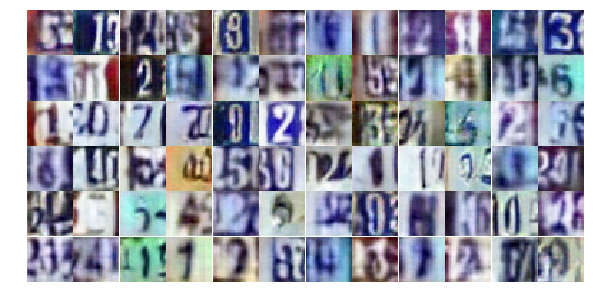

Epoch 15/25... Discriminator Loss: 0.7318... Generator Loss: 0.9808
Epoch 15/25... Discriminator Loss: 0.6683... Generator Loss: 1.6603
Epoch 15/25... Discriminator Loss: 0.7475... Generator Loss: 1.5306
Epoch 15/25... Discriminator Loss: 0.5312... Generator Loss: 1.1771
Epoch 15/25... Discriminator Loss: 0.9382... Generator Loss: 0.8057
Epoch 15/25... Discriminator Loss: 0.4491... Generator Loss: 1.8434
Epoch 15/25... Discriminator Loss: 1.0363... Generator Loss: 0.6322
Epoch 15/25... Discriminator Loss: 0.5857... Generator Loss: 1.6390
Epoch 15/25... Discriminator Loss: 0.7547... Generator Loss: 3.4208
Epoch 15/25... Discriminator Loss: 1.4641... Generator Loss: 0.4099


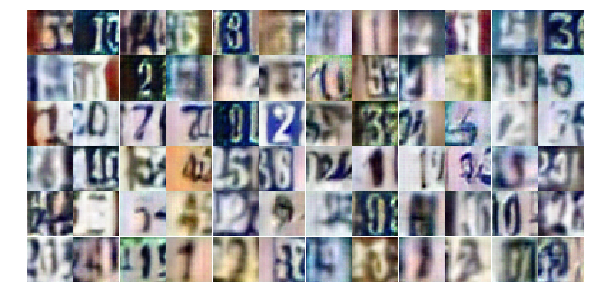

Epoch 15/25... Discriminator Loss: 0.9447... Generator Loss: 0.7832
Epoch 15/25... Discriminator Loss: 0.6599... Generator Loss: 1.1737
Epoch 15/25... Discriminator Loss: 0.4975... Generator Loss: 1.4765
Epoch 15/25... Discriminator Loss: 0.9040... Generator Loss: 0.7583
Epoch 15/25... Discriminator Loss: 1.0432... Generator Loss: 0.6900
Epoch 15/25... Discriminator Loss: 0.6017... Generator Loss: 1.1912
Epoch 15/25... Discriminator Loss: 0.9889... Generator Loss: 0.6528
Epoch 15/25... Discriminator Loss: 0.9136... Generator Loss: 0.7874
Epoch 15/25... Discriminator Loss: 0.8009... Generator Loss: 0.8386
Epoch 15/25... Discriminator Loss: 1.5413... Generator Loss: 0.3613


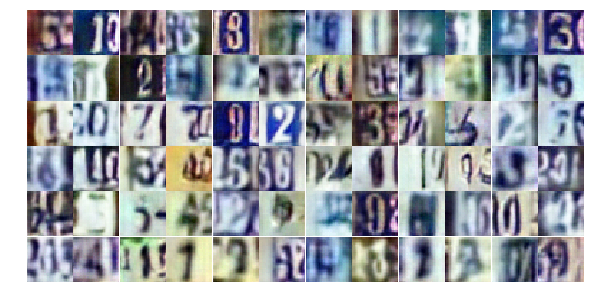

Epoch 15/25... Discriminator Loss: 0.7225... Generator Loss: 1.0235
Epoch 15/25... Discriminator Loss: 0.9834... Generator Loss: 0.6668
Epoch 15/25... Discriminator Loss: 0.4912... Generator Loss: 1.2131
Epoch 15/25... Discriminator Loss: 0.5544... Generator Loss: 1.5604
Epoch 15/25... Discriminator Loss: 0.6250... Generator Loss: 1.0760
Epoch 15/25... Discriminator Loss: 1.1367... Generator Loss: 2.5749
Epoch 15/25... Discriminator Loss: 0.7906... Generator Loss: 1.0404
Epoch 15/25... Discriminator Loss: 0.9209... Generator Loss: 0.7586
Epoch 15/25... Discriminator Loss: 0.5534... Generator Loss: 1.3791
Epoch 15/25... Discriminator Loss: 0.6844... Generator Loss: 1.0551


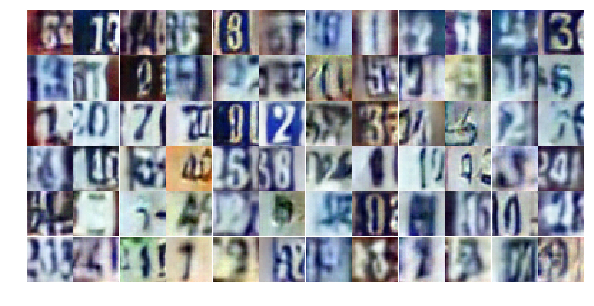

Epoch 15/25... Discriminator Loss: 0.7061... Generator Loss: 0.9235
Epoch 15/25... Discriminator Loss: 0.8653... Generator Loss: 0.8542
Epoch 15/25... Discriminator Loss: 0.9009... Generator Loss: 0.7574
Epoch 15/25... Discriminator Loss: 0.3785... Generator Loss: 1.6060
Epoch 15/25... Discriminator Loss: 0.6992... Generator Loss: 0.8924
Epoch 15/25... Discriminator Loss: 1.9489... Generator Loss: 0.2703
Epoch 15/25... Discriminator Loss: 0.7465... Generator Loss: 1.0481
Epoch 15/25... Discriminator Loss: 0.7843... Generator Loss: 1.0488
Epoch 15/25... Discriminator Loss: 0.7125... Generator Loss: 0.9300
Epoch 15/25... Discriminator Loss: 0.8279... Generator Loss: 0.8363


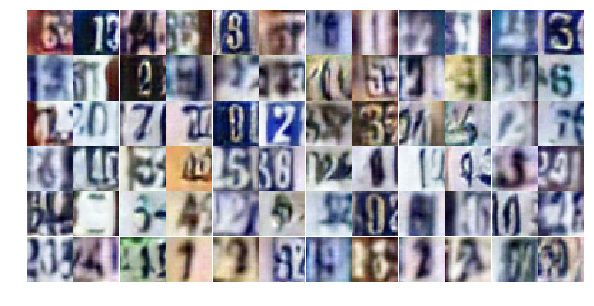

Epoch 15/25... Discriminator Loss: 1.1580... Generator Loss: 0.5390
Epoch 15/25... Discriminator Loss: 1.0283... Generator Loss: 0.6989
Epoch 15/25... Discriminator Loss: 0.5497... Generator Loss: 1.3347
Epoch 15/25... Discriminator Loss: 1.0556... Generator Loss: 0.6870
Epoch 15/25... Discriminator Loss: 0.5213... Generator Loss: 1.5639
Epoch 15/25... Discriminator Loss: 0.8896... Generator Loss: 0.8881
Epoch 15/25... Discriminator Loss: 1.0193... Generator Loss: 0.6482
Epoch 15/25... Discriminator Loss: 0.5404... Generator Loss: 1.3133
Epoch 15/25... Discriminator Loss: 1.5062... Generator Loss: 0.3634
Epoch 16/25... Discriminator Loss: 1.1527... Generator Loss: 0.5843


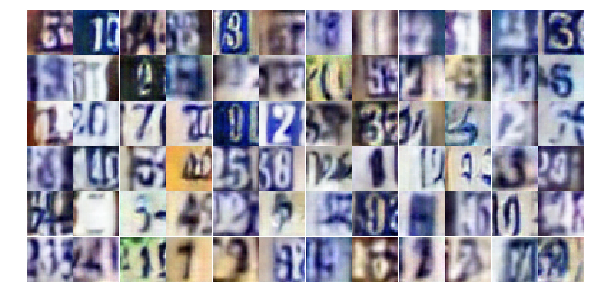

Epoch 16/25... Discriminator Loss: 0.6429... Generator Loss: 1.0308
Epoch 16/25... Discriminator Loss: 0.9379... Generator Loss: 0.7513
Epoch 16/25... Discriminator Loss: 0.8343... Generator Loss: 0.8068
Epoch 16/25... Discriminator Loss: 1.1336... Generator Loss: 0.6167
Epoch 16/25... Discriminator Loss: 0.7377... Generator Loss: 0.9809
Epoch 16/25... Discriminator Loss: 0.9311... Generator Loss: 0.7177
Epoch 16/25... Discriminator Loss: 1.4009... Generator Loss: 0.4057
Epoch 16/25... Discriminator Loss: 1.0126... Generator Loss: 0.6712
Epoch 16/25... Discriminator Loss: 0.9431... Generator Loss: 0.6803
Epoch 16/25... Discriminator Loss: 1.0803... Generator Loss: 0.6089


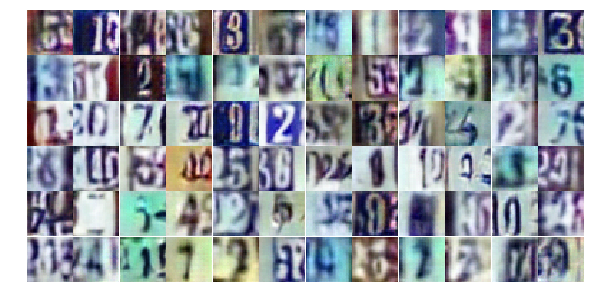

Epoch 16/25... Discriminator Loss: 1.2487... Generator Loss: 0.4680
Epoch 16/25... Discriminator Loss: 0.6092... Generator Loss: 1.1822
Epoch 16/25... Discriminator Loss: 1.1841... Generator Loss: 0.7304
Epoch 16/25... Discriminator Loss: 1.2097... Generator Loss: 0.6162
Epoch 16/25... Discriminator Loss: 0.6942... Generator Loss: 1.3670
Epoch 16/25... Discriminator Loss: 0.7768... Generator Loss: 0.9040
Epoch 16/25... Discriminator Loss: 1.8461... Generator Loss: 0.3018
Epoch 16/25... Discriminator Loss: 0.3857... Generator Loss: 1.6515
Epoch 16/25... Discriminator Loss: 0.5128... Generator Loss: 1.3244
Epoch 16/25... Discriminator Loss: 0.5006... Generator Loss: 1.3030


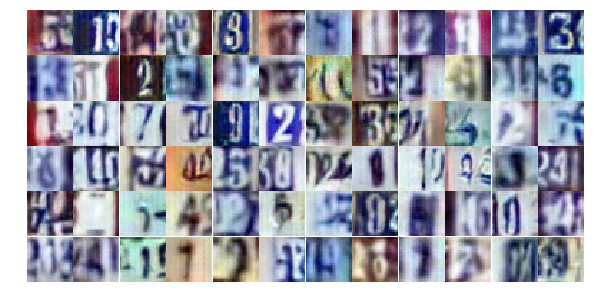

Epoch 16/25... Discriminator Loss: 0.8592... Generator Loss: 1.1615
Epoch 16/25... Discriminator Loss: 0.6672... Generator Loss: 2.0755
Epoch 16/25... Discriminator Loss: 0.7321... Generator Loss: 1.0548
Epoch 16/25... Discriminator Loss: 0.9758... Generator Loss: 0.6970
Epoch 16/25... Discriminator Loss: 0.7170... Generator Loss: 1.5670
Epoch 16/25... Discriminator Loss: 0.8282... Generator Loss: 0.8571
Epoch 16/25... Discriminator Loss: 0.8851... Generator Loss: 0.7715
Epoch 16/25... Discriminator Loss: 0.5086... Generator Loss: 1.4056
Epoch 16/25... Discriminator Loss: 0.8588... Generator Loss: 0.8677
Epoch 16/25... Discriminator Loss: 0.8781... Generator Loss: 0.7635


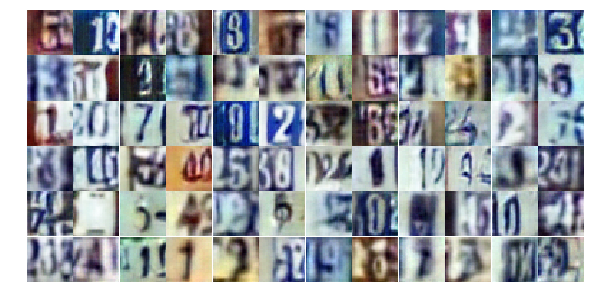

Epoch 16/25... Discriminator Loss: 0.6380... Generator Loss: 0.9817
Epoch 16/25... Discriminator Loss: 0.5554... Generator Loss: 1.2233
Epoch 16/25... Discriminator Loss: 0.5429... Generator Loss: 1.9352
Epoch 16/25... Discriminator Loss: 0.8245... Generator Loss: 1.1497
Epoch 16/25... Discriminator Loss: 0.9652... Generator Loss: 1.1851
Epoch 16/25... Discriminator Loss: 0.8216... Generator Loss: 1.2884
Epoch 16/25... Discriminator Loss: 0.9010... Generator Loss: 0.7850
Epoch 16/25... Discriminator Loss: 1.3443... Generator Loss: 0.4271
Epoch 16/25... Discriminator Loss: 0.9431... Generator Loss: 0.7418
Epoch 16/25... Discriminator Loss: 0.4169... Generator Loss: 1.9255


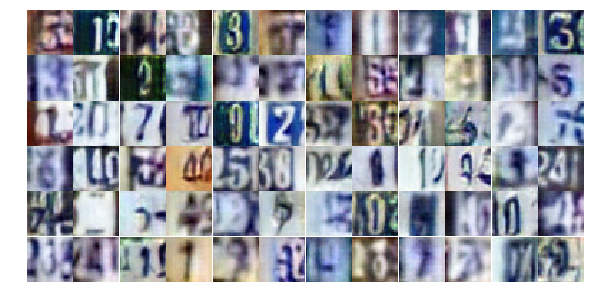

Epoch 16/25... Discriminator Loss: 0.4899... Generator Loss: 1.3939
Epoch 16/25... Discriminator Loss: 0.5868... Generator Loss: 1.4414
Epoch 16/25... Discriminator Loss: 1.4278... Generator Loss: 0.4082
Epoch 16/25... Discriminator Loss: 1.0788... Generator Loss: 1.3938
Epoch 16/25... Discriminator Loss: 1.0866... Generator Loss: 0.6194
Epoch 16/25... Discriminator Loss: 0.9558... Generator Loss: 0.7731
Epoch 16/25... Discriminator Loss: 0.5615... Generator Loss: 1.7863
Epoch 16/25... Discriminator Loss: 1.0925... Generator Loss: 0.5709
Epoch 16/25... Discriminator Loss: 0.7302... Generator Loss: 1.0349
Epoch 16/25... Discriminator Loss: 0.8939... Generator Loss: 0.7533


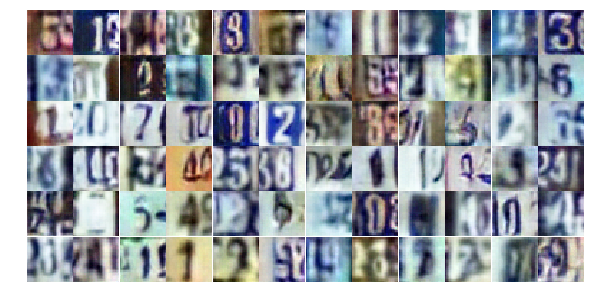

Epoch 16/25... Discriminator Loss: 1.1438... Generator Loss: 0.5897
Epoch 16/25... Discriminator Loss: 0.6073... Generator Loss: 1.2851
Epoch 16/25... Discriminator Loss: 1.6347... Generator Loss: 0.3948
Epoch 16/25... Discriminator Loss: 0.5887... Generator Loss: 1.9249
Epoch 16/25... Discriminator Loss: 0.5514... Generator Loss: 1.2215
Epoch 16/25... Discriminator Loss: 1.0883... Generator Loss: 0.6299
Epoch 17/25... Discriminator Loss: 0.5896... Generator Loss: 1.5690
Epoch 17/25... Discriminator Loss: 0.9165... Generator Loss: 0.8459
Epoch 17/25... Discriminator Loss: 0.6197... Generator Loss: 1.8744
Epoch 17/25... Discriminator Loss: 0.8057... Generator Loss: 0.8973


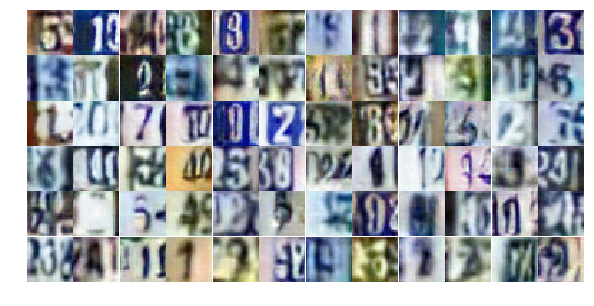

Epoch 17/25... Discriminator Loss: 0.5036... Generator Loss: 1.6805
Epoch 17/25... Discriminator Loss: 1.1647... Generator Loss: 0.5877
Epoch 17/25... Discriminator Loss: 0.8967... Generator Loss: 0.8035
Epoch 17/25... Discriminator Loss: 0.6601... Generator Loss: 0.9631
Epoch 17/25... Discriminator Loss: 1.1173... Generator Loss: 0.6132
Epoch 17/25... Discriminator Loss: 1.0156... Generator Loss: 0.6780
Epoch 17/25... Discriminator Loss: 0.8370... Generator Loss: 0.8202
Epoch 17/25... Discriminator Loss: 0.6097... Generator Loss: 1.1885
Epoch 17/25... Discriminator Loss: 0.4972... Generator Loss: 1.4466
Epoch 17/25... Discriminator Loss: 0.5278... Generator Loss: 1.6182


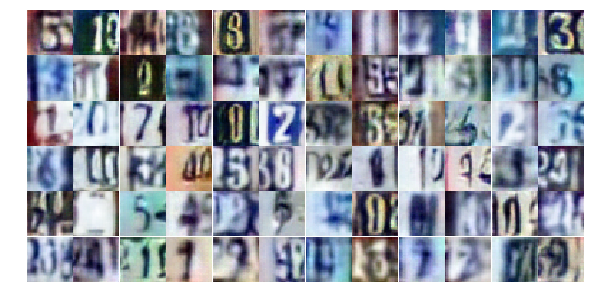

Epoch 17/25... Discriminator Loss: 1.4394... Generator Loss: 0.3785
Epoch 17/25... Discriminator Loss: 0.5781... Generator Loss: 2.4801
Epoch 17/25... Discriminator Loss: 0.5525... Generator Loss: 1.4144
Epoch 17/25... Discriminator Loss: 0.9035... Generator Loss: 0.8728
Epoch 17/25... Discriminator Loss: 0.6154... Generator Loss: 1.1141
Epoch 17/25... Discriminator Loss: 0.7610... Generator Loss: 0.8963
Epoch 17/25... Discriminator Loss: 0.5838... Generator Loss: 1.6956
Epoch 17/25... Discriminator Loss: 0.5275... Generator Loss: 1.2087
Epoch 17/25... Discriminator Loss: 0.6288... Generator Loss: 1.0699
Epoch 17/25... Discriminator Loss: 0.5311... Generator Loss: 1.1356


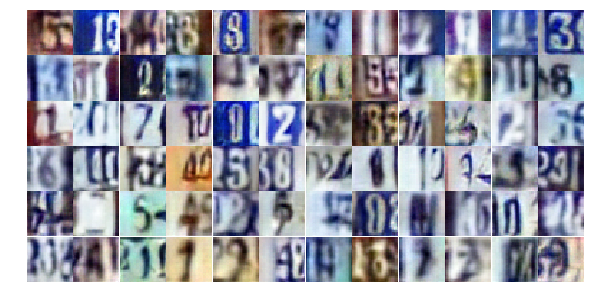

Epoch 17/25... Discriminator Loss: 1.3994... Generator Loss: 0.3886
Epoch 17/25... Discriminator Loss: 0.5588... Generator Loss: 1.3537
Epoch 17/25... Discriminator Loss: 0.4354... Generator Loss: 1.5739
Epoch 17/25... Discriminator Loss: 1.4626... Generator Loss: 0.3805
Epoch 17/25... Discriminator Loss: 0.9918... Generator Loss: 0.7045
Epoch 17/25... Discriminator Loss: 0.5260... Generator Loss: 1.3147
Epoch 17/25... Discriminator Loss: 0.4698... Generator Loss: 1.3959
Epoch 17/25... Discriminator Loss: 0.7376... Generator Loss: 0.8817
Epoch 17/25... Discriminator Loss: 0.9153... Generator Loss: 0.7523
Epoch 17/25... Discriminator Loss: 0.5916... Generator Loss: 1.1162


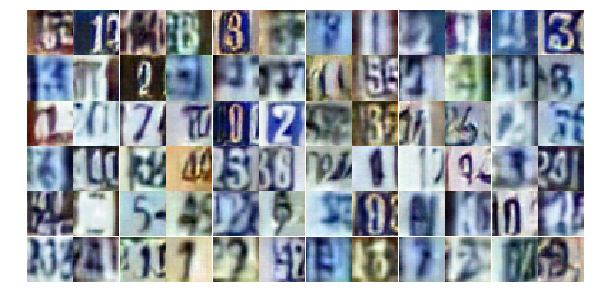

Epoch 17/25... Discriminator Loss: 1.1406... Generator Loss: 0.5753
Epoch 17/25... Discriminator Loss: 1.3362... Generator Loss: 1.5728
Epoch 17/25... Discriminator Loss: 0.6168... Generator Loss: 1.3582
Epoch 17/25... Discriminator Loss: 0.6066... Generator Loss: 1.5220
Epoch 17/25... Discriminator Loss: 0.8918... Generator Loss: 0.9526
Epoch 17/25... Discriminator Loss: 0.6424... Generator Loss: 1.1468
Epoch 17/25... Discriminator Loss: 0.8389... Generator Loss: 0.8832
Epoch 17/25... Discriminator Loss: 0.8087... Generator Loss: 0.9445
Epoch 17/25... Discriminator Loss: 0.3852... Generator Loss: 1.8178
Epoch 17/25... Discriminator Loss: 0.9962... Generator Loss: 0.6651


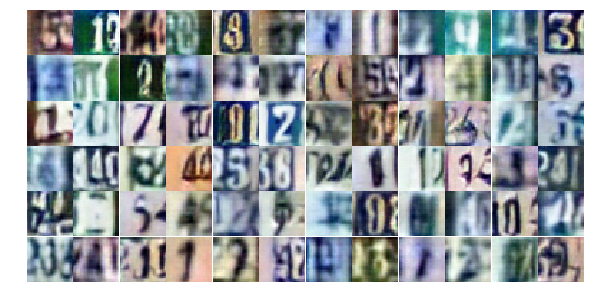

Epoch 17/25... Discriminator Loss: 0.9850... Generator Loss: 1.1572
Epoch 17/25... Discriminator Loss: 0.2733... Generator Loss: 2.0217
Epoch 17/25... Discriminator Loss: 1.1876... Generator Loss: 0.5933
Epoch 17/25... Discriminator Loss: 0.4901... Generator Loss: 1.3996
Epoch 17/25... Discriminator Loss: 0.7375... Generator Loss: 0.9416
Epoch 17/25... Discriminator Loss: 0.9125... Generator Loss: 0.7622
Epoch 17/25... Discriminator Loss: 1.1852... Generator Loss: 0.5517
Epoch 17/25... Discriminator Loss: 0.9329... Generator Loss: 0.7192
Epoch 17/25... Discriminator Loss: 0.6177... Generator Loss: 1.4464
Epoch 17/25... Discriminator Loss: 1.8722... Generator Loss: 0.2783


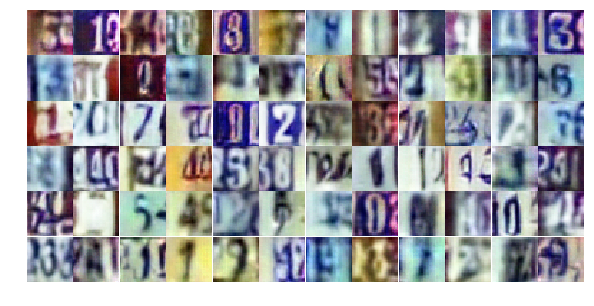

Epoch 17/25... Discriminator Loss: 2.8187... Generator Loss: 3.3182
Epoch 17/25... Discriminator Loss: 1.0076... Generator Loss: 1.0363
Epoch 17/25... Discriminator Loss: 0.7420... Generator Loss: 0.8676
Epoch 17/25... Discriminator Loss: 0.8003... Generator Loss: 0.9482
Epoch 18/25... Discriminator Loss: 0.9218... Generator Loss: 0.7725
Epoch 18/25... Discriminator Loss: 0.8613... Generator Loss: 0.7662
Epoch 18/25... Discriminator Loss: 0.9479... Generator Loss: 0.7611
Epoch 18/25... Discriminator Loss: 0.6068... Generator Loss: 1.1326
Epoch 18/25... Discriminator Loss: 1.3543... Generator Loss: 0.4316
Epoch 18/25... Discriminator Loss: 0.7385... Generator Loss: 0.9362


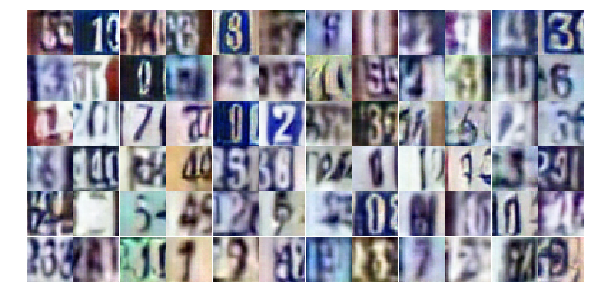

Epoch 18/25... Discriminator Loss: 0.4515... Generator Loss: 1.7079
Epoch 18/25... Discriminator Loss: 1.0591... Generator Loss: 0.6551
Epoch 18/25... Discriminator Loss: 0.7925... Generator Loss: 0.8241
Epoch 18/25... Discriminator Loss: 0.5129... Generator Loss: 1.6164
Epoch 18/25... Discriminator Loss: 0.7229... Generator Loss: 0.9406
Epoch 18/25... Discriminator Loss: 1.1980... Generator Loss: 0.5405
Epoch 18/25... Discriminator Loss: 0.6188... Generator Loss: 1.0512
Epoch 18/25... Discriminator Loss: 0.7937... Generator Loss: 0.8830
Epoch 18/25... Discriminator Loss: 0.8430... Generator Loss: 0.8369
Epoch 18/25... Discriminator Loss: 0.3707... Generator Loss: 1.7799


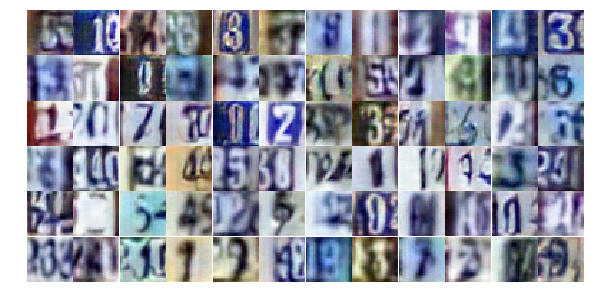

Epoch 18/25... Discriminator Loss: 0.9510... Generator Loss: 0.8909
Epoch 18/25... Discriminator Loss: 0.9026... Generator Loss: 0.7269
Epoch 18/25... Discriminator Loss: 1.0294... Generator Loss: 0.7744
Epoch 18/25... Discriminator Loss: 0.6065... Generator Loss: 1.1228
Epoch 18/25... Discriminator Loss: 0.4834... Generator Loss: 1.3706
Epoch 18/25... Discriminator Loss: 0.9417... Generator Loss: 0.7539
Epoch 18/25... Discriminator Loss: 0.7460... Generator Loss: 1.2873
Epoch 18/25... Discriminator Loss: 0.8969... Generator Loss: 0.7116
Epoch 18/25... Discriminator Loss: 0.7814... Generator Loss: 0.8818
Epoch 18/25... Discriminator Loss: 0.6421... Generator Loss: 1.1105


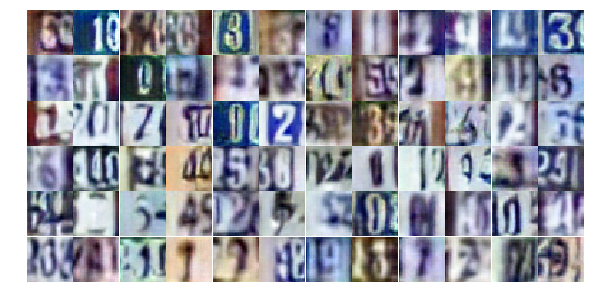

Epoch 18/25... Discriminator Loss: 0.5450... Generator Loss: 1.2335
Epoch 18/25... Discriminator Loss: 0.7003... Generator Loss: 1.4899
Epoch 18/25... Discriminator Loss: 1.5749... Generator Loss: 0.3770
Epoch 18/25... Discriminator Loss: 0.9124... Generator Loss: 0.9056
Epoch 18/25... Discriminator Loss: 0.8499... Generator Loss: 0.8357
Epoch 18/25... Discriminator Loss: 0.6011... Generator Loss: 1.1969
Epoch 18/25... Discriminator Loss: 1.2199... Generator Loss: 0.7023
Epoch 18/25... Discriminator Loss: 0.5229... Generator Loss: 1.4683
Epoch 18/25... Discriminator Loss: 0.7292... Generator Loss: 0.8705
Epoch 18/25... Discriminator Loss: 0.7831... Generator Loss: 0.9320


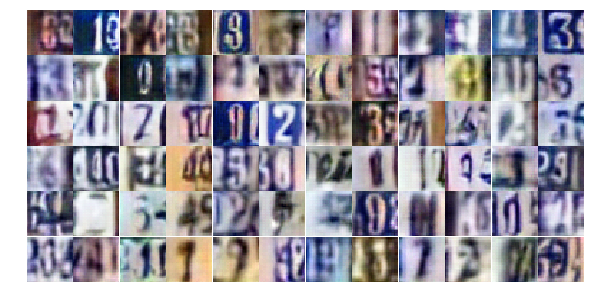

Epoch 18/25... Discriminator Loss: 0.5023... Generator Loss: 1.8057
Epoch 18/25... Discriminator Loss: 0.7192... Generator Loss: 0.9229
Epoch 18/25... Discriminator Loss: 0.7505... Generator Loss: 0.8849
Epoch 18/25... Discriminator Loss: 0.5369... Generator Loss: 1.5198
Epoch 18/25... Discriminator Loss: 0.7323... Generator Loss: 1.0181
Epoch 18/25... Discriminator Loss: 0.6969... Generator Loss: 0.9653
Epoch 18/25... Discriminator Loss: 0.7971... Generator Loss: 0.8238
Epoch 18/25... Discriminator Loss: 2.6234... Generator Loss: 4.1715
Epoch 18/25... Discriminator Loss: 1.1046... Generator Loss: 0.7172
Epoch 18/25... Discriminator Loss: 0.5629... Generator Loss: 1.2756


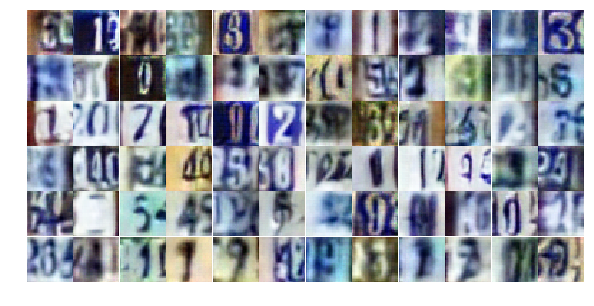

Epoch 18/25... Discriminator Loss: 1.8741... Generator Loss: 0.2529
Epoch 18/25... Discriminator Loss: 1.2608... Generator Loss: 0.4835
Epoch 18/25... Discriminator Loss: 0.8059... Generator Loss: 1.0145
Epoch 18/25... Discriminator Loss: 0.8350... Generator Loss: 0.9248
Epoch 18/25... Discriminator Loss: 1.1193... Generator Loss: 0.5708
Epoch 18/25... Discriminator Loss: 0.7789... Generator Loss: 0.9025
Epoch 18/25... Discriminator Loss: 0.6762... Generator Loss: 0.9983
Epoch 18/25... Discriminator Loss: 0.4056... Generator Loss: 1.5710
Epoch 18/25... Discriminator Loss: 1.3517... Generator Loss: 0.4308
Epoch 18/25... Discriminator Loss: 1.0538... Generator Loss: 0.5628


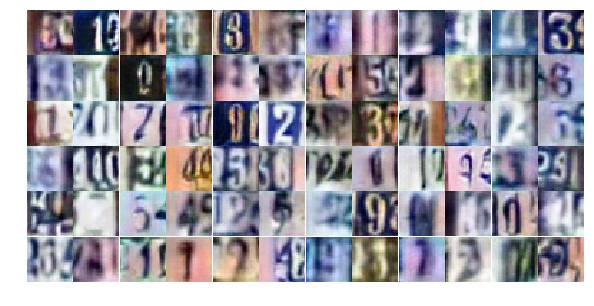

Epoch 18/25... Discriminator Loss: 0.6732... Generator Loss: 1.6019
Epoch 19/25... Discriminator Loss: 1.1147... Generator Loss: 0.5812
Epoch 19/25... Discriminator Loss: 1.0507... Generator Loss: 0.6044
Epoch 19/25... Discriminator Loss: 0.9256... Generator Loss: 0.7469
Epoch 19/25... Discriminator Loss: 0.7317... Generator Loss: 0.9534
Epoch 19/25... Discriminator Loss: 1.0164... Generator Loss: 0.7193
Epoch 19/25... Discriminator Loss: 0.6519... Generator Loss: 1.4855
Epoch 19/25... Discriminator Loss: 0.8292... Generator Loss: 1.0206
Epoch 19/25... Discriminator Loss: 0.7255... Generator Loss: 1.2312
Epoch 19/25... Discriminator Loss: 1.1894... Generator Loss: 0.5212


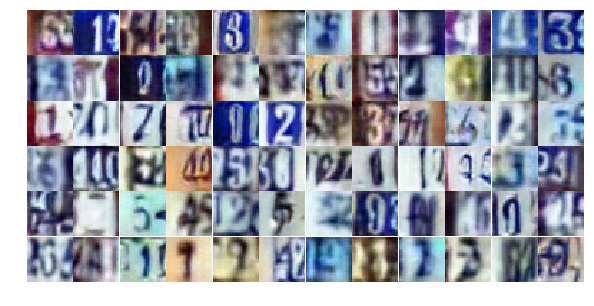

Epoch 19/25... Discriminator Loss: 0.6379... Generator Loss: 1.1249
Epoch 19/25... Discriminator Loss: 0.9839... Generator Loss: 0.7225
Epoch 19/25... Discriminator Loss: 0.7929... Generator Loss: 0.9567
Epoch 19/25... Discriminator Loss: 0.9130... Generator Loss: 0.6730
Epoch 19/25... Discriminator Loss: 1.0680... Generator Loss: 0.6128
Epoch 19/25... Discriminator Loss: 0.6882... Generator Loss: 1.1256
Epoch 19/25... Discriminator Loss: 0.9514... Generator Loss: 0.6502
Epoch 19/25... Discriminator Loss: 0.7924... Generator Loss: 0.8344
Epoch 19/25... Discriminator Loss: 0.9386... Generator Loss: 1.2397
Epoch 19/25... Discriminator Loss: 1.4030... Generator Loss: 0.4282


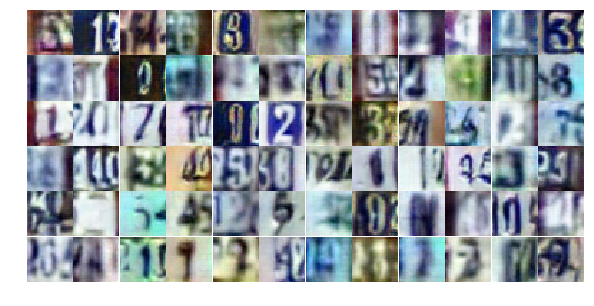

Epoch 19/25... Discriminator Loss: 0.6456... Generator Loss: 1.1773
Epoch 19/25... Discriminator Loss: 0.9912... Generator Loss: 0.7178
Epoch 19/25... Discriminator Loss: 1.3667... Generator Loss: 0.4379
Epoch 19/25... Discriminator Loss: 0.7683... Generator Loss: 0.9758
Epoch 19/25... Discriminator Loss: 0.9941... Generator Loss: 0.7225
Epoch 19/25... Discriminator Loss: 0.8991... Generator Loss: 0.7773
Epoch 19/25... Discriminator Loss: 0.7703... Generator Loss: 0.8901
Epoch 19/25... Discriminator Loss: 0.5192... Generator Loss: 1.2732
Epoch 19/25... Discriminator Loss: 0.8387... Generator Loss: 0.8262
Epoch 19/25... Discriminator Loss: 1.1033... Generator Loss: 0.5536


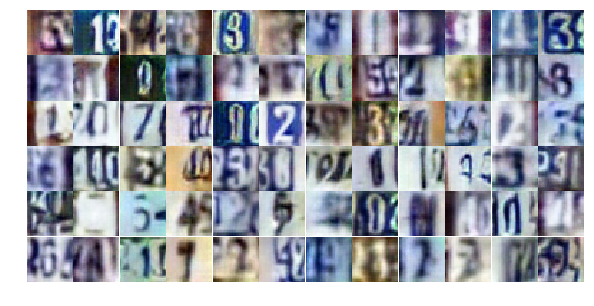

Epoch 19/25... Discriminator Loss: 0.7166... Generator Loss: 0.9737
Epoch 19/25... Discriminator Loss: 0.7558... Generator Loss: 0.8869
Epoch 19/25... Discriminator Loss: 0.8422... Generator Loss: 0.8143
Epoch 19/25... Discriminator Loss: 0.5163... Generator Loss: 1.3513
Epoch 19/25... Discriminator Loss: 0.4615... Generator Loss: 1.5901
Epoch 19/25... Discriminator Loss: 1.7319... Generator Loss: 0.3901
Epoch 19/25... Discriminator Loss: 0.8859... Generator Loss: 0.7348
Epoch 19/25... Discriminator Loss: 0.6518... Generator Loss: 1.1504
Epoch 19/25... Discriminator Loss: 0.8857... Generator Loss: 0.7801
Epoch 19/25... Discriminator Loss: 0.5183... Generator Loss: 1.4652


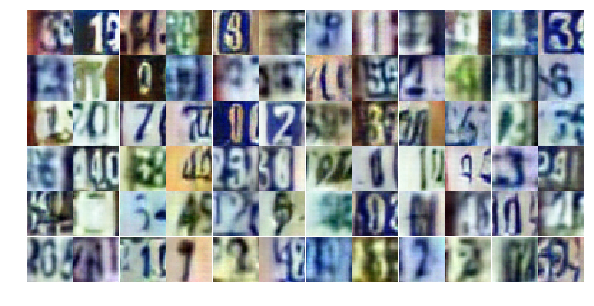

Epoch 19/25... Discriminator Loss: 0.6474... Generator Loss: 0.9789
Epoch 19/25... Discriminator Loss: 0.7010... Generator Loss: 1.1394
Epoch 19/25... Discriminator Loss: 1.2014... Generator Loss: 0.4868
Epoch 19/25... Discriminator Loss: 0.5638... Generator Loss: 1.2433
Epoch 19/25... Discriminator Loss: 0.9152... Generator Loss: 0.7330
Epoch 19/25... Discriminator Loss: 0.9154... Generator Loss: 2.5717
Epoch 19/25... Discriminator Loss: 0.8683... Generator Loss: 1.0127
Epoch 19/25... Discriminator Loss: 0.5255... Generator Loss: 1.3107
Epoch 19/25... Discriminator Loss: 0.5893... Generator Loss: 1.2723
Epoch 19/25... Discriminator Loss: 0.6660... Generator Loss: 1.1590


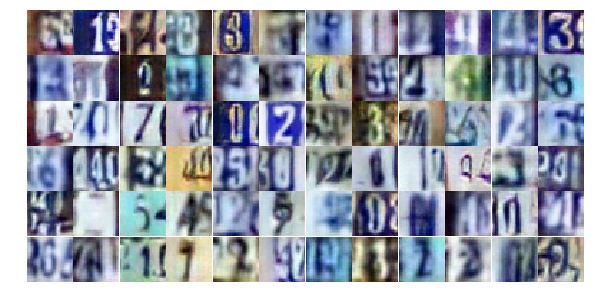

Epoch 19/25... Discriminator Loss: 0.9045... Generator Loss: 0.7601
Epoch 19/25... Discriminator Loss: 0.7377... Generator Loss: 1.1240
Epoch 19/25... Discriminator Loss: 0.6007... Generator Loss: 1.5191
Epoch 19/25... Discriminator Loss: 1.4761... Generator Loss: 0.3979
Epoch 19/25... Discriminator Loss: 0.9889... Generator Loss: 0.7778
Epoch 19/25... Discriminator Loss: 0.7266... Generator Loss: 1.1046
Epoch 19/25... Discriminator Loss: 1.0008... Generator Loss: 0.7463
Epoch 19/25... Discriminator Loss: 1.1203... Generator Loss: 0.5828
Epoch 20/25... Discriminator Loss: 0.7505... Generator Loss: 1.0474
Epoch 20/25... Discriminator Loss: 0.6064... Generator Loss: 1.1090


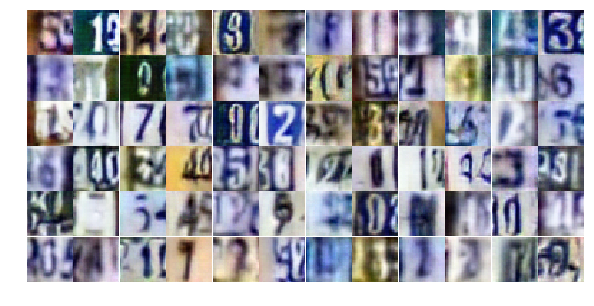

Epoch 20/25... Discriminator Loss: 0.6624... Generator Loss: 1.0192
Epoch 20/25... Discriminator Loss: 0.6648... Generator Loss: 1.1684
Epoch 20/25... Discriminator Loss: 1.0241... Generator Loss: 0.6267
Epoch 20/25... Discriminator Loss: 0.8669... Generator Loss: 0.8583
Epoch 20/25... Discriminator Loss: 1.0563... Generator Loss: 0.6395
Epoch 20/25... Discriminator Loss: 0.6920... Generator Loss: 1.1775
Epoch 20/25... Discriminator Loss: 0.5524... Generator Loss: 1.3346
Epoch 20/25... Discriminator Loss: 0.7172... Generator Loss: 1.0888
Epoch 20/25... Discriminator Loss: 0.6463... Generator Loss: 1.4054
Epoch 20/25... Discriminator Loss: 0.7363... Generator Loss: 0.8277


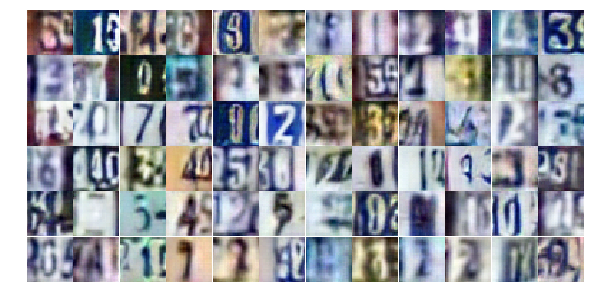

Epoch 20/25... Discriminator Loss: 1.2897... Generator Loss: 0.5236
Epoch 20/25... Discriminator Loss: 1.2194... Generator Loss: 0.5617
Epoch 20/25... Discriminator Loss: 0.8879... Generator Loss: 0.8378
Epoch 20/25... Discriminator Loss: 0.7845... Generator Loss: 1.2393
Epoch 20/25... Discriminator Loss: 0.7896... Generator Loss: 0.8806
Epoch 20/25... Discriminator Loss: 3.3221... Generator Loss: 5.3308
Epoch 20/25... Discriminator Loss: 1.3078... Generator Loss: 0.6337
Epoch 20/25... Discriminator Loss: 0.7534... Generator Loss: 0.9942
Epoch 20/25... Discriminator Loss: 0.7871... Generator Loss: 0.9543
Epoch 20/25... Discriminator Loss: 0.8336... Generator Loss: 0.9168


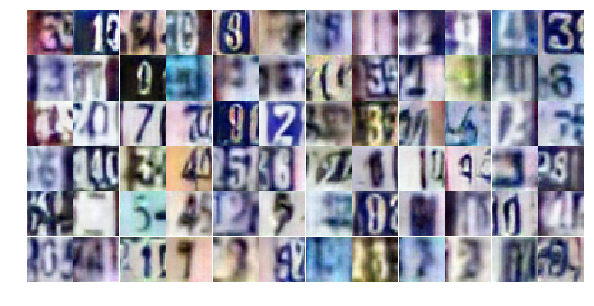

Epoch 20/25... Discriminator Loss: 0.6388... Generator Loss: 1.0908
Epoch 20/25... Discriminator Loss: 0.8924... Generator Loss: 0.8447
Epoch 20/25... Discriminator Loss: 0.5636... Generator Loss: 1.1534
Epoch 20/25... Discriminator Loss: 1.3662... Generator Loss: 0.4458
Epoch 20/25... Discriminator Loss: 1.0328... Generator Loss: 0.7802
Epoch 20/25... Discriminator Loss: 0.5715... Generator Loss: 1.3339
Epoch 20/25... Discriminator Loss: 0.5824... Generator Loss: 1.2327
Epoch 20/25... Discriminator Loss: 1.7229... Generator Loss: 0.3169
Epoch 20/25... Discriminator Loss: 1.2728... Generator Loss: 0.5126
Epoch 20/25... Discriminator Loss: 0.5475... Generator Loss: 1.2271


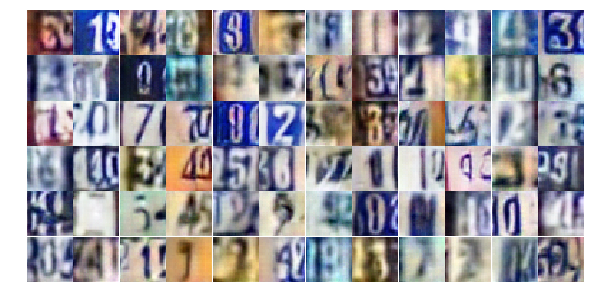

Epoch 20/25... Discriminator Loss: 0.6657... Generator Loss: 1.3566
Epoch 20/25... Discriminator Loss: 0.6421... Generator Loss: 1.0720
Epoch 20/25... Discriminator Loss: 1.5578... Generator Loss: 0.4185
Epoch 20/25... Discriminator Loss: 1.2711... Generator Loss: 2.0436
Epoch 20/25... Discriminator Loss: 0.7184... Generator Loss: 1.1556
Epoch 20/25... Discriminator Loss: 0.7569... Generator Loss: 1.0028
Epoch 20/25... Discriminator Loss: 0.7222... Generator Loss: 2.1925
Epoch 20/25... Discriminator Loss: 0.9123... Generator Loss: 0.8119
Epoch 20/25... Discriminator Loss: 0.7175... Generator Loss: 1.0292
Epoch 20/25... Discriminator Loss: 1.1336... Generator Loss: 0.5511


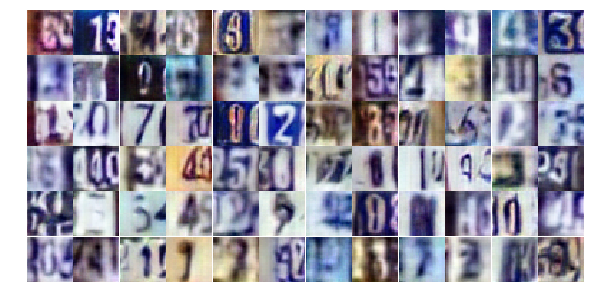

Epoch 20/25... Discriminator Loss: 1.0889... Generator Loss: 0.5916
Epoch 20/25... Discriminator Loss: 0.7957... Generator Loss: 0.8582
Epoch 20/25... Discriminator Loss: 1.0121... Generator Loss: 2.5799
Epoch 20/25... Discriminator Loss: 0.5268... Generator Loss: 1.4421
Epoch 20/25... Discriminator Loss: 0.5825... Generator Loss: 1.4393
Epoch 20/25... Discriminator Loss: 1.2320... Generator Loss: 0.5071
Epoch 20/25... Discriminator Loss: 0.7732... Generator Loss: 0.9318
Epoch 20/25... Discriminator Loss: 0.4157... Generator Loss: 1.8430
Epoch 20/25... Discriminator Loss: 0.7364... Generator Loss: 1.4935
Epoch 20/25... Discriminator Loss: 0.7922... Generator Loss: 0.8736


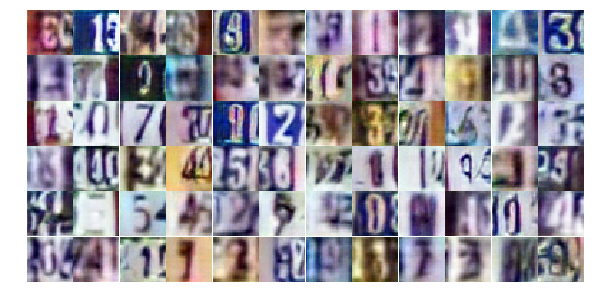

Epoch 20/25... Discriminator Loss: 0.5035... Generator Loss: 1.4023
Epoch 20/25... Discriminator Loss: 0.7947... Generator Loss: 2.3869
Epoch 20/25... Discriminator Loss: 0.4774... Generator Loss: 1.4875
Epoch 20/25... Discriminator Loss: 0.8930... Generator Loss: 0.8646
Epoch 20/25... Discriminator Loss: 0.5332... Generator Loss: 1.6782
Epoch 20/25... Discriminator Loss: 1.1816... Generator Loss: 0.4972
Epoch 21/25... Discriminator Loss: 1.0185... Generator Loss: 0.7240
Epoch 21/25... Discriminator Loss: 0.6826... Generator Loss: 1.0975
Epoch 21/25... Discriminator Loss: 1.1312... Generator Loss: 0.5663
Epoch 21/25... Discriminator Loss: 1.3659... Generator Loss: 0.4362


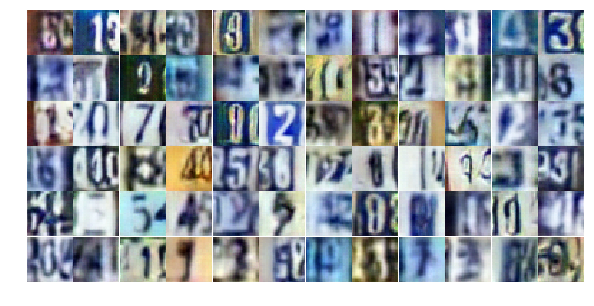

Epoch 21/25... Discriminator Loss: 0.9985... Generator Loss: 0.6736
Epoch 21/25... Discriminator Loss: 1.7064... Generator Loss: 0.3245
Epoch 21/25... Discriminator Loss: 0.4061... Generator Loss: 1.8281
Epoch 21/25... Discriminator Loss: 0.3791... Generator Loss: 1.7094
Epoch 21/25... Discriminator Loss: 0.7166... Generator Loss: 1.1571
Epoch 21/25... Discriminator Loss: 0.5000... Generator Loss: 1.4995
Epoch 21/25... Discriminator Loss: 0.7790... Generator Loss: 0.9166
Epoch 21/25... Discriminator Loss: 1.2692... Generator Loss: 0.4675
Epoch 21/25... Discriminator Loss: 0.7078... Generator Loss: 1.1060
Epoch 21/25... Discriminator Loss: 1.2428... Generator Loss: 0.4854


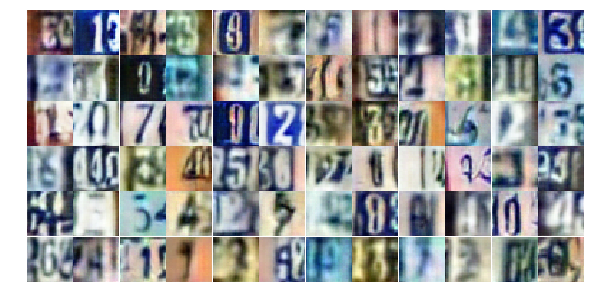

Epoch 21/25... Discriminator Loss: 0.5227... Generator Loss: 1.3277
Epoch 21/25... Discriminator Loss: 0.7849... Generator Loss: 0.8568
Epoch 21/25... Discriminator Loss: 1.3576... Generator Loss: 0.9263
Epoch 21/25... Discriminator Loss: 1.3378... Generator Loss: 0.5765
Epoch 21/25... Discriminator Loss: 0.9439... Generator Loss: 0.7537
Epoch 21/25... Discriminator Loss: 0.9158... Generator Loss: 0.8029
Epoch 21/25... Discriminator Loss: 0.8848... Generator Loss: 0.7897
Epoch 21/25... Discriminator Loss: 0.3649... Generator Loss: 2.1078
Epoch 21/25... Discriminator Loss: 0.5979... Generator Loss: 1.1047
Epoch 21/25... Discriminator Loss: 0.7598... Generator Loss: 0.9555


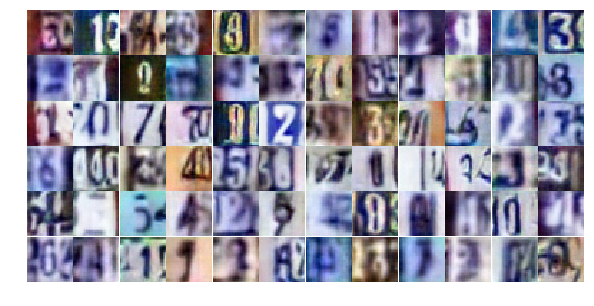

Epoch 21/25... Discriminator Loss: 1.4880... Generator Loss: 0.3890
Epoch 21/25... Discriminator Loss: 0.4579... Generator Loss: 1.4867
Epoch 21/25... Discriminator Loss: 0.9946... Generator Loss: 0.6560
Epoch 21/25... Discriminator Loss: 0.8253... Generator Loss: 0.8368
Epoch 21/25... Discriminator Loss: 0.6669... Generator Loss: 1.0999
Epoch 21/25... Discriminator Loss: 0.8407... Generator Loss: 1.1237
Epoch 21/25... Discriminator Loss: 0.6673... Generator Loss: 0.9475
Epoch 21/25... Discriminator Loss: 1.1319... Generator Loss: 0.5780
Epoch 21/25... Discriminator Loss: 1.0500... Generator Loss: 0.6342
Epoch 21/25... Discriminator Loss: 1.1200... Generator Loss: 0.6159


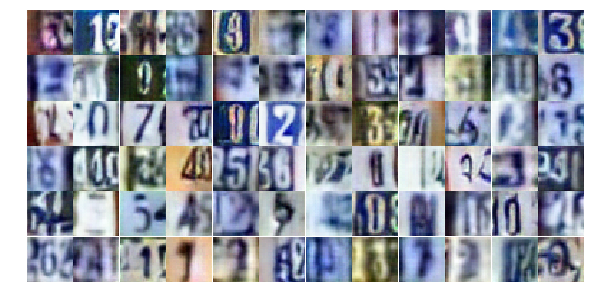

Epoch 21/25... Discriminator Loss: 1.1762... Generator Loss: 0.5774
Epoch 21/25... Discriminator Loss: 0.7190... Generator Loss: 1.0067
Epoch 21/25... Discriminator Loss: 1.2346... Generator Loss: 0.4693
Epoch 21/25... Discriminator Loss: 0.4712... Generator Loss: 1.5364
Epoch 21/25... Discriminator Loss: 0.7093... Generator Loss: 1.0347
Epoch 21/25... Discriminator Loss: 0.7484... Generator Loss: 1.0083
Epoch 21/25... Discriminator Loss: 0.7941... Generator Loss: 1.1882
Epoch 21/25... Discriminator Loss: 0.8390... Generator Loss: 0.8522
Epoch 21/25... Discriminator Loss: 0.9075... Generator Loss: 0.7044
Epoch 21/25... Discriminator Loss: 0.3323... Generator Loss: 1.9660


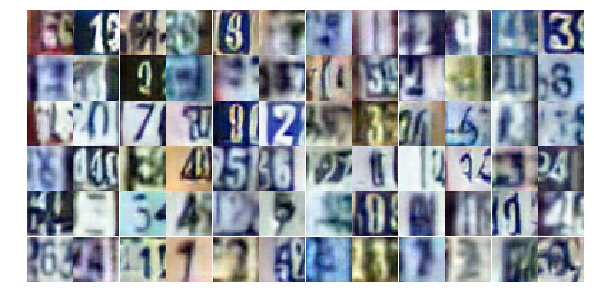

Epoch 21/25... Discriminator Loss: 0.6972... Generator Loss: 1.0343
Epoch 21/25... Discriminator Loss: 2.3183... Generator Loss: 0.2283
Epoch 21/25... Discriminator Loss: 0.8231... Generator Loss: 0.9712
Epoch 21/25... Discriminator Loss: 1.0390... Generator Loss: 0.8744
Epoch 21/25... Discriminator Loss: 0.4750... Generator Loss: 1.6351
Epoch 21/25... Discriminator Loss: 0.7779... Generator Loss: 0.9862
Epoch 21/25... Discriminator Loss: 1.1096... Generator Loss: 0.6862
Epoch 21/25... Discriminator Loss: 1.2188... Generator Loss: 0.5294
Epoch 21/25... Discriminator Loss: 1.1016... Generator Loss: 0.6500
Epoch 21/25... Discriminator Loss: 0.5469... Generator Loss: 1.9085


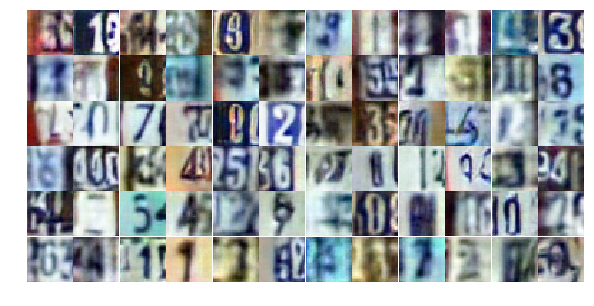

Epoch 21/25... Discriminator Loss: 0.6433... Generator Loss: 1.6154
Epoch 21/25... Discriminator Loss: 0.7318... Generator Loss: 0.9810
Epoch 21/25... Discriminator Loss: 0.7240... Generator Loss: 1.1187
Epoch 22/25... Discriminator Loss: 0.5864... Generator Loss: 1.5058
Epoch 22/25... Discriminator Loss: 1.0765... Generator Loss: 0.6829
Epoch 22/25... Discriminator Loss: 0.8278... Generator Loss: 0.8739
Epoch 22/25... Discriminator Loss: 0.5675... Generator Loss: 1.3429
Epoch 22/25... Discriminator Loss: 0.4815... Generator Loss: 1.4284
Epoch 22/25... Discriminator Loss: 1.3205... Generator Loss: 0.4858
Epoch 22/25... Discriminator Loss: 0.8364... Generator Loss: 0.8239


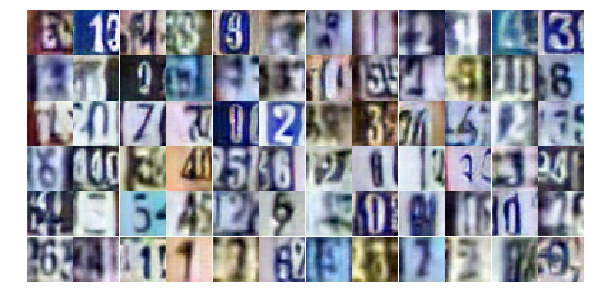

Epoch 22/25... Discriminator Loss: 0.7505... Generator Loss: 0.9863
Epoch 22/25... Discriminator Loss: 0.7958... Generator Loss: 1.4266
Epoch 22/25... Discriminator Loss: 1.2433... Generator Loss: 0.4938
Epoch 22/25... Discriminator Loss: 0.7597... Generator Loss: 0.9621
Epoch 22/25... Discriminator Loss: 1.0377... Generator Loss: 0.7797
Epoch 22/25... Discriminator Loss: 0.4899... Generator Loss: 1.8002
Epoch 22/25... Discriminator Loss: 0.5837... Generator Loss: 1.6512
Epoch 22/25... Discriminator Loss: 0.4687... Generator Loss: 1.7110
Epoch 22/25... Discriminator Loss: 1.5472... Generator Loss: 0.4426
Epoch 22/25... Discriminator Loss: 1.8281... Generator Loss: 0.3360


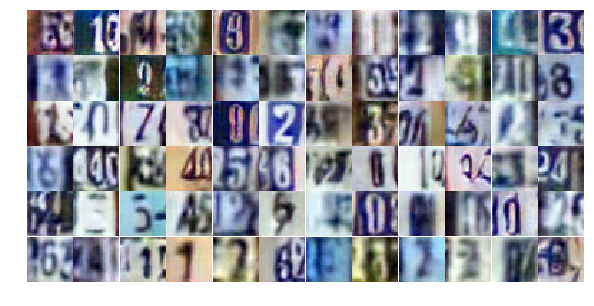

Epoch 22/25... Discriminator Loss: 0.5460... Generator Loss: 1.7395
Epoch 22/25... Discriminator Loss: 0.6640... Generator Loss: 1.1489
Epoch 22/25... Discriminator Loss: 0.8870... Generator Loss: 0.7541
Epoch 22/25... Discriminator Loss: 0.4829... Generator Loss: 1.5210
Epoch 22/25... Discriminator Loss: 0.7916... Generator Loss: 0.8457
Epoch 22/25... Discriminator Loss: 1.1597... Generator Loss: 0.5139
Epoch 22/25... Discriminator Loss: 0.4864... Generator Loss: 1.4693
Epoch 22/25... Discriminator Loss: 0.4633... Generator Loss: 1.7841
Epoch 22/25... Discriminator Loss: 0.5441... Generator Loss: 1.4729
Epoch 22/25... Discriminator Loss: 0.9118... Generator Loss: 0.7323


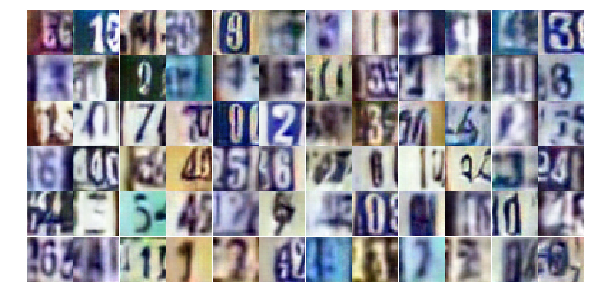

Epoch 22/25... Discriminator Loss: 0.5436... Generator Loss: 1.2571
Epoch 22/25... Discriminator Loss: 0.5491... Generator Loss: 1.3404
Epoch 22/25... Discriminator Loss: 0.8703... Generator Loss: 0.7491
Epoch 22/25... Discriminator Loss: 0.8158... Generator Loss: 0.8400
Epoch 22/25... Discriminator Loss: 0.7894... Generator Loss: 0.8973
Epoch 22/25... Discriminator Loss: 0.9441... Generator Loss: 0.6950
Epoch 22/25... Discriminator Loss: 1.1821... Generator Loss: 0.5629
Epoch 22/25... Discriminator Loss: 0.5873... Generator Loss: 1.3742
Epoch 22/25... Discriminator Loss: 0.8047... Generator Loss: 0.9434
Epoch 22/25... Discriminator Loss: 0.7061... Generator Loss: 1.7710


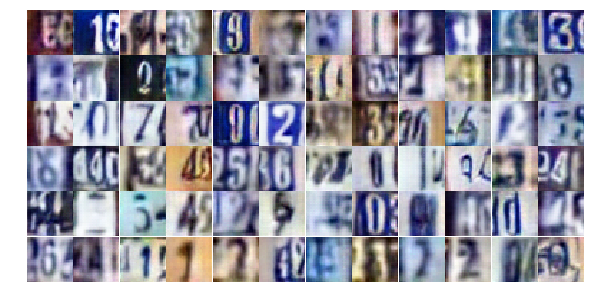

Epoch 22/25... Discriminator Loss: 0.9302... Generator Loss: 0.7831
Epoch 22/25... Discriminator Loss: 0.4202... Generator Loss: 1.6854
Epoch 22/25... Discriminator Loss: 0.4119... Generator Loss: 1.6745
Epoch 22/25... Discriminator Loss: 0.6081... Generator Loss: 1.1478
Epoch 22/25... Discriminator Loss: 0.8214... Generator Loss: 0.8213
Epoch 22/25... Discriminator Loss: 0.5116... Generator Loss: 1.2729
Epoch 22/25... Discriminator Loss: 0.7364... Generator Loss: 1.0277
Epoch 22/25... Discriminator Loss: 1.2318... Generator Loss: 0.4846
Epoch 22/25... Discriminator Loss: 1.1343... Generator Loss: 0.6052
Epoch 22/25... Discriminator Loss: 0.6808... Generator Loss: 1.1167


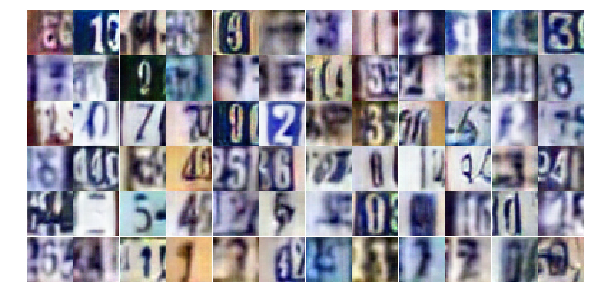

Epoch 22/25... Discriminator Loss: 1.3041... Generator Loss: 0.4633
Epoch 22/25... Discriminator Loss: 0.5697... Generator Loss: 1.2098
Epoch 22/25... Discriminator Loss: 0.6990... Generator Loss: 1.1720
Epoch 22/25... Discriminator Loss: 1.0088... Generator Loss: 0.7922
Epoch 22/25... Discriminator Loss: 0.5951... Generator Loss: 1.1387
Epoch 22/25... Discriminator Loss: 1.0070... Generator Loss: 2.6698
Epoch 22/25... Discriminator Loss: 0.8496... Generator Loss: 1.3897
Epoch 22/25... Discriminator Loss: 0.6466... Generator Loss: 1.1396
Epoch 22/25... Discriminator Loss: 0.6683... Generator Loss: 2.1044
Epoch 22/25... Discriminator Loss: 0.8545... Generator Loss: 0.9449


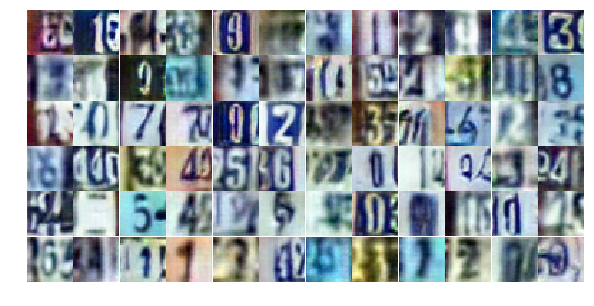

Epoch 23/25... Discriminator Loss: 0.5295... Generator Loss: 1.3558
Epoch 23/25... Discriminator Loss: 0.4715... Generator Loss: 1.4353
Epoch 23/25... Discriminator Loss: 1.0918... Generator Loss: 0.6212
Epoch 23/25... Discriminator Loss: 0.6435... Generator Loss: 1.1455
Epoch 23/25... Discriminator Loss: 0.7205... Generator Loss: 1.0441
Epoch 23/25... Discriminator Loss: 1.2311... Generator Loss: 0.6012
Epoch 23/25... Discriminator Loss: 1.1091... Generator Loss: 0.6312
Epoch 23/25... Discriminator Loss: 0.6662... Generator Loss: 1.0375
Epoch 23/25... Discriminator Loss: 0.6965... Generator Loss: 1.0724
Epoch 23/25... Discriminator Loss: 0.3310... Generator Loss: 2.2592


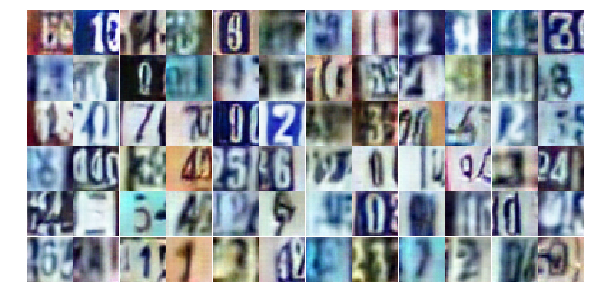

Epoch 23/25... Discriminator Loss: 0.5818... Generator Loss: 1.1202
Epoch 23/25... Discriminator Loss: 0.6044... Generator Loss: 1.1236
Epoch 23/25... Discriminator Loss: 0.8155... Generator Loss: 0.9220
Epoch 23/25... Discriminator Loss: 0.9091... Generator Loss: 0.7111
Epoch 23/25... Discriminator Loss: 0.4325... Generator Loss: 1.6030
Epoch 23/25... Discriminator Loss: 0.6830... Generator Loss: 1.1257
Epoch 23/25... Discriminator Loss: 1.0308... Generator Loss: 0.6441
Epoch 23/25... Discriminator Loss: 0.9275... Generator Loss: 2.9719
Epoch 23/25... Discriminator Loss: 0.8089... Generator Loss: 2.2091
Epoch 23/25... Discriminator Loss: 0.7191... Generator Loss: 1.1164


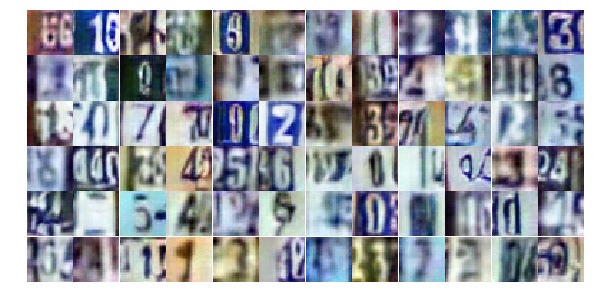

Epoch 23/25... Discriminator Loss: 1.3092... Generator Loss: 0.5768
Epoch 23/25... Discriminator Loss: 0.6476... Generator Loss: 1.1458
Epoch 23/25... Discriminator Loss: 0.8646... Generator Loss: 0.7685
Epoch 23/25... Discriminator Loss: 0.8707... Generator Loss: 0.8555
Epoch 23/25... Discriminator Loss: 0.6001... Generator Loss: 1.2306
Epoch 23/25... Discriminator Loss: 1.2946... Generator Loss: 3.7527
Epoch 23/25... Discriminator Loss: 0.7842... Generator Loss: 0.8875
Epoch 23/25... Discriminator Loss: 0.5518... Generator Loss: 1.2502
Epoch 23/25... Discriminator Loss: 0.9162... Generator Loss: 0.8931
Epoch 23/25... Discriminator Loss: 1.0047... Generator Loss: 0.8933


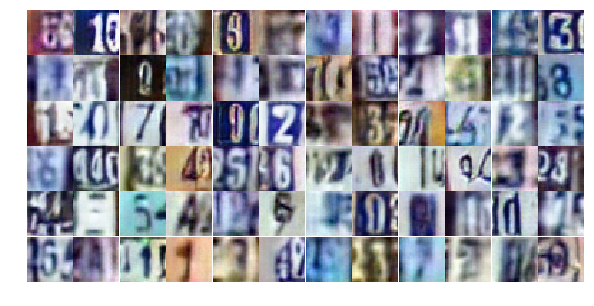

Epoch 23/25... Discriminator Loss: 0.5512... Generator Loss: 1.2010
Epoch 23/25... Discriminator Loss: 0.5738... Generator Loss: 1.2906
Epoch 23/25... Discriminator Loss: 1.2410... Generator Loss: 0.5133
Epoch 23/25... Discriminator Loss: 1.2678... Generator Loss: 0.5009
Epoch 23/25... Discriminator Loss: 1.0288... Generator Loss: 0.6936
Epoch 23/25... Discriminator Loss: 1.0717... Generator Loss: 0.6477
Epoch 23/25... Discriminator Loss: 1.3184... Generator Loss: 0.4841
Epoch 23/25... Discriminator Loss: 0.8822... Generator Loss: 0.7931
Epoch 23/25... Discriminator Loss: 0.5293... Generator Loss: 1.4114
Epoch 23/25... Discriminator Loss: 0.5283... Generator Loss: 1.4644


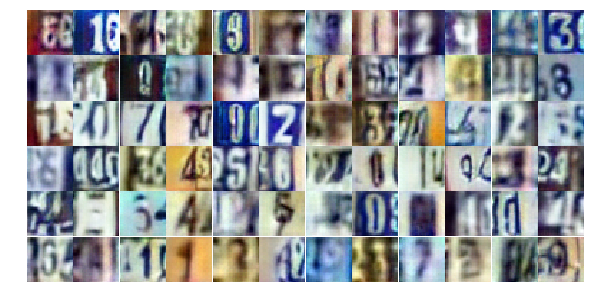

Epoch 23/25... Discriminator Loss: 0.7508... Generator Loss: 1.1806
Epoch 23/25... Discriminator Loss: 0.7223... Generator Loss: 0.9448
Epoch 23/25... Discriminator Loss: 1.0980... Generator Loss: 0.6050
Epoch 23/25... Discriminator Loss: 0.7617... Generator Loss: 0.9291
Epoch 23/25... Discriminator Loss: 0.9460... Generator Loss: 0.8036
Epoch 23/25... Discriminator Loss: 0.9344... Generator Loss: 0.8163
Epoch 23/25... Discriminator Loss: 0.4312... Generator Loss: 1.6286
Epoch 23/25... Discriminator Loss: 1.4800... Generator Loss: 0.4534
Epoch 23/25... Discriminator Loss: 0.7046... Generator Loss: 1.0107
Epoch 23/25... Discriminator Loss: 0.6863... Generator Loss: 1.0781


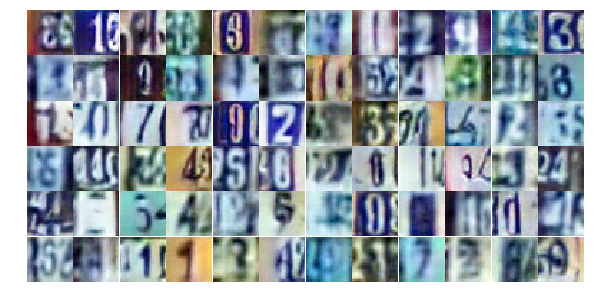

Epoch 23/25... Discriminator Loss: 0.5384... Generator Loss: 1.3232
Epoch 23/25... Discriminator Loss: 1.2824... Generator Loss: 0.4533
Epoch 23/25... Discriminator Loss: 0.7683... Generator Loss: 0.9953
Epoch 23/25... Discriminator Loss: 0.3213... Generator Loss: 2.0305
Epoch 23/25... Discriminator Loss: 1.3567... Generator Loss: 0.4901
Epoch 23/25... Discriminator Loss: 0.5847... Generator Loss: 1.5391
Epoch 23/25... Discriminator Loss: 1.0326... Generator Loss: 0.6331
Epoch 24/25... Discriminator Loss: 0.8164... Generator Loss: 0.7854
Epoch 24/25... Discriminator Loss: 0.8879... Generator Loss: 0.8199
Epoch 24/25... Discriminator Loss: 1.2387... Generator Loss: 0.5188


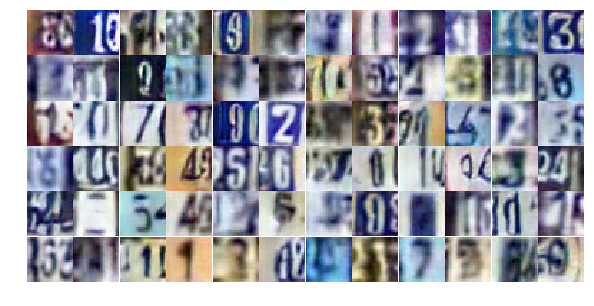

Epoch 24/25... Discriminator Loss: 0.7964... Generator Loss: 0.8560
Epoch 24/25... Discriminator Loss: 0.7230... Generator Loss: 0.9865
Epoch 24/25... Discriminator Loss: 0.7748... Generator Loss: 0.9040
Epoch 24/25... Discriminator Loss: 0.6026... Generator Loss: 1.3060
Epoch 24/25... Discriminator Loss: 0.9510... Generator Loss: 2.5104
Epoch 24/25... Discriminator Loss: 1.7123... Generator Loss: 0.6938
Epoch 24/25... Discriminator Loss: 0.9063... Generator Loss: 0.9215
Epoch 24/25... Discriminator Loss: 0.9912... Generator Loss: 0.7782
Epoch 24/25... Discriminator Loss: 0.5364... Generator Loss: 1.2877
Epoch 24/25... Discriminator Loss: 0.5794... Generator Loss: 1.6204


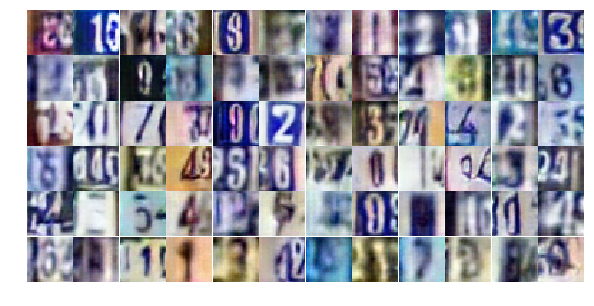

Epoch 24/25... Discriminator Loss: 1.1815... Generator Loss: 0.6015
Epoch 24/25... Discriminator Loss: 1.0118... Generator Loss: 0.7535
Epoch 24/25... Discriminator Loss: 0.9631... Generator Loss: 0.6777
Epoch 24/25... Discriminator Loss: 0.8099... Generator Loss: 0.8428
Epoch 24/25... Discriminator Loss: 0.5678... Generator Loss: 2.4477
Epoch 24/25... Discriminator Loss: 1.2089... Generator Loss: 0.5631
Epoch 24/25... Discriminator Loss: 0.6353... Generator Loss: 1.2569
Epoch 24/25... Discriminator Loss: 0.9130... Generator Loss: 0.8028
Epoch 24/25... Discriminator Loss: 0.8800... Generator Loss: 0.7985
Epoch 24/25... Discriminator Loss: 0.7776... Generator Loss: 0.8853


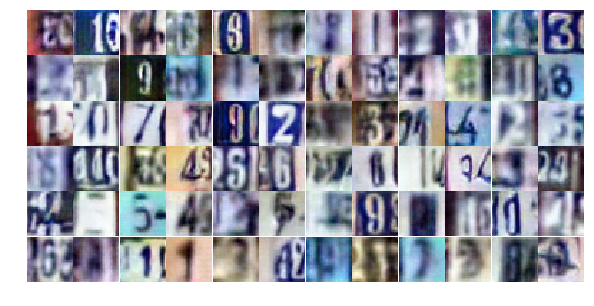

Epoch 24/25... Discriminator Loss: 0.7815... Generator Loss: 0.9577
Epoch 24/25... Discriminator Loss: 0.4130... Generator Loss: 1.5976
Epoch 24/25... Discriminator Loss: 0.6835... Generator Loss: 0.9306
Epoch 24/25... Discriminator Loss: 1.4349... Generator Loss: 0.4196
Epoch 24/25... Discriminator Loss: 0.5473... Generator Loss: 1.2087
Epoch 24/25... Discriminator Loss: 0.6017... Generator Loss: 1.1782
Epoch 24/25... Discriminator Loss: 0.3977... Generator Loss: 1.6203
Epoch 24/25... Discriminator Loss: 0.6100... Generator Loss: 1.1212
Epoch 24/25... Discriminator Loss: 0.7268... Generator Loss: 1.0343
Epoch 24/25... Discriminator Loss: 0.9442... Generator Loss: 0.7877


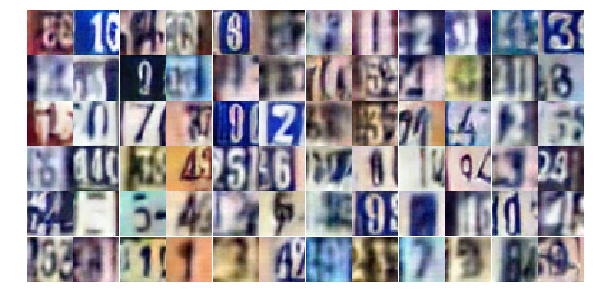

Epoch 24/25... Discriminator Loss: 0.4679... Generator Loss: 1.3865
Epoch 24/25... Discriminator Loss: 0.4799... Generator Loss: 1.4156
Epoch 24/25... Discriminator Loss: 0.8981... Generator Loss: 0.7871
Epoch 24/25... Discriminator Loss: 1.3030... Generator Loss: 0.4936
Epoch 24/25... Discriminator Loss: 1.0390... Generator Loss: 0.6929
Epoch 24/25... Discriminator Loss: 1.0679... Generator Loss: 0.6531
Epoch 24/25... Discriminator Loss: 0.9562... Generator Loss: 0.7657
Epoch 24/25... Discriminator Loss: 0.8365... Generator Loss: 0.8259
Epoch 24/25... Discriminator Loss: 1.3372... Generator Loss: 2.3203
Epoch 24/25... Discriminator Loss: 0.7139... Generator Loss: 2.6269


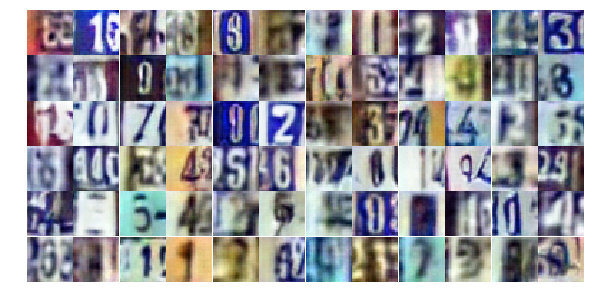

Epoch 24/25... Discriminator Loss: 0.7234... Generator Loss: 0.9921
Epoch 24/25... Discriminator Loss: 1.1958... Generator Loss: 0.5610
Epoch 24/25... Discriminator Loss: 1.5670... Generator Loss: 0.3229
Epoch 24/25... Discriminator Loss: 0.7924... Generator Loss: 0.9774
Epoch 24/25... Discriminator Loss: 1.4374... Generator Loss: 0.4548
Epoch 24/25... Discriminator Loss: 0.6612... Generator Loss: 1.1051
Epoch 24/25... Discriminator Loss: 1.1869... Generator Loss: 0.5754
Epoch 24/25... Discriminator Loss: 0.7008... Generator Loss: 1.0956
Epoch 24/25... Discriminator Loss: 0.9117... Generator Loss: 0.7522
Epoch 24/25... Discriminator Loss: 1.3574... Generator Loss: 0.3935


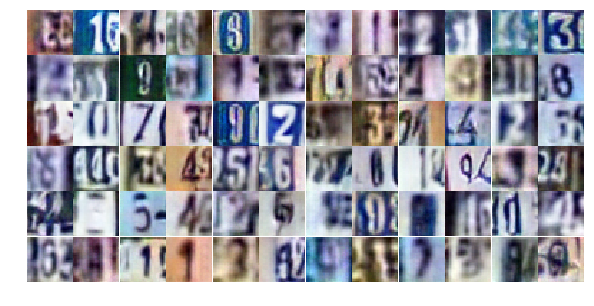

Epoch 24/25... Discriminator Loss: 1.2023... Generator Loss: 0.4890
Epoch 24/25... Discriminator Loss: 1.3774... Generator Loss: 0.4658
Epoch 24/25... Discriminator Loss: 1.5082... Generator Loss: 0.3851
Epoch 24/25... Discriminator Loss: 0.9652... Generator Loss: 0.7630
Epoch 24/25... Discriminator Loss: 1.1372... Generator Loss: 0.5796
Epoch 25/25... Discriminator Loss: 0.8875... Generator Loss: 0.8107
Epoch 25/25... Discriminator Loss: 0.5377... Generator Loss: 1.6494
Epoch 25/25... Discriminator Loss: 0.9241... Generator Loss: 0.7206
Epoch 25/25... Discriminator Loss: 0.9458... Generator Loss: 0.7439
Epoch 25/25... Discriminator Loss: 2.0885... Generator Loss: 0.1991


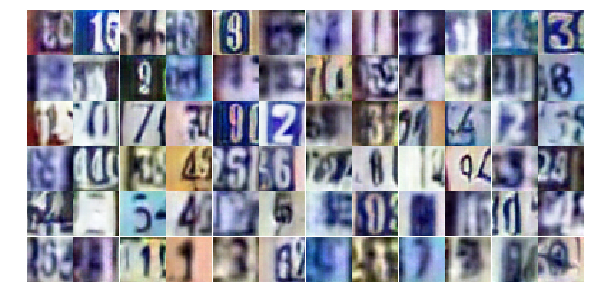

Epoch 25/25... Discriminator Loss: 1.1900... Generator Loss: 0.5435
Epoch 25/25... Discriminator Loss: 1.4812... Generator Loss: 0.4532
Epoch 25/25... Discriminator Loss: 0.8653... Generator Loss: 0.8447
Epoch 25/25... Discriminator Loss: 0.6330... Generator Loss: 1.3997
Epoch 25/25... Discriminator Loss: 0.9154... Generator Loss: 2.2774
Epoch 25/25... Discriminator Loss: 0.8653... Generator Loss: 0.7816
Epoch 25/25... Discriminator Loss: 0.5459... Generator Loss: 1.1980
Epoch 25/25... Discriminator Loss: 0.9910... Generator Loss: 0.7238
Epoch 25/25... Discriminator Loss: 0.4602... Generator Loss: 1.7004
Epoch 25/25... Discriminator Loss: 0.7562... Generator Loss: 0.9211


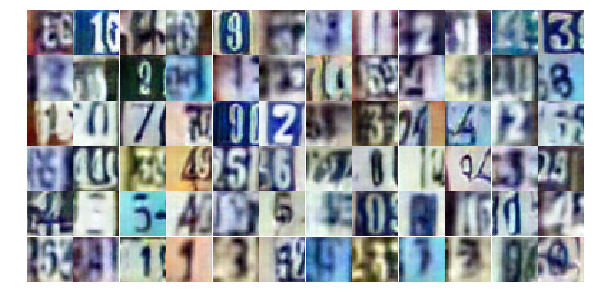

Epoch 25/25... Discriminator Loss: 1.2614... Generator Loss: 0.4933
Epoch 25/25... Discriminator Loss: 0.5719... Generator Loss: 3.0270
Epoch 25/25... Discriminator Loss: 1.4981... Generator Loss: 0.4293
Epoch 25/25... Discriminator Loss: 1.1187... Generator Loss: 0.5898
Epoch 25/25... Discriminator Loss: 0.9295... Generator Loss: 0.7304
Epoch 25/25... Discriminator Loss: 0.6291... Generator Loss: 1.0691
Epoch 25/25... Discriminator Loss: 0.6518... Generator Loss: 1.0604
Epoch 25/25... Discriminator Loss: 0.9728... Generator Loss: 1.0643
Epoch 25/25... Discriminator Loss: 0.4705... Generator Loss: 1.5524
Epoch 25/25... Discriminator Loss: 0.6706... Generator Loss: 1.0121


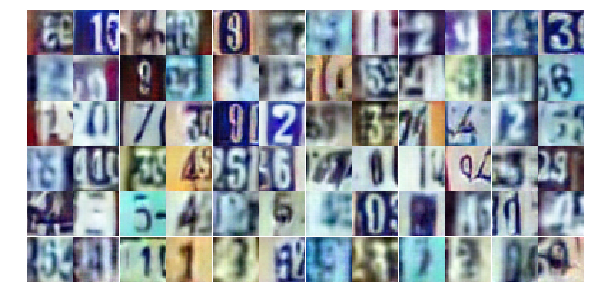

Epoch 25/25... Discriminator Loss: 1.4399... Generator Loss: 0.4055
Epoch 25/25... Discriminator Loss: 0.7017... Generator Loss: 1.0099
Epoch 25/25... Discriminator Loss: 1.2647... Generator Loss: 0.5640
Epoch 25/25... Discriminator Loss: 0.7156... Generator Loss: 1.0986
Epoch 25/25... Discriminator Loss: 0.8950... Generator Loss: 0.8027
Epoch 25/25... Discriminator Loss: 0.4216... Generator Loss: 1.5304
Epoch 25/25... Discriminator Loss: 0.6142... Generator Loss: 1.5312
Epoch 25/25... Discriminator Loss: 0.6296... Generator Loss: 1.1047
Epoch 25/25... Discriminator Loss: 1.1029... Generator Loss: 0.5808
Epoch 25/25... Discriminator Loss: 0.4190... Generator Loss: 1.5656


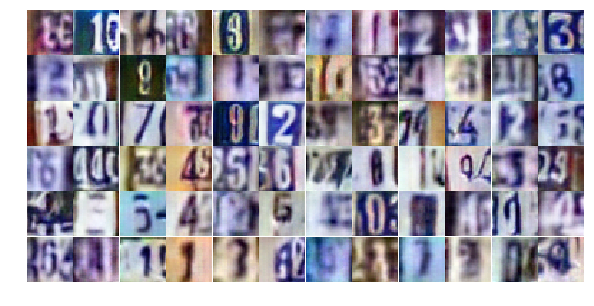

Epoch 25/25... Discriminator Loss: 0.7913... Generator Loss: 0.9544
Epoch 25/25... Discriminator Loss: 0.5754... Generator Loss: 1.2218
Epoch 25/25... Discriminator Loss: 0.5425... Generator Loss: 1.7952
Epoch 25/25... Discriminator Loss: 0.9584... Generator Loss: 0.7540
Epoch 25/25... Discriminator Loss: 1.1100... Generator Loss: 0.6155
Epoch 25/25... Discriminator Loss: 1.3656... Generator Loss: 0.4310
Epoch 25/25... Discriminator Loss: 0.4692... Generator Loss: 1.4305
Epoch 25/25... Discriminator Loss: 0.6056... Generator Loss: 1.1971
Epoch 25/25... Discriminator Loss: 2.0927... Generator Loss: 0.2648
Epoch 25/25... Discriminator Loss: 1.7638... Generator Loss: 4.3538


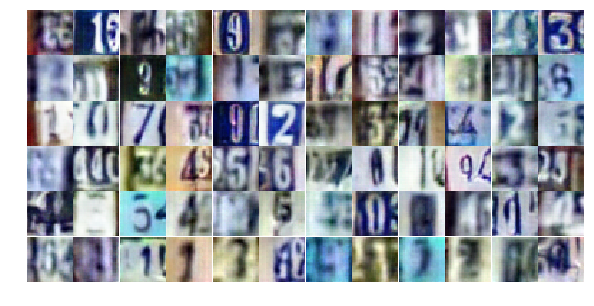

Epoch 25/25... Discriminator Loss: 1.8552... Generator Loss: 1.6373
Epoch 25/25... Discriminator Loss: 1.8940... Generator Loss: 0.3571
Epoch 25/25... Discriminator Loss: 1.5268... Generator Loss: 3.1569
Epoch 25/25... Discriminator Loss: 1.3265... Generator Loss: 0.4884
Epoch 25/25... Discriminator Loss: 1.2846... Generator Loss: 0.5210
Epoch 25/25... Discriminator Loss: 0.6017... Generator Loss: 1.2246
Epoch 25/25... Discriminator Loss: 1.3622... Generator Loss: 0.4535
Epoch 25/25... Discriminator Loss: 0.6486... Generator Loss: 1.4492
Epoch 25/25... Discriminator Loss: 0.8127... Generator Loss: 1.0399
Epoch 25/25... Discriminator Loss: 0.7857... Generator Loss: 1.0580


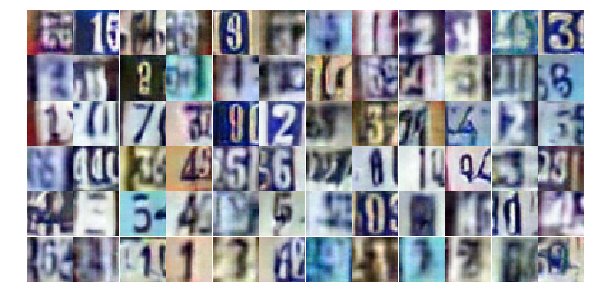

Epoch 25/25... Discriminator Loss: 0.5297... Generator Loss: 1.8325
Epoch 25/25... Discriminator Loss: 1.5390... Generator Loss: 0.3589


In [17]:
dataset = Dataset(trainset, testset)

losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

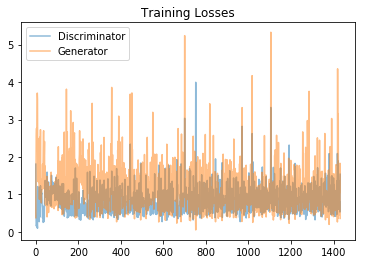

In [18]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

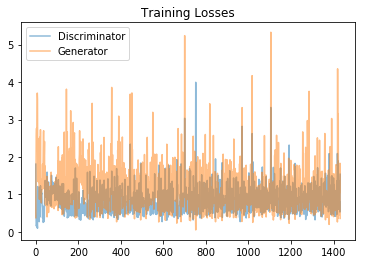

In [19]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

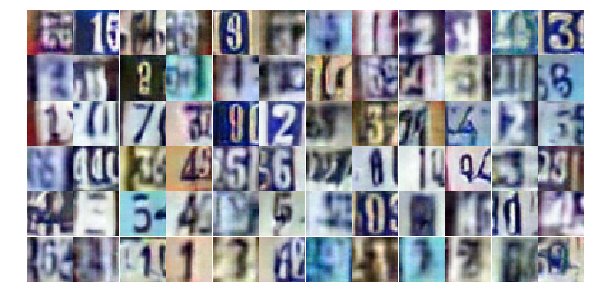

In [20]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))

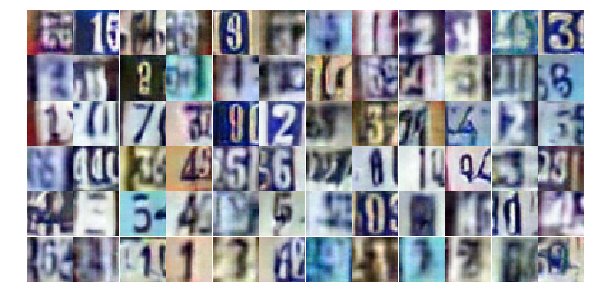

In [21]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))